# set up lab workstation

> (base) bizon@dl:\~\$ conda activate max<sub>cytosimanalysis</sub>
> (max<sub>cytosimanalysis</sub>) bizon@dl:\~\$ nohup jupyter kernel &

copy connection file path over to session header argument

# treat python blocks as jupyter

``` jupyter
print('test')
```

``` jupyter-python
print('test')
```

``` commonlisp
(org-babel-jupyter-override-src-block "python")
```

``` python
print('test')
```

# load libraries and set global variables

``` python
#timestep = 5e-5
report = 'no'
replace_movies = 'no'
save_figures = 'yes'
save_dataframes = 'yes'

machine = 'peeks'

if machine == 'ltpbukem':
    drive_dir = '/home/maxferrin/remote_drive/'

if machine == 'bizon':
    drive_dir = '/media/bizon/DATA/MFerrin/insync/'

if machine == 'peeks':
    drive_dir = '/scratch/ferrin/unison_peeks/'

if machine == 'drumroom':
    drive_dir = '/Users/max/google_drive/'

if machine == 'mbp':
    drive_dir = '/Users/maxferrin/google_drive/'

if machine == 'sobarky':
    drive_dir = '/Users/dblab/google_drive/'

import IPython
from tabulate import tabulate
import math
import numpy as np
import pandas as pd
import os
import shutil
import subprocess
from subprocess import Popen
import datetime
import matplotlib.pyplot as plt  # plotting
import seaborn as sns  # nicer plotting
from decimal import Decimal
import matplotlib.colors as colors
import matplotlib
from matplotlib.colors import LogNorm
from matplotlib.colors import SymLogNorm
from scipy.stats import binned_statistic_2d
from scipy import stats

import matplotlib.pyplot as plt  # plotting
plt.style.use('seaborn-v0_8-colorblind') # set plot style
plt.cool()                          # heatmap color scheme
import matplotlib.colors as mcolors
matplotlib.rcParams['axes.prop_cycle'] = matplotlib.cycler(color=mcolors.TABLEAU_COLORS)
%matplotlib inline

import seaborn as sns  # nicer plotting
sns.set_style('whitegrid')  # set plot style

SMALL_SIZE = 12
MEDIUM_SIZE = 16
BIGGER_SIZE = 18

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=MEDIUM_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

from decimal import Decimal

from matplotlib.colors import LogNorm
from matplotlib.colors import SymLogNorm
from scipy.stats import binned_statistic_2d

working_dir = os.path.join(drive_dir, 'grad_school/db_lab/code/analysis/20230708_6.12_finalmyosims/')
cytosim_dir = os.path.join(drive_dir, 'grad_school/db_lab/code/cytosim_dblab/', machine)

if machine == 'peeks':
    working_dir = '/run/media/ferrin/Volume/max/analysis/20230708_6.12_finalmyosims/'
    cytosim_dir = '/home/ferrin/cytosim/'

os.chdir(working_dir)

import sys
# add parent folder to path
sys.path.insert(1, '../')
from cytosim_analysis import cytosim_analysis_functions as caf

# reload custom library
from importlib import reload
reload(sys.modules['cytosim_analysis'])

if os.path.isdir('figures') == False:
    os.mkdir('figures')
if os.path.isdir('dataframes') == False:
    os.mkdir('dataframes')

dataframes_dir =  os.path.join(working_dir,'dataframes/')

now = datetime.datetime.now()
date = now.strftime('%Y%m%d')
pref = date


import IPython
from tabulate import tabulate

class OrgFormatter(IPython.core.formatters.BaseFormatter):
    def __call__(self, obj):
        try:
            return tabulate(obj, headers='keys',
                            tablefmt='orgtbl', showindex='always')
        except:
            return None

ip = get_ipython()
ip.display_formatter.formatters['text/org'] = OrgFormatter()
```

``` example
<Figure size 640x480 with 0 Axes>
```

# convert between unbinding force and distance parameter

from Bell equation (eq. 4 from \[@pedersen_endocytic_2023\])

``` python
#caf.ufpN_to_dnm(-3.67)
caf.ufpN_to_dnm(0)
```

# load in previously parsed dataframes

``` python
rundirs_allparams_df = pd.read_pickle(dataframes_dir+'rundirs_allparams.pkl')
rundirs_allparams_df.fillna(value='empty', inplace=True)
properties_allparams = pd.read_pickle(dataframes_dir+'properties_allparams.pkl')
properties_unique = pd.read_pickle(dataframes_dir+'properties_unique.pkl')
property_groups = list(properties_unique)
config_allparams = pd.read_pickle(dataframes_dir+'config_allparams.pkl')
config_unique = pd.read_pickle(dataframes_dir+'config_unique.pkl')
config_groups = list(config_unique)
solid_allparams = pd.read_pickle(dataframes_dir+'solid_allparams.pkl')
hip1r_allparams = pd.read_pickle(dataframes_dir+'hip1r_allparams.pkl')
clusters_allparams = pd.read_pickle(dataframes_dir+'clusters_allparams.pkl')
ends_allparams = pd.read_pickle(dataframes_dir+'ends_allparams.pkl')
hip1r_clusters_ends_allparams = pd.read_pickle(dataframes_dir+'hip1r_clusters_ends_allparams.pkl')
fiber_ends_summary_allparams = pd.read_pickle(dataframes_dir+'fiber_ends_summary_allparams.pkl')
summaries = pd.read_pickle(dataframes_dir+'summaries.pkl')
grouped_summaries = pd.read_pickle(dataframes_dir+'grouped_summaries.pkl')
motile_grouped_summaries = pd.read_pickle(dataframes_dir+'motile_grouped_summaries.pkl')
immotile_grouped_summaries = pd.read_pickle(dataframes_dir+'immotile_grouped_summaries.pkl')
nomyo_grouped_summaries = pd.read_pickle(dataframes_dir+'nomyo_grouped_summaries.pkl')
final_bound_hip1r_allparams = pd.read_pickle(dataframes_dir+'final_bound_hip1r_allparams.pkl')
hip1r_bound_ends_attachment = pd.read_pickle(dataframes_dir+'hip1r_bound_ends_attachment.pkl')
branched_actin_bound_ends_bending=pd.read_pickle(dataframes_dir+'branched_actin_bound_ends_bending.pkl')
membrane_myosin_allparams = pd.read_pickle(dataframes_dir+'membrane_myosin_allparams.pkl')
# forces_allparams = pd.read_pickle(dataframes_dir+'forces_allparams.pkl')
# means = pd.read_pickle(dataframes_dir+'means.pkl')
# stds = pd.read_pickle(dataframes_dir+'stds.pkl')
# sweep_means = pd.read_pickle(dataframes_dir+'sweep_means.pkl')
# sweep_stds = pd.read_pickle(dataframes_dir+'sweep_stds.pkl')
# all_ends_allparams = pd.read_pickle(dataframes_dir+'all_ends_allparams.pkl')
# growing_ends_summary_allparams = pd.read_pickle(dataframes_dir+'growing_ends_summary_allparams.pkl')
# hip1r_growing_ends_summary_allparams = pd.read_pickle(dataframes_dir+'hip1r_growing_ends_summary_allparams.pkl')
```

``` python
total_runs = len(solid_allparams.groupby(['param_sweep','run']).count())
solid_allparams.head()
```

# find directories that have outputs or config files

``` python
output_dirs, config_dirs = caf.find_directories()
print(output_dirs, config_dirs)
```

``` example
['6.12.0_output', '6.12a.1_output', '6.12a.2_output', '6.12a.3_output', '6.12a.4_output', '6.12a.6_output', '6.12a.8_output', '6.12b.10_output', '6.12b.11_output', '6.12b.12_output', '6.12b.1_output', '6.12b.2_output', '6.12b.3_output', '6.12b.4_output', '6.12b.5_output', '6.12b.6_output', '6.12b.7_output', '6.12b.8_output', '6.12b.9_output', '6.12c.12_output', '6.12c.1_output', '6.12c.2_output', '6.12c.3_output', '6.12c.4_output', '6.13.1_output', '6.13.2_output', '6.13.3_output'] ['6.12', '6.12.0', '6.12a.1', '6.12a.10', '6.12a.11', '6.12a.12', '6.12a.2', '6.12a.3', '6.12a.4', '6.12a.5', '6.12a.6', '6.12a.7', '6.12a.8', '6.12a.9', '6.12b.1', '6.12b.10', '6.12b.11', '6.12b.12', '6.12b.2', '6.12b.3', '6.12b.4', '6.12b.5', '6.12b.6', '6.12b.7', '6.12b.8', '6.12b.9', '6.12c.1', '6.12c.10', '6.12c.11', '6.12c.12', '6.12c.2', '6.12c.3', '6.12c.4', '6.12c.5', '6.12c.6', '6.12c.7', '6.12c.8', '6.12c.9', '6.13.1', '6.13.2', '6.13.3']
```

# manually narrow

``` python
output_dirs = [d for d in output_dirs if '6.12c.12' not in d]
config_dirs = [d for d in config_dirs if '6.12c.12' not in d]
print(output_dirs, config_dirs)
```

# report simulations

``` python
caf.report_sims(working_dir, output_dirs, cytosim_dir, report)
```

# read in reports

-   not enough memory to do all at once!
-   just fiber forces alone requires too much memory

``` python
reports = [
    #'solid'#,
    # 'single_hip1r',
    # 'single_membrane_myosin',
    # 'fiber_cluster',
    # 'fiber_forces',
    # 'fiber_tensions',
    # 'fiber_ends'
    ]

#reports = ['solid']
#reports = ['fiber_ends']

solid_allruns_allparams, properties_allruns_allparams, \
configs_allruns_allparams, single_hip1r_allruns_allparams, \
single_membrane_myosin_allruns_allparams, fiber_forces_allruns_allparams, \
fiber_clusters_allruns_allparams, fiber_tensions_allruns_allparams, \
fiber_ends_allruns_allparams, rundirs_allparams, total_runs = \
caf.open_reports(reports, working_dir, output_dirs, config_dirs,
cytosim_dir, replace_movies)

if save_dataframes == 'yes':
    pd.DataFrame.from_dict(rundirs_allparams, orient = 'index').to_pickle(dataframes_dir+'rundirs_allparams.pkl')
```

``` example
finished reporting 6.12.0_output
finished reporting 6.12a.1_output
finished reporting 6.12a.2_output
finished reporting 6.12a.3_output
finished reporting 6.12a.4_output
finished reporting 6.12a.6_output
finished reporting 6.12a.8_output
finished reporting 6.12b.10_output
```

``` example
[0;31m---------------------------------------------------------------------------[0m
[0;31mFileNotFoundError[0m                         Traceback (most recent call last)
Cell [0;32mIn[53], line 19[0m
[1;32m      1[0m reports [38;5;241m=[39m [
[1;32m      2[0m     [38;5;124m'[39m[38;5;124msolid[39m[38;5;124m'[39m[38;5;66;03m#,[39;00m
[1;32m      3[0m     [38;5;66;03m# 'single_hip1r',[39;00m
[0;32m   (...)[0m
[1;32m      8[0m     [38;5;66;03m# 'fiber_ends'[39;00m
[1;32m      9[0m     ]
[1;32m     11[0m [38;5;66;03m#reports = ['solid'][39;00m
[1;32m     12[0m [38;5;66;03m#reports = ['fiber_ends'][39;00m
[1;32m     14[0m solid_allruns_allparams, properties_allruns_allparams, \
[1;32m     15[0m configs_allruns_allparams, single_hip1r_allruns_allparams, \
[1;32m     16[0m single_membrane_myosin_allruns_allparams, fiber_forces_allruns_allparams, \
[1;32m     17[0m fiber_clusters_allruns_allparams, fiber_tensions_allruns_allparams, \
[1;32m     18[0m fiber_ends_allruns_allparams, rundirs_allparams, total_runs [38;5;241m=[39m \
[0;32m---> 19[0m [43mcaf[49m[38;5;241;43m.[39;49m[43mopen_reports[49m[43m([49m[43mreports[49m[43m,[49m[43m [49m[43mworking_dir[49m[43m,[49m[43m [49m[43moutput_dirs[49m[43m,[49m[43m [49m[43mconfig_dirs[49m[43m,[49m
[1;32m     20[0m [43mcytosim_dir[49m[43m,[49m[43m [49m[43mreplace_movies[49m[43m)[49m
[1;32m     22[0m [38;5;28;01mif[39;00m save_dataframes [38;5;241m==[39m [38;5;124m'[39m[38;5;124myes[39m[38;5;124m'[39m:
[1;32m     23[0m     pd[38;5;241m.[39mDataFrame[38;5;241m.[39mfrom_dict(rundirs_allparams, orient [38;5;241m=[39m [38;5;124m'[39m[38;5;124mindex[39m[38;5;124m'[39m)[38;5;241m.[39mto_pickle(dataframes_dir[38;5;241m+[39m[38;5;124m'[39m[38;5;124mrundirs_allparams.pkl[39m[38;5;124m'[39m)

File [0;32m/scratch/ferrin/unison_peeks/grad_school/db_lab/code/analysis/20231218_6.13_nopowerstroke/../cytosim_analysis/cytosim_analysis_functions.py:182[0m, in [0;36mopen_reports[0;34m(reports, working_dir, output_dirs, config_dirs, cytosim_dir, replace_movies)[0m
[1;32m    180[0m properties[38;5;241m.[39mclose()
[1;32m    181[0m [38;5;28;01mif[39;00m [38;5;124m'[39m[38;5;124msolid[39m[38;5;124m'[39m [38;5;129;01min[39;00m reports:
[0;32m--> 182[0m     solid [38;5;241m=[39m [38;5;28;43mopen[39;49m[43m([49m[38;5;124;43m'[39;49m[38;5;124;43msolid.txt[39;49m[38;5;124;43m'[39;49m[43m,[49m[43m [49m[38;5;124;43m'[39;49m[38;5;124;43mr[39;49m[38;5;124;43m'[39;49m[43m)[49m
[1;32m    183[0m     solid_allruns[rundir] [38;5;241m=[39m solid[38;5;241m.[39mreadlines()
[1;32m    184[0m     solid[38;5;241m.[39mclose()

[0;31mFileNotFoundError[0m: [Errno 2] No such file or directory: 'solid.txt'
```

# read simulation properties

## put all properties and configs into dataframes

``` python
properties_allparams, config_allparams = caf.props_configs(
    output_dirs, rundirs_allparams,
    properties_allruns_allparams, configs_allruns_allparams)
```

## filter for properties that vary among simulations

``` python
cols = list(properties_allparams)
nunique = properties_allparams.apply(pd.Series.nunique)
cols_to_drop = nunique[nunique == 1].index
properties_unique = properties_allparams.drop(cols_to_drop, axis=1)
properties_unique = properties_unique.drop(labels='internalize_random_seed',axis=1)
properties_unique.head()
```

|                                                       | myosin<sub>unbinding</sub> | bud<sub>confine</sub> |
|-------------------------------------------------------|:---------------------------|:----------------------|
| ('6.12.0<sub>output</sub>', 'run0000<sub>0000</sub>') | 100000, 0                  | 2                     |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0001</sub>') | 100000, 0                  | 2                     |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0002</sub>') | 100000, 0                  | 2                     |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0003</sub>') | 100000, 0                  | 2                     |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0004</sub>') | 100000, 0                  | 2                     |

``` python
cols = list(config_allparams)
nunique = config_allparams.apply(pd.Series.nunique)
cols_to_drop = nunique[nunique == 1].index
config_unique = config_allparams.drop(cols_to_drop, axis=1)
#config_unique = config_unique.drop(['membrane_myosin_position'], axis=1)
config_unique = config_unique.astype('float')
if save_figures == 'yes':
    config_allparams.to_pickle(dataframes_dir+'config_allparams.pkl')
    config_unique.to_pickle(dataframes_dir+'config_unique.pkl')
config_unique.head()
```

|                                                       | myosin<sub>unbindingrate</sub> | myosin<sub>unbindingforce</sub> | myosin<sub>maxspeed</sub> | bud<sub>confine</sub> | membrane<sub>myosinnumber</sub> |
|-------------------------------------------------------|:-------------------------------|:--------------------------------|:--------------------------|:----------------------|:--------------------------------|
| ('6.12.0<sub>output</sub>', 'run0000<sub>0000</sub>') | 100000                         | 0                               | 100                       | 2                     | 0                               |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0001</sub>') | 100000                         | 0                               | 100                       | 2                     | 0                               |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0002</sub>') | 100000                         | 0                               | 100                       | 2                     | 0                               |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0003</sub>') | 100000                         | 0                               | 100                       | 2                     | 0                               |
| ('6.12.0<sub>output</sub>', 'run0000<sub>0004</sub>') | 100000                         | 0                               | 100                       | 2                     | 0                               |

# parse results into dataframe

## solid positions

``` python
solid_allparams = caf.solid_positions(output_dirs, rundirs_allparams_df, solid_allruns_allparams)
if save_dataframes == 'yes':
    solid_allparams.to_pickle(dataframes_dir+'solid_allparams.pkl')

solid_allparams.head()
```

``` example
finished parsing 6.13.1_output
finished parsing 6.13.2_output
finished parsing 6.13.3_output
```

|                                                               | xpos         | ypos         | zpos      | internalization |
|---------------------------------------------------------------|:-------------|:-------------|:----------|:----------------|
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.1, 1) | -0.000402351 | -6.48665e-05 | -0.397983 | 0.002017        |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.2, 1) | -2.58839e-05 | 0.000778713  | -0.390994 | 0.009006        |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.3, 1) | 7.15742e-05  | 0.00127072   | -0.385322 | 0.014678        |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.4, 1) | -0.000401112 | 0.00129246   | -0.384248 | 0.015752        |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.5, 1) | 0.00115491   | 0.00414835   | -0.383427 | 0.016573        |

## all hip1r

``` python
hip1r_allparams = caf.all_hip1r(output_dirs, rundirs_allparams_df, single_hip1r_allruns_allparams)

hip1r_allparams['xpos_rel'] = hip1r_allparams['xpos']-solid_allparams.reset_index(level='id', drop=True)['xpos']
hip1r_allparams['ypos_rel'] = hip1r_allparams['ypos']-solid_allparams.reset_index(level='id', drop=True)['ypos']
hip1r_allparams['rpos_rel'] = np.sqrt(np.square(hip1r_allparams['xpos_rel'])+
                                      np.square(hip1r_allparams['ypos_rel']))

if save_dataframes == 'yes':
    hip1r_allparams.to_pickle(dataframes_dir+'hip1r_allparams.pkl')

hip1r_allparams.head()
```

## all myosin

``` python
membrane_myosin_allparams = caf.all_myosin(output_dirs, rundirs_allparams_df, single_membrane_myosin_allruns_allparams, solid_allparams)

if save_dataframes == 'yes':
    membrane_myosin_allparams.to_pickle(dataframes_dir+'membrane_myosin_allparams.pkl')

membrane_myosin_allparams.head()
```

``` example
finished parsing 6.13.1_output
finished parsing 6.13.2_output
finished parsing 6.13.3_output
```

|                                                                 | state | fiber<sub>id</sub> | xpos       | single<sub>id</sub> | ypos       | zpos   | xforce | yforce | zforce | abscissa | xdirection | ydirection | zdirection | scalar<sub>force</sub> | rpos      |
|-----------------------------------------------------------------|:------|:-------------------|:-----------|:--------------------|:-----------|:-------|:-------|:-------|:-------|:---------|:-----------|:-----------|:-----------|:-----------------------|:----------|
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.1, 290) | 0     | 0                  | 0.0685477  | 290                 | 0.021765   | -0.392 | 0      | 0      | 0      | 0        | 0          | 0          | 0          | 0                      | 0.0719201 |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.1, 226) | 0     | 0                  | 0.0692761  | 226                 | 0.0921505  | -0.392 | 0      | 0      | 0      | 0        | 0          | 0          | 0          | 0                      | 0.115286  |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.1, 299) | 0     | 0                  | 0.0731485  | 299                 | -0.0933022 | -0.392 | 0      | 0      | 0      | 0        | 0          | 0          | 0          | 0                      | 0.118558  |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.1, 212) | 0     | 0                  | -0.0163096 | 212                 | 0.0850813  | -0.392 | 0      | 0      | 0      | 0        | 0          | 0          | 0          | 0                      | 0.0866304 |
| ('6.13.1<sub>output</sub>', 'run0000<sub>0000</sub>', 0.1, 220) | 0     | 0                  | -0.102607  | 220                 | 0.0263638  | -0.392 | 0      | 0      | 0      | 0        | 0          | 0          | 0          | 0                      | 0.10594   |

## fiber clusters

``` python
clusters_allparams = caf.get_fiber_clusters(output_dirs, rundirs_allparams_df, fiber_clusters_allruns_allparams)
if save_dataframes == 'yes':
    clusters_allparams.to_pickle(dataframes_dir+'clusters_allparams.pkl')

clusters_allparams.head()
```

## fiber forces

``` python
forces_allparams = caf.get_fiber_forces(output_dirs, rundirs_allparams_df, fiber_forces_allruns_allparams)
if save_dataframes == 'yes':
    forces_allparams.to_pickle(dataframes_dir+'forces_allparams.pkl')

forces_allparams.head()
```

## fiber ends

``` python
ends_allparams = caf.get_fiber_ends(output_dirs, rundirs_allparams_df, fiber_ends_allruns_allparams)

ends_allparams['minus_xpos_rel'] = ends_allparams['minus_xpos']-solid_allparams.reset_index(level='id', drop=True)['xpos']
ends_allparams['minus_ypos_rel'] = ends_allparams['minus_ypos']-solid_allparams.reset_index(level='id', drop=True)['ypos']
ends_allparams['minus_rpos_rel'] = np.sqrt(np.square(ends_allparams['minus_xpos_rel'])+
                                      np.square(ends_allparams['minus_ypos_rel']))

ends_allparams['plus_xpos_rel'] = ends_allparams['plus_xpos']-solid_allparams.reset_index(level='id', drop=True)['xpos']
ends_allparams['plus_ypos_rel'] = ends_allparams['plus_ypos']-solid_allparams.reset_index(level='id', drop=True)['ypos']
ends_allparams['plus_rpos_rel'] = np.sqrt(np.square(ends_allparams['plus_xpos_rel'])+
                                      np.square(ends_allparams['plus_ypos_rel']))

if save_dataframes == 'yes':
    ends_allparams.to_pickle(dataframes_dir+'ends_allparams.pkl')

ends_allparams.head()
```

### prototyping

``` python
ends_list = []
for output_dir in [output_dirs[0]]:
    rundirs = rundirs_allparams[output_dir]
    fiber_ends_outputs_allruns = []
    for rundir in [rundirs[0]]:
        single_all_lines = fiber_ends_allruns_allparams[output_dir][rundir]
        timepoints = []
        outputs = []
        for line in single_all_lines:
            line = line.strip()
            if line.startswith('%'):
                if line.startswith('% time'):
                    time = float(line.split(' ')[-1])
                    timepoints.append(time)
                    singles = {}
                elif line.startswith('% end'):
                    df = pd.DataFrame.from_dict(singles, orient = 'index')
                    outputs.append(df)
                    #print('finished parsing ' + rundir + ' timepoint ' + str(time))
            elif len(line.split()) > 0:
                [fiber_class, fiber_id, length, minus_state, minus_xpos, minus_ypos, minus_zpos,
                minus_xdir, minus_ydir, minus_zdir, plus_state, plus_xpos, plus_ypos,
                plus_zpos, plus_xdir, plus_ydir, plus_zdir] = line.split()
                singles[int(fiber_id)] = {'fiber_id' : int(fiber_id), 'length':float(length),
                                        'minus_state':int(minus_state), 'minus_xpos':float(minus_xpos),
                                        'minus_ypos':float(minus_ypos), 'minus_zpos':float(minus_zpos),
                                        'minus_xdir':float(minus_xdir), 'minus_ydir':float(minus_ydir),
                                        'minus_zdir':float(minus_zdir), 'plus_state':int(plus_state),
                                        'plus_xpos':float(plus_xpos), 'plus_ypos':float(plus_ypos),
                                        'plus_zpos':float(plus_zpos), 'plus_xdir':float(plus_xdir),
                                        'plus_ydir':float(plus_ydir), 'plus_zdir':float(plus_zdir),
                                        'growth':np.NaN}

        all_outputs = pd.concat(outputs, keys = timepoints,
                            names = ['time', 'id']).sort_index()
        if len(all_outputs) > 0:
            all_outputs['plus_rpos'] = np.sqrt(np.square(all_outputs['plus_xpos']) +
                                        np.square(all_outputs['plus_ypos']))

        lengths = dict()
        for i, timepoint in enumerate(timepoints):
            lengths[i] = all_outputs.loc[timepoint,'length']
            if i > 0:
                check = 'good'
                for fil in lengths[i-1].reset_index()['id']:
                    if fil not in np.array(lengths[i].reset_index()['id']):
                        check = 'bad'
                if check == 'good':
                    growth = lengths[i] - lengths[i-1]
                    for fil in lengths[i].reset_index()['id']:
                        if fil not in np.array(lengths[i-1].reset_index()['id']):
                            growth.loc[fil] = lengths[i].loc[fil]
                    all_outputs.loc[timepoint,'growth'] = np.array(growth)
            else:
                all_outputs.loc[timepoint,'growth'] = np.array(lengths[i])

        fiber_ends_outputs_allruns.append(all_outputs)


    all_fiber_ends = pd.concat(fiber_ends_outputs_allruns, keys = rundirs,
                                names = ['run', 'time', 'id'])
    ends_list.append(all_fiber_ends)
    print('finished parsing ' + output_dir)
ends_allparams = pd.concat(ends_list, keys = output_dirs,
        names = ['param_sweep', 'run', 'time', 'id'])
```

``` python
all_outputs.loc[all_outputs['fiber_id']==109][['length','growth','plus_state']].head()
```

## merge positions with run properties/configs

### solid

``` python
solid_properties = pd.merge(properties_unique.reset_index(), solid_allparams.reset_index(),
                            on=['param_sweep', 'run'], how='outer').set_index(['param_sweep', 'run'])
property_groups = list(properties_unique)
solid_property_groups = solid_properties.groupby(property_groups)
groups = property_groups + ['time']
grouped = solid_properties.groupby(groups)
means = grouped['internalization'].mean()
stds = grouped['internalization'].std()
```

``` python
solid_config = pd.merge(config_unique.reset_index(), solid_allparams.reset_index(),
                        on=['param_sweep', 'run'], how='outer').set_index(['param_sweep', 'run'])
config_groups = list(config_unique)
solid_config_groups = solid_config.groupby(config_groups)
groups = config_groups + ['time']
grouped = solid_config.groupby(groups)
means = grouped['internalization'].mean()
stds = grouped['internalization'].std(ddof=1)
ns = grouped['internalization'].count()
t_statistic = stats.t.ppf(0.975, df=ns-1)  # For a 95% confidence interval (two-tailed), use alpha = 0.025
ci95s = t_statistic * (stds / np.sqrt(ns))
means.head()
```

``` example
myosin_unbinding_rate  myosin_unbinding_force  myosin_max_speed  bud_confine  membrane_myosin_number  time
0.01                   -1000.0                 0.0               200.0        100.0                   0.1     0.000968
                                                                                                      0.2     0.001284
                                                                                                      0.3     0.001509
                                                                                                      0.4     0.002088
                                                                                                      0.5     0.003186
Name: internalization, dtype: float64
```

``` python
config_groups = list(config_unique)
sweep_groups = config_groups + ['param_sweep']
solid_sweep_groups = solid_config.groupby(sweep_groups)
groups_sweep = sweep_groups + ['time']
grouped_sweep = solid_config.groupby(groups_sweep)
sweep_means = grouped_sweep['internalization'].mean()
sweep_stds = grouped_sweep['internalization'].std(ddof=1)
sweep_n = grouped_sweep['internalization'].count()
sweep_t_statistic = stats.t.ppf(0.975, df=sweep_n-1)  # For a 95% confidence interval (two-tailed), use alpha = 0.025
sweep_ci95s = sweep_t_statistic * (sweep_stds / np.sqrt(sweep_n))

sweep_means.head()
```

``` example
myosin_unbinding_rate  myosin_unbinding_force  myosin_max_speed  bud_confine  membrane_myosin_number  param_sweep    time
0.01                   -1000.0                 0.0               200.0        100.0                   6.13.1_output  0.1     0.001228
                                                                                                                     0.2     0.000717
                                                                                                                     0.3     0.000574
                                                                                                                     0.4     0.000944
                                                                                                                     0.5     0.002379
Name: internalization, dtype: float64
```

### myosin

``` python
membrane_myosin_config = pd.merge(config_unique.reset_index(), membrane_myosin_allparams.reset_index(),
                        on=['param_sweep', 'run'], how='outer').set_index(['param_sweep', 'run'])
membrane_myosin_grouped = membrane_myosin_config.groupby(groups)
membrane_myosin_zpos_means = membrane_myosin_grouped['zpos'].mean()
membrane_myosin_zpos_stds = membrane_myosin_grouped['zpos'].std()
membrane_myosin_zpos_means.head()
```

``` example
myosin_unbinding_rate  myosin_unbinding_force  time
0.01                   -1000.0                 0.1    -0.392
                                               0.2    -0.392
                                               0.3    -0.392
                                               0.4    -0.392
                                               0.5    -0.392
Name: zpos, dtype: float64
```

### actin

need to re-arrange this because it depends on stuff that is generated
later

``` python
actin_points_config = pd.merge(config_unique.reset_index(), actin_points_df.reset_index(),
                        on=['param_sweep', 'run'], how='outer').set_index(['param_sweep', 'run','time'])
actin_points_grouped = actin_points_config.groupby(groups)
actin_points_means = actin_points_grouped.mean()
actin_points_stds = actin_points_grouped.std()
actin_points_means.head()
```

``` example
[0;31m---------------------------------------------------------------------------[0m
[0;31mNameError[0m                                 Traceback (most recent call last)
Cell [0;32mIn[119], line 1[0m
[0;32m----> 1[0m actin_points_config [38;5;241m=[39m pd[38;5;241m.[39mmerge(config_unique[38;5;241m.[39mreset_index(), [43mactin_points_df[49m[38;5;241m.[39mreset_index(),
[1;32m      2[0m                         on[38;5;241m=[39m[[38;5;124m'[39m[38;5;124mparam_sweep[39m[38;5;124m'[39m, [38;5;124m'[39m[38;5;124mrun[39m[38;5;124m'[39m], how[38;5;241m=[39m[38;5;124m'[39m[38;5;124mouter[39m[38;5;124m'[39m)[38;5;241m.[39mset_index([[38;5;124m'[39m[38;5;124mparam_sweep[39m[38;5;124m'[39m, [38;5;124m'[39m[38;5;124mrun[39m[38;5;124m'[39m,[38;5;124m'[39m[38;5;124mtime[39m[38;5;124m'[39m])
[1;32m      3[0m actin_points_grouped [38;5;241m=[39m actin_points_config[38;5;241m.[39mgroupby(groups)
[1;32m      4[0m actin_points_means [38;5;241m=[39m actin_points_grouped[38;5;241m.[39mmean()
```

:

``` example
[0;31mNameError[0m: name 'actin_points_df' is not defined
```

## actin ends analysis

``` python
hip1r_clusters_ends_allparams, fiber_ends_summary_allparams = caf.actin_ends_analysis(output_dirs, rundirs_allparams_df, hip1r_allparams,
                        solid_allparams, clusters_allparams, ends_allparams)

if save_dataframes == 'yes':
    hip1r_clusters_ends_allparams.to_pickle(dataframes_dir+'hip1r_clusters_ends_allparams.pkl')
    fiber_ends_summary_allparams.to_pickle(dataframes_dir+'fiber_ends_summary_allparams.pkl')
```

### prototyping

next: upscale this to run on all output dirs

``` python
bound_hip1r = hip1r_allparams.loc[hip1r_allparams['state'] == 1]
hip1r_clusters_ends_list = []
fiber_ends_summary_list = []

for output_dir in [output_dirs[0]]:

    rundirs = rundirs_allparams_df.loc[output_dir]
    associated_fibers_allruns = []
    associated_ends_allruns = []
    summaries_allruns = []

    for rundir in [rundirs[0]]:
        if rundir == 'empty':
            continue
        if rundir not in bound_hip1r.loc[output_dir].reset_index()['run'].unique():
            continue
        fiber_outputs = []
        end_outputs = []
        lengths = dict()
        growth = dict()
        summary = dict()
        timepoints = solid_allparams.loc[output_dir].loc[rundir].reset_index()['time']
        last_uncapped_fiber_ends = pd.DataFrame(
            {'id':np.NaN, 'growth':np.NaN, 'length':np.NaN},index=[0])
        for i, timepoint in enumerate(timepoints):
            if timepoint in bound_hip1r.loc[output_dir].loc[rundir].reset_index()['time'].unique():
                bound_fibers = bound_hip1r.loc[output_dir].loc[rundir].loc[timepoint]['fiber_id']
            else:
                bound_fibers = []
            clusters = clusters_allparams.loc[output_dir].loc[rundir].loc[timepoint]['fiber_id_list']
            #fiber_forces = all_fiber_forces.loc[output_dir].loc[rundir].loc[timepoint]
            fiber_ends = ends_allparams.loc[output_dir].loc[rundir].loc[timepoint]
            fibers = fiber_ends['fiber_id']
            bound_fiber_list = []

            for fiber in bound_fibers:
                if fiber not in bound_fiber_list:
                    bound_fiber_list.append(fiber)

            associated_fiber_list = []

            for fiber in bound_fiber_list:
                for cluster in clusters:
                    if str(fiber) in cluster:
                        for cluster_fiber in cluster:
                            if cluster_fiber not in associated_fiber_list:
                                associated_fiber_list.append(cluster_fiber)

            uncapped_fiber_ends = fiber_ends.loc[fiber_ends['plus_state'] == 1]
            capped_fiber_ends = fiber_ends.loc[fiber_ends['plus_state'] == 4]
            growing_fiber_ends = fiber_ends.loc[fiber_ends['growth'] > 0.0]
            associated_fiber_ends = fiber_ends[fiber_ends['fiber_id'].astype('str')
                                               .isin(associated_fiber_list)]
            end_outputs.append(associated_fiber_ends)
            uncapped_associated_ends = associated_fiber_ends.loc[associated_fiber_ends['plus_state'] == 1]
            capped_associated_ends = associated_fiber_ends.loc[associated_fiber_ends['plus_state'] == 4]
            growing_associated_ends = associated_fiber_ends.loc[associated_fiber_ends['growth'] > 0.0]

            # if i == 0:
            #     interval_uncapped_ends = pd.DataFrame(
            #         {'id':np.NaN, 'growth':np.NaN, 'length':np.NaN},index=[0])
            #     interval_uncapped_associated_ends = pd.DataFrame(
            #         {'id':np.NaN, 'growth':np.NaN, 'length':np.NaN},index=[0])
            # else:
            #     interval_uncapped_ends = uncapped_fiber_ends.loc[
            #         last_uncapped_fiber_ends.reset_index()['id']]
            #     interval_uncapped_associated_ends = interval_uncapped_ends[
            #         interval_uncapped_ends['fiber_id'].astype('str').isin(associated_fiber_list)]
            interval_uncapped_ends = uncapped_fiber_ends[
                uncapped_fiber_ends['fiber_id'].isin(
                    last_uncapped_fiber_ends.reset_index()['id'])]
            interval_uncapped_associated_ends = interval_uncapped_ends[
                interval_uncapped_ends['fiber_id'].astype('str').isin(associated_fiber_list)]
            last_uncapped_fiber_ends = uncapped_fiber_ends
            summary[timepoint] = {
                'growth_total_mean':np.mean(fiber_ends['growth']),
                'growth_total_median':np.median(fiber_ends['growth']),
                'growth_total_std':np.std(fiber_ends['growth']),
                'growth_total_sum':np.sum(fiber_ends['growth']),
                'growth_uncapped_mean':np.mean(uncapped_fiber_ends['growth']),
                'growth_uncapped_median':np.median(uncapped_fiber_ends['growth']),
                'growth_uncapped_std':np.std(uncapped_fiber_ends['growth']),
                'growth_uncapped_sum':np.sum(uncapped_fiber_ends['growth']),
                'growth_capped_mean':np.mean(capped_fiber_ends['growth']),
                'growth_capped_median':np.median(capped_fiber_ends['growth']),
                'growth_capped_std':np.std(capped_fiber_ends['growth']),
                'growth_capped_sum':np.sum(capped_fiber_ends['growth']),
                'growth_growing_mean':np.mean(growing_fiber_ends['growth']),
                'growth_growing_median':np.median(growing_fiber_ends['growth']),
                'growth_growing_std':np.std(growing_fiber_ends['growth']),
                'growth_growing_sum':np.sum(growing_fiber_ends['growth']),
                'growth_associated_mean':np.mean(associated_fiber_ends['growth']),
                'growth_associated_median':np.median(associated_fiber_ends['growth']),
                'growth_associated_std':np.std(associated_fiber_ends['growth']),
                'growth_associated_sum':np.sum(associated_fiber_ends['growth']),
                'growth_associated_uncapped_mean':np.mean(uncapped_associated_ends['growth']),
                'growth_associated_uncapped_median':np.median(uncapped_associated_ends['growth']),
                'growth_associated_uncapped_std':np.std(uncapped_associated_ends['growth']),
                'growth_associated_uncapped_sum':np.sum(uncapped_associated_ends['growth']),
                'growth_associated_capped_mean':np.mean(capped_associated_ends['growth']),
                'growth_associated_capped_median':np.median(capped_associated_ends['growth']),
                'growth_associated_capped_std':np.std(capped_associated_ends['growth']),
                'growth_associated_capped_sum':np.sum(capped_associated_ends['growth']),
                'growth_associated_growing_mean':np.mean(growing_associated_ends['growth']),
                'growth_associated_growing_median':np.median(growing_associated_ends['growth']),
                'growth_associated_growing_std':np.std(growing_associated_ends['growth']),
                'growth_associated_growing_sum':np.sum(growing_associated_ends['growth']),
                'growth_interval_uncapped_mean':np.mean(interval_uncapped_ends['growth']),
                'growth_interval_uncapped_median':np.median(interval_uncapped_ends['growth']),
                'growth_interval_uncapped_std':np.std(interval_uncapped_ends['growth']),
                'growth_interval_uncapped_sum':np.sum(interval_uncapped_ends['growth']),
                'growth_interval_uncapped_associated_mean':np.mean(
                    interval_uncapped_associated_ends['growth']),
                'growth_interval_uncapped_associated_median':np.median(
                    interval_uncapped_associated_ends['growth']),
                'growth_interval_uncapped_associated_std':np.std(
                    interval_uncapped_associated_ends['growth']),
                'growth_interval_uncapped_associated_sum':np.sum(
                    interval_uncapped_associated_ends['growth']),
                'count_total':fibers.shape[0],
                'count_uncapped':uncapped_fiber_ends.shape[0],
                'count_capped':capped_fiber_ends.shape[0],
                'count_growing':growing_fiber_ends.shape[0],
                'count_associated':associated_fiber_ends.shape[0],
                'count_associated_uncapped':uncapped_associated_ends.shape[0],
                'count_associated_capped':capped_associated_ends.shape[0],
                'count_associated_growing':growing_associated_ends.shape[0],
                'count_interval_uncapped':interval_uncapped_ends.shape[0],
                'count_interval_uncapped_associated':interval_uncapped_associated_ends.shape[0],
                'mass_total':np.sum(fiber_ends['length']),
                'mass_uncapped':np.sum(uncapped_fiber_ends['length']),
                'mass_capped':np.sum(capped_fiber_ends['length']),
                'mass_growing':np.sum(growing_fiber_ends['length']),
                'mass_associated':np.sum(associated_fiber_ends['length']),
                'mass_associated_uncapped':np.sum(uncapped_associated_ends['length']),
                'mass_associated_capped':np.sum(capped_associated_ends['length']),
                'mass_associated_growing':np.sum(growing_associated_ends['length']),
                'mass_interval_uncapped':np.sum(interval_uncapped_ends['length']),
                'mass_interval_uncapped_associated':np.sum(
                    interval_uncapped_associated_ends['length'])
                }

            if i == 0:
                summary[timepoint]['nucleation_total']=summary[timepoint]['count_total']
                summary[timepoint]['nucleation_uncapped']=summary[timepoint]['count_uncapped']
                summary[timepoint]['nucleation_capped']=summary[timepoint]['count_capped']
                summary[timepoint]['nucleation_growing']=summary[timepoint]['count_growing']
                summary[timepoint]['nucleation_associated']=summary[timepoint]['count_associated']
                summary[timepoint]['nucleation_associated_uncapped']=summary[
                    timepoint]['count_associated_uncapped']
                summary[timepoint]['nucleation_associated_capped']=summary[
                    timepoint]['count_associated_capped']
                summary[timepoint]['nucleation_associated_growing']=summary[
                    timepoint]['count_associated_growing']
                summary[timepoint]['nucleation_interval_uncapped']=summary[
                    timepoint]['count_interval_uncapped']
                summary[timepoint]['nucleation_interval_uncapped_associated']=summary[
                    timepoint]['count_interval_uncapped_associated']
            else:
                summary[timepoint]['nucleation_total']=summary[timepoint]['count_total']-\
                    summary[last_timepoint]['count_total']
                summary[timepoint]['nucleation_uncapped']=summary[timepoint]['count_uncapped']-\
                    summary[last_timepoint]['count_uncapped']
                summary[timepoint]['nucleation_capped']=summary[timepoint]['count_capped']-\
                    summary[last_timepoint]['count_capped']
                summary[timepoint]['nucleation_growing']=summary[timepoint]['count_growing']-\
                    summary[last_timepoint]['count_growing']
                summary[timepoint]['nucleation_associated']=summary[timepoint]['count_associated']-\
                    summary[last_timepoint]['count_associated']
                summary[timepoint]['nucleation_associated_uncapped']=summary[
                    timepoint]['count_associated_uncapped']-\
                    summary[last_timepoint]['count_associated_uncapped']
                summary[timepoint]['nucleation_associated_capped']=summary[
                    timepoint]['count_associated_capped']-\
                    summary[last_timepoint]['count_associated_capped']
                summary[timepoint]['nucleation_associated_growing']=summary[
                    timepoint]['count_associated_growing']-\
                    summary[last_timepoint]['count_associated_growing']
                summary[timepoint]['nucleation_interval_uncapped']=summary[
                    timepoint]['count_interval_uncapped']-\
                    summary[last_timepoint]['count_interval_uncapped']
                summary[timepoint]['nucleation_interval_uncapped_associated']=summary[
                    timepoint]['count_interval_uncapped_associated']-\
                    summary[last_timepoint]['count_interval_uncapped_associated']

            last_timepoint=timepoint

        #associated_fibers_alltimes = pd.concat(fiber_outputs, keys = timepoints,
        #                                       names = ['time', 'id'])
        #associated_fibers_allruns.append(associated_fibers_alltimes)

        associated_ends_alltimes = pd.concat(end_outputs, keys = timepoints,
                                            names = ['time', 'id'])
        associated_ends_allruns.append(associated_ends_alltimes)

        # outputs_alltimes = pd.concat(outputs, keys = timepoints,
        #                             names = ['time', 'id'])

        # outputs_allruns.append(outputs_alltimes)
        summary_df = pd.DataFrame.from_dict(summary, orient = 'index')
        summaries_allruns.append(summary_df)

        #print("finished parsing " + output_dir+ rundir)


    #hip1r_clusters = pd.concat(associated_fibers_allruns, keys = rundirs,
    #                            names = ['run', 'time', 'id'])

    hip1r_clusters_ends = pd.concat(associated_ends_allruns, keys = rundirs,
                                    names = ['run', 'time', 'id'])
    hip1r_clusters_ends_list.append(hip1r_clusters_ends)

    fiber_ends_summary = pd.concat(summaries_allruns, keys = rundirs,
                                names = ['run', 'time'])
    fiber_ends_summary_list.append(fiber_ends_summary)

    print("finished parsing " + output_dir)

hip1r_clusters_ends_allparams = pd.concat(hip1r_clusters_ends_list, keys = output_dirs,
                                names = ['param_sweep','run', 'time', 'id'])

fiber_ends_summary_allparams = pd.concat(fiber_ends_summary_list, keys = output_dirs,
                                names = ['param_sweep','run', 'time'])
```

``` python
fiber_ends_summary_allparams.loc[output_dir].loc[run]['count_interval_uncapped_associated'].plot(xlabel='time',ylabel='number of hip1r-associated filaments \n uncapped in full interval')
plt.tight_layout()
```

``` python
fiber_ends_summary_allparams.loc[output_dir].loc[run]['growth_interval_uncapped_associated_mean'].plot(xlabel='time',ylabel='mean elongation of hip1r-associated \nfilaments uncapped in full interval')
plt.tight_layout()
```

``` python
attenuation = 0.05-fiber_ends_summary_allparams.loc[output_dir].loc[run]['growth_interval_uncapped_associated_mean']
attenuation.plot()
```

``` python
attenuation.cumsum().plot(ylabel='cumulative sum of \nmean elongation attenuation of \nhip1r-associated filaments \nuncapped in full interval')
plt.tight_layout()
```

## final bound hip1r

``` python
final_bound_hip1r_allparams = caf.get_final_bound_hip1r(output_dirs, rundirs_allparams_df,
                          hip1r_allparams, solid_allparams)
if save_dataframes == 'yes':
    final_bound_hip1r_allparams.to_pickle(dataframes_dir+'final_bound_hip1r_allparams.pkl')
```

### prototyping

``` python
final_bound_hip1r_list = []

for output_dir in [output_dirs[0]]:
    rundirs = rundirs_allparams_df.loc[output_dir]
    final_bound_hip1r_allruns = []
    for rundir in [rundirs[0]]:
        timepoints = solid_allparams.loc[output_dir].loc[rundir].reset_index()['time']
        final_bound_hip1r_alltimes = []
        for timepoint in timepoints:
            final_bound_hip1r_timepoint = hip1r_allparams.loc[output_dir].loc[rundir].loc[timepoint]
            fibers = final_bound_hip1r_timepoint['fiber_id']
            abscissas = final_bound_hip1r_timepoint['abscissa']
            hip1rs = final_bound_hip1r_timepoint.reset_index()['id']

            last_abscissa = dict()
            last_abscissa[0] = (0,0)

            for hip1r, fiber, abscissa in zip(hip1rs, fibers, abscissas):
                #print hip1r, fiber, abscissa
                if fiber in last_abscissa.keys():
                    if abscissa > last_abscissa[fiber][-1]:
                        final_bound_hip1r_timepoint = final_bound_hip1r_timepoint.drop([last_abscissa[fiber][0]])
                        # print 'dropped '+str(last_abscissa[fiber][0])
                        last_abscissa[fiber] = (hip1r,abscissa)
                    else:
                        final_bound_hip1r_timepoint = final_bound_hip1r_timepoint.drop([hip1r])
                        # print 'dropped '+str(hip1r)
                if fiber not in last_abscissa.keys():
                    last_abscissa[fiber] = (hip1r, abscissa)


            final_bound_hip1r_alltimes.append(final_bound_hip1r_timepoint)

        final_bound_hip1r_alltimes_df = pd.concat(final_bound_hip1r_alltimes, keys = timepoints,
                                                    names = ['time', 'hip1r_id'])
        final_bound_hip1r_allruns.append(final_bound_hip1r_alltimes_df)
        print( "finished parsing " + rundir)
    final_bound_hip1r_allruns_df = pd.concat(final_bound_hip1r_allruns, keys = rundirs,
                                names = ['run', 'time', 'hip1r_id'])
    final_bound_hip1r_list.append(final_bound_hip1r_allruns_df)

final_bound_hip1r_allparams = pd.concat(final_bound_hip1r_list, keys = output_dirs,
                                names = ['param_sweep','run', 'time', 'hip1r_id'])
```

## bending energy analysis

### hip1r-bound filaments

from [2019 analysis
repo](https://github.com/DrubinBarnes/Akamatsu_CME_manuscript/blob/main/cytosim/plotting_python/plot_actin_Akamatsu_2019.ipynb)

``` python
if save_dataframes == 'yes':
    hip1r_bound_ends_attachment.to_pickle(dataframes_dir+'hip1r_bound_ends_attachment.pkl')
```

1.  prototyping

    -   \<2024-05-24 Fri\> left off here; still need to replace names of
        stuff with my stuff

    ``` python
    # merging with "how = inner" will remove the indirect bound filaments because thier fiber ids are not represeted in final_hip1r_bound

    hip1r_bound_ends_attachment = pd.merge(hip1r_clusters_ends_allparams,final_bound_hip1r_allparams, how='inner', on = ['param_sweep','run', 'time', 'fiber_id'])

    hip1r_bound_ends_attachment.head()

    # orientation plus end
    x_dir_plus = hip1r_bound_ends_attachment.plus_xdir
    y_dir_plus = hip1r_bound_ends_attachment.plus_ydir
    z_dir_plus = hip1r_bound_ends_attachment.plus_zdir

    xyz_dir_plus = np.array([[x_dir_plus], [y_dir_plus], [z_dir_plus]])


    z_dir_plus_rad = np.arccos(z_dir_plus)
    z_dir_plus_rad_flip90 = -(z_dir_plus_rad-(np.pi)/2)

    # length filament

    filament_length = np.array(hip1r_bound_ends_attachment.length)

    # x_dir_plus_time = branched_actin_bound_ends_time_outside_bud.plus_xdir
    # y_dir_plus_time = branched_actin_bound_ends_time_outside_bud.plus_ydir
    # z_dir_plus_time = branched_actin_bound_ends_time_outside_bud.plus_zdir


    # from hip1r-last-attachment
    # final_bound_hip1r

    # orientation last attachment

    x_dir_final_attachment = hip1r_bound_ends_attachment.xdir
    y_dir_final_attachment = hip1r_bound_ends_attachment.ydir
    z_dir_final_attachment = hip1r_bound_ends_attachment.zdir

    xyz_dir_final_attachment = np.array([[x_dir_final_attachment], [y_dir_final_attachment], [z_dir_final_attachment]])

    # abscissa last attachment


    abscissa = np.array(hip1r_bound_ends_attachment.abscissa)

    # plt.hist(filament_length)

    length_to_plus_end = filament_length-abscissa

    # plt.hist(length_to_plus_end)

    hip1r_bound_ends_attachment['length_to_plus_end'] = length_to_plus_end

    # formula is:

    # length to plus end is length minus abscissa(hip1r-last-point), right?
    # dot product orientation attachment and plus end

    # dot_product_attachment_plus_end = np.dot(xyz_dir_final_attachment, xyz_dir_plus)

    # slow way to do it
    dot_product_attachment_plus_end = [np.dot([x_dir_plus[i],y_dir_plus[i],z_dir_plus[i]] , [x_dir_final_attachment[i],y_dir_final_attachment[i],z_dir_final_attachment[i]]) for i, vec in enumerate(x_dir_plus)]

    # fast way, matrix type dot product?

    # dot_product_attachment_plus_end = np.multiply(x_dir_final_attachment, x_dir_plus) + np.multiply(y_dir_final_attachment,y_dir_plus) + np.multiply(z_dir_final_attachment, z_dir_plus)



    # round dot product to 3 decimals to avoid rounding errors and values a tiny bit >1

    bending_angle_radian = np.arccos(np.around(dot_product_attachment_plus_end,3))

    bending_angle_degrees = np.degrees(np.arccos(np.around(dot_product_attachment_plus_end,3)))

    hip1r_bound_ends_attachment['bending_angle_degrees'] = bending_angle_degrees

    # hip1r_bound_ends_attachment

    # plt.scatter(hip1r_bound_ends_attachment.length_to_plus_end, hip1r_bound_ends_attachment.bending_angle_degrees)

    kT = 0.00414 #pN um
    Lp = 10 # um, calculate this from properties when it varies.

    # calculate bending energy:
    # Lp.*thetas.*thetas*kT/(2*s)
    # convert to pN nm rather than pN um

    bending_energy=kT*Lp*pow(bending_angle_radian,2)/(2*length_to_plus_end)*1000

    hip1r_bound_ends_attachment['bending_energy'] = bending_energy
    hip1r_bound_ends_attachment.head()
    # all of these filaments,
    ```

    ``` python
    # plot direct bending energy

    sum_bending_energy_direct_run_time = hip1r_bound_ends_attachment.pivot_table(index=['run', 'time'], values='bending_energy', fill_value=0, dropna = False, aggfunc='sum')
    mean_bending_energy_direct_vs_time=sum_bending_energy_direct_run_time.groupby('time').mean().iloc[:,0]
    std_bending_energy_direct_vs_time=sum_bending_energy_direct_run_time.groupby('time').std().iloc[:,0]

    plt.figure(figsize=[5,4])
    plt.plot(mean_bending_energy_direct_vs_time.index,mean_bending_energy_direct_vs_time)
    ```

### whole clusters

from [Matt's cytosim
repo](https://github.com/MatsulabUW/cytosim/blob/main/reporting_plotting/parameter_sweep_analysis_plots.ipynb)

``` python
if save_dataframes == 'yes':
    branched_actin_bound_ends_bending.to_pickle(dataframes_dir+'branched_actin_bound_ends_bending.pkl')
```

1.  prototyping

    oops, below is still for directly bound filaments

    ``` python
    # calculate bending energy, direct + indirect over time

    # direct bound filaments only

    branched_actin_bound_ends_attachment = pd.merge(hip1r_clusters_ends_allparams,final_bound_hip1r_allparams, how='outer', on = ['param_sweep','run', 'time', 'fiber_id'])


    branched_actin_bound_ends_attachment = branched_actin_bound_ends_attachment.rename(
        index=str, columns={'xpos':'bud_xpos','ypos':'bud_ypos',
                            'zpos':'bud_zpos'})

    # filter ONLY the direct bound filaments, which DO have hip1r info

    hip1r_bound_ends_attachment = branched_actin_bound_ends_attachment.loc[branched_actin_bound_ends_attachment['zdir'].notna()]


    # orientation plus end
    x_dir_plus = hip1r_bound_ends_attachment.plus_xdir
    y_dir_plus = hip1r_bound_ends_attachment.plus_ydir
    z_dir_plus = hip1r_bound_ends_attachment.plus_zdir

    xyz_dir_plus = np.array([[x_dir_plus], [y_dir_plus], [z_dir_plus]])


    z_dir_plus_rad = np.arccos(z_dir_plus)
    z_dir_plus_rad_flip90 = -(z_dir_plus_rad-(np.pi)/2)

    # length filament

    filament_length = np.array(hip1r_bound_ends_attachment.length)

    # from hip1r-last-attachment
    # final_bound_hip1r

    # orientation last attachment

    x_dir_final_attachment = hip1r_bound_ends_attachment.xdir
    y_dir_final_attachment = hip1r_bound_ends_attachment.ydir
    z_dir_final_attachment = hip1r_bound_ends_attachment.zdir

    xyz_dir_final_attachment = np.array([[x_dir_final_attachment], [y_dir_final_attachment], [z_dir_final_attachment]])

    # abscissa last attachment


    abscissa = np.array(hip1r_bound_ends_attachment.abscissa)

    # plt.hist(filament_length)

    length_to_plus_end = filament_length-abscissa

    # plt.hist(length_to_plus_end)

    hip1r_bound_ends_attachment['length_to_plus_end'] = length_to_plus_end

    # formula is:

    # length to plus end is length minus abscissa(hip1r-last-point), right?
    # dot product orientation attachment and plus end

    # dot_product_attachment_plus_end = np.dot(xyz_dir_final_attachment, xyz_dir_plus)

    # slow way to do it
    dot_product_attachment_plus_end = [np.dot([x_dir_plus[i],y_dir_plus[i],z_dir_plus[i]] , [x_dir_final_attachment[i],y_dir_final_attachment[i],z_dir_final_attachment[i]]) for i, vec in enumerate(x_dir_plus)]

    # fast way, matrix type dot product?

    # dot_product_attachment_plus_end = np.multiply(x_dir_final_attachment, x_dir_plus) + np.multiply(y_dir_final_attachment,y_dir_plus) + np.multiply(z_dir_final_attachment, z_dir_plus)

    # round dot product to 3 decimals to avoid rounding errors and values a tiny bit >1

    bending_angle_radian = np.arccos(np.around(dot_product_attachment_plus_end,3))

    bending_angle_degrees = np.degrees(np.arccos(np.around(dot_product_attachment_plus_end,3)))

    hip1r_bound_ends_attachment['bending_angle_degrees'] = bending_angle_degrees


    kT = 0.00414 #pN um
    Lp = 10 # um, calculate this from properties when it varies.

    # calculate bending energy:
    # Lp.*thetas.*thetas*kT/(2*s)
    # convert to pN nm rather than pN um

    bending_energy=kT*Lp*pow(bending_angle_radian,2)/(2*length_to_plus_end)*1000

    hip1r_bound_ends_attachment['bending_energy'] = bending_energy
    hip1r_bound_ends_attachment.head()
    ```

    this still relies on making `branched_actin_bound_ends_attachment`
    previously

    ``` python
    # merge ends and final_hip1r, include indirect

    # filter ONLY the indirect bound filaments, which do not have hip1r info

    indirect_bound_ends_attachment = branched_actin_bound_ends_attachment.loc[branched_actin_bound_ends_attachment['zdir'].isna()]

    # orientation plus end
    x_dir_plus = indirect_bound_ends_attachment.plus_xdir
    y_dir_plus = indirect_bound_ends_attachment.plus_ydir
    z_dir_plus = indirect_bound_ends_attachment.plus_zdir

    # length filament

    filament_length = indirect_bound_ends_attachment.length

    indirect_bound_ends_attachment['length_to_plus_end'] = filament_length

    # orientation MINUS END

    x_dir_minus = indirect_bound_ends_attachment.minus_xdir
    y_dir_minus = indirect_bound_ends_attachment.minus_ydir
    z_dir_minus = indirect_bound_ends_attachment.minus_zdir


    # formula is:

    # length to plus end
    # dot product orientation attachment and plus end

    # dot_product_minus_plus_end = np.multiply(x_dir_minus, x_dir_plus) + np.multiply(y_dir_minus,y_dir_plus) + np.multiply(z_dir_minus, z_dir_plus)

    dot_product_minus_plus_end = [np.dot([x_dir_minus[i],y_dir_minus[i],z_dir_minus[i]] , [x_dir_plus[i],y_dir_plus[i],z_dir_plus[i]]) for i, vec in enumerate(x_dir_plus)]



    # round dot product to 3 decimals to avoid rounding errors and values a tiny bit >1

    bending_angle_radian = np.arccos(np.around(dot_product_minus_plus_end,3))

    bending_angle_degrees = np.degrees(np.arccos(np.around(dot_product_minus_plus_end,3)))

    indirect_bound_ends_attachment['bending_angle_degrees'] = bending_angle_degrees

    kT = 0.00414 #pN um
    Lp = 10 # um, calculate this from properties when it varies.

    # calculate bending energy:
    # Lp.*thetas.*thetas*kT/(2*s)
    # convert to pN nm rather than pN um

    bending_energy=kT*Lp*pow(bending_angle_radian,2)/(2*filament_length)*1000

    indirect_bound_ends_attachment['bending_energy'] = bending_energy
    indirect_bound_ends_attachment.head()


    # combine direct and indirect filaments: sort by run and time and then set those as heirarchical index

    #branched_actin_bound_ends_bending = hip1r_bound_ends_attachment.append(indirect_bound_ends_attachment,ignore_index=False).sort_values(by=['param_sweep','run', 'time'])
    # .set_index(['run','time'])

    branched_actin_bound_ends_bending = pd.concat([hip1r_bound_ends_attachment, indirect_bound_ends_attachment])


    # convert 'time' from string to float

    branched_actin_bound_ends_bending = branched_actin_bound_ends_bending.reset_index()
    branched_actin_bound_ends_bending['time']=branched_actin_bound_ends_bending['time'].astype(float)

    # sort by run and time

    # filaments_near_base_agg = filaments_near_base_agg.set_index(['param_sweep', 'run', 'time']).sortlevel(level=[1,2])
    branched_actin_bound_ends_bending = branched_actin_bound_ends_bending.set_index(['param_sweep', 'run', 'time']).sort_index(level=[1,2])

    branched_actin_bound_ends_bending.tail()
    ```

## changes due to myosin binding

``` python
if save_dataframes == 'yes':
    myo_binding_events.to_pickle(dataframes_dir+'myo_binding_events.pkl')
```

``` python
myo_binding_events.head()
```

### prototyping

set these as function arguments:

``` python
full_length = 150
exclude_incomplete_sims = True
```

``` python
myo_binding_events_list = []
output_dirs_keys = []

#for output_dir in output_dirs[10:12]:
for output_dir in output_dirs:

    if output_dir not in membrane_myosin_allparams.reset_index()['param_sweep'].unique():
        print(output_dir+' skipped because it\'s missing')
        continue

    rundirs = rundirs_allparams_df.loc[output_dir]
    myo_binding_events_allruns = []
    rundirs_keys = []

    #for rundir in rundirs[80:81]:
    for rundir in rundirs:
        if rundir == 'empty':
            print(output_dir+rundir+' skipped because it\'s missing')
            continue
        if rundir not in membrane_myosin_allparams.loc[output_dir].reset_index()['run'].unique():
            print(output_dir+rundir+' skipped because it\'s missing')
            continue
        sim_length = len(solid_allparams.loc[output_dir].loc[rundir])
        if exclude_incomplete_sims == True:
            if sim_length < full_length:
                print(output_dir+rundir+' skipped because it\'s incomplete')
                continue
        by_myosins = membrane_myosin_allparams.loc[output_dir].loc[rundir].reset_index().set_index(['id','time']).sort_index(level=['id','time'])
        by_myosins_bound = by_myosins.loc[by_myosins['state']==1]
        current_abscissa = None
        current_fiber_id = None
        previous_fiber_id = None
        previous_timepoint = None
        binding_event = 0
        myo_binding_events_run = []
        for myo_id, timepoint in by_myosins_bound.index:
            if timepoint < 0.2:
                continue
            abscissa = by_myosins_bound.loc[myo_id].loc[timepoint]['abscissa']
            fiber_id = int(by_myosins_bound.loc[myo_id].loc[timepoint]['fiber_id'])
            if abscissa != current_abscissa or fiber_id != current_fiber_id:
                if previous_timepoint != None and previous_timepoint < 15:
                    unbinding_timepoint = previous_timepoint
                    outputs['bond_time'] = round(unbinding_timepoint-binding_timepoint+0.1,1)

                    outputs['unbinding_delta_plus_zdir'] = \
ends_allparams.loc[output_dir].loc[rundir].loc[round(unbinding_timepoint+0.1,1)].loc[previous_fiber_id]['plus_zdir'] -\
ends_allparams.loc[output_dir].loc[rundir].loc[unbinding_timepoint].loc[previous_fiber_id]['plus_zdir']
                    outputs['unbinding_delta_plus_zpos'] = \
ends_allparams.loc[output_dir].loc[rundir].loc[round(unbinding_timepoint+0.1,1)].loc[previous_fiber_id]['plus_zpos'] -\
ends_allparams.loc[output_dir].loc[rundir].loc[unbinding_timepoint].loc[previous_fiber_id]['plus_zpos']
                    outputs['unbinding_delta_plus_rpos_rel'] = \
ends_allparams.loc[output_dir].loc[rundir].loc[round(unbinding_timepoint+0.1,1)].loc[previous_fiber_id]['plus_rpos_rel'] -\
ends_allparams.loc[output_dir].loc[rundir].loc[unbinding_timepoint].loc[previous_fiber_id]['plus_rpos_rel']
                    outputs['unbinding_delta_minus_zdir'] = \
ends_allparams.loc[output_dir].loc[rundir].loc[round(unbinding_timepoint+0.1,1)].loc[previous_fiber_id]['minus_zdir'] -\
ends_allparams.loc[output_dir].loc[rundir].loc[unbinding_timepoint].loc[previous_fiber_id]['minus_zdir']
                    outputs['unbinding_delta_minus_zpos'] = \
ends_allparams.loc[output_dir].loc[rundir].loc[round(unbinding_timepoint+0.1,1)].loc[previous_fiber_id]['minus_zpos'] -\
ends_allparams.loc[output_dir].loc[rundir].loc[unbinding_timepoint].loc[previous_fiber_id]['minus_zpos']
                    outputs['unbinding_delta_minus_rpos_rel'] = \
ends_allparams.loc[output_dir].loc[rundir].loc[round(unbinding_timepoint+0.1,1)].loc[previous_fiber_id]['minus_rpos_rel'] -\
ends_allparams.loc[output_dir].loc[rundir].loc[unbinding_timepoint].loc[previous_fiber_id]['minus_rpos_rel']
                    outputs['unbinding_delta_internalization'] = (
solid_allparams.loc[output_dir].loc[rundir].loc[round(unbinding_timepoint+0.1,1)]['internalization'] -
solid_allparams.loc[output_dir].loc[rundir].loc[unbinding_timepoint]['internalization']
                    ).item()

                    if (unbinding_timepoint, previous_fiber_id) in hip1r_bound_clusters_by_fiber.index and \
                       (round(unbinding_timepoint+0.1,1), previous_fiber_id) in hip1r_bound_clusters_by_fiber.index:
                        outputs['unbinding_delta_bending_energy'] = (
                            hip1r_bound_clusters_by_fiber.loc[round(unbinding_timepoint+0.1,1)].loc[previous_fiber_id]['bending_energy'] -
                            hip1r_bound_clusters_by_fiber.loc[unbinding_timepoint].loc[previous_fiber_id]['bending_energy']
                        ).item()
                    outputs_df = pd.DataFrame.from_dict(outputs, orient='index').T
                    myo_binding_events_run.append(outputs_df)

                previous_fiber_id = fiber_id
                current_fiber_id = fiber_id
                current_abscissa = abscissa
                binding_timepoint = timepoint

                binding_event += 1
                outputs = dict()
                outputs['bond_start'] = binding_timepoint
                outputs['myo_id'] = myo_id
                outputs['fiber_id'] = fiber_id
                #outputs['binding_event'] = binding_event
                outputs['binding_delta_internalization'] = (
solid_allparams.loc[output_dir].loc[rundir].loc[timepoint]['internalization'] -
solid_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)]['internalization']
                ).item()
                if fiber_id in ends_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)].index:
                    outputs['binding_delta_plus_zdir'] = \
    ends_allparams.loc[output_dir].loc[rundir].loc[timepoint].loc[fiber_id]['plus_zdir'] -\
    ends_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)].loc[fiber_id]['plus_zdir']
                    outputs['binding_delta_plus_zpos'] = \
    ends_allparams.loc[output_dir].loc[rundir].loc[timepoint].loc[fiber_id]['plus_zpos'] -\
    ends_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)].loc[fiber_id]['plus_zpos']
                    outputs['binding_delta_plus_rpos_rel'] = \
    ends_allparams.loc[output_dir].loc[rundir].loc[timepoint].loc[fiber_id]['plus_rpos_rel'] -\
    ends_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)].loc[fiber_id]['plus_rpos_rel']
                    outputs['binding_delta_minus_zdir'] = \
    ends_allparams.loc[output_dir].loc[rundir].loc[timepoint].loc[fiber_id]['minus_zdir'] -\
    ends_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)].loc[fiber_id]['minus_zdir']
                    outputs['binding_delta_minus_zpos'] = \
    ends_allparams.loc[output_dir].loc[rundir].loc[timepoint].loc[fiber_id]['minus_zpos'] -\
    ends_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)].loc[fiber_id]['minus_zpos']
                    outputs['binding_delta_minus_rpos_rel'] = \
    ends_allparams.loc[output_dir].loc[rundir].loc[timepoint].loc[fiber_id]['minus_rpos_rel'] -\
    ends_allparams.loc[output_dir].loc[rundir].loc[round(timepoint-0.1,1)].loc[fiber_id]['minus_rpos_rel']

                    hip1r_bound_clusters_by_fiber = branched_actin_bound_ends_bending.loc[output_dir].loc[rundir].reset_index().set_index(['time','fiber_id'])
                    if (timepoint, fiber_id) in hip1r_bound_clusters_by_fiber.index and \
                       (round(timepoint-0.1,1), fiber_id) in hip1r_bound_clusters_by_fiber.index:
                        outputs['binding_delta_bending_energy'] = (
                            hip1r_bound_clusters_by_fiber.loc[timepoint].loc[fiber_id]['bending_energy'] -
                            hip1r_bound_clusters_by_fiber.loc[round(timepoint-0.1,1)].loc[fiber_id]['bending_energy']
                        ).item()
            previous_timepoint = timepoint

        if len(myo_binding_events_run) > 0:
            myo_binding_events_run_df = pd.concat(myo_binding_events_run,
                                                keys=range(len(myo_binding_events_run)),
                                                    names=['binding_event','extra']
                                                ).reset_index('extra').drop(columns='extra')
            myo_binding_events_allruns.append(myo_binding_events_run_df)
            rundirs_keys.append(rundir)

    if len(myo_binding_events_allruns) > 0:
        myo_binding_events_allruns_df = pd.concat(myo_binding_events_allruns, keys=rundirs_keys,
                                                names=['run','binding_event'])
        myo_binding_events_list.append(myo_binding_events_allruns_df)
        output_dirs_keys.append(output_dir)

if len(myo_binding_events_list) > 0:
    myo_binding_events = pd.concat(myo_binding_events_list, keys=output_dirs_keys,
                                names=['param_sweep','run','binding_event'])

myo_binding_events.head()
```

``` python
measurements = list(myo_binding_events.drop(['bond_start','myo_id','fiber_id'],axis=1))
```

assistive myosin:

``` python
myo_binding_events.loc['6.12b.10_output':'6.12b.9_output'].xs('run0098_0000',level='run').hist(measurements,bins=40,figsize=(20,15))
```

resistive myosin: (note: there is no data for the most resistive ones
since they didn't unbind)

``` python
myo_binding_events.loc[('6.12b.1_output', 'run0062_0000')].hist(measurements,bins=40,figsize=(20,15))
```

no power stroke, same params as assistive:

``` python
myo_binding_events.loc[('6.13.1_output', 'run0024_0000')].hist(measurements,bins=40,figsize=(20,15))
```

## write dataframes to file

``` python
if save_dataframes == 'yes':
    solid_allparams.to_pickle(dataframes_dir+'solid_allparams.pkl')
    membrane_myosin_allparams.to_pickle(dataframes_dir+'membrane_myosin_allparams.pkl')
    means.to_pickle(dataframes_dir+'means.pkl')
    stds.to_pickle(dataframes_dir+'stds.pkl')
    sweep_means.to_pickle(dataframes_dir+'sweep_means.pkl')
    sweep_stds.to_pickle(dataframes_dir+'sweep_stds.pkl')
    pd.DataFrame.from_dict(rundirs_allparams, orient = 'index').to_pickle(dataframes_dir+'rundirs_allparams.pkl')
    properties_allparams.to_pickle(dataframes_dir+'properties_allparams.pkl')
    properties_unique.to_pickle(dataframes_dir+'properties_unique.pkl')
    config_allparams.to_pickle(dataframes_dir+'config_allparams.pkl')
    config_unique.to_pickle(dataframes_dir+'config_unique.pkl')
    forces_allparams.to_pickle(dataframes_dir+'forces_allparams.pkl')
    ends_allparams.to_pickle(dataframes_dir+'ends_allparams.pkl')
```

# per-simulation summary statistics

``` python
summaries = caf.summary_statistics(output_dirs, rundirs_allparams_df, fiber_ends_summary_allparams, solid_allparams, hip1r_bound_ends_attachment, myo_binding_events)

if save_dataframes == 'yes':
    summaries.to_pickle(dataframes_dir+'summaries.pkl')

summaries.head()
```

## prototyping

``` python
summaries_list = []

fiber_ends_summary_allparams['growth_attenuation'] = max_growth-\
    fiber_ends_summary_allparams['growth_interval_uncapped_associated_mean']

#for output_dir in [output_dirs[0]]:
for output_dir in output_dirs:
    rundirs = rundirs_allparams_df.loc[output_dir]
    summaries_dict = dict()
    #for run in [rundirs[0]]:
    for run in rundirs:
        if run == 'empty':
            continue
        if run not in fiber_ends_summary_allparams.loc[output_dir].reset_index()['run'].unique():
            print(output_dir+run+' skipped because it\'s missing')
            continue
        sim_length = len(solid_allparams.loc[output_dir].loc[run])
        if exclude_incomplete_sims == True:
            if sim_length < full_length:
                print(output_dir+run+' skipped because it\'s incomplete')
                continue
        gagm_95per = np.percentile(
            fiber_ends_summary_allparams.loc[output_dir].loc[
                run]['growth_associated_growing_mean'], 95)
        summaries_dict[run] = {
            'sim_length':sim_length,
            'internalization_95_percentile': np.percentile(solid_allparams.loc[
                output_dir].loc[run]['internalization'], 95),
            'count_total_95_percentile':np.percentile(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['count_total'], 95),
            'count_total_max' : np.max(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['count_total']),
            'count_total_final' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].iloc[-1]['count_total'],
            'count_total_last5s_mean' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].loc[10:15]['count_total'].mean(),
            'count_associated_95per' : np.percentile(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['count_associated'], 95),
            'count_associated_max' : np.max(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['count_associated']),
            'count_associated_final' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].iloc[-1]['count_associated'],
            'count_associated_last5s_mean' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].loc[10:15]['count_associated'].mean(),
            'mass_total_95per' : np.percentile(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['mass_total'], 95),
            'mass_total_max' : np.max(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['mass_total']),
            'mass_total_final' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].iloc[-1]['mass_total'],
            'mass_total_last5s_mean' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].loc[10:15]['mass_total'].mean(),
            'mass_associated_95per' : np.percentile(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['mass_associated'], 95),
            'mass_associated_max' : np.max(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['mass_associated']),
            'mass_associated_final' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].iloc[-1]['mass_associated'],
            'mass_associated_last5s_mean' : fiber_ends_summary_allparams.loc[
                output_dir].loc[run].loc[10:15]['mass_associated'].mean(),
            'growth_attenuation_cumsum_max' : np.max(fiber_ends_summary_allparams.loc[
                output_dir].loc[run]['growth_attenuation'].cumsum())
        }
    summaries_df = pd.DataFrame.from_dict(summaries_dict, orient='index')
    summaries_list.append(summaries_df)

    print("finished parsing " + output_dir)

summaries = pd.concat(summaries_list, keys=output_dirs,
                    names=['param_sweep', 'run'])

summaries.head()
```

# group summaries by config

``` python
grouped_summaries, motile_grouped_summaries, immotile_grouped_summaries, nomyo_grouped_summaries = caf.group_summaries(config_unique, config_groups, summaries)

grouped_summaries['ratio_associated_mass_count'] = grouped_summaries['mass_associated_last5s_mean_mean']/grouped_summaries['count_associated_last5s_mean_mean']
motile_grouped_summaries['ratio_associated_mass_count'] = motile_grouped_summaries['mass_associated_last5s_mean_mean']/motile_grouped_summaries['count_associated_last5s_mean_mean']
immotile_grouped_summaries['ratio_associated_mass_count'] = immotile_grouped_summaries['mass_associated_last5s_mean_mean']/immotile_grouped_summaries['count_associated_last5s_mean_mean']
nomyo_grouped_summaries['ratio_associated_mass_count'] = nomyo_grouped_summaries['mass_associated_last5s_mean_mean']/nomyo_grouped_summaries['count_associated_last5s_mean_mean']

if save_dataframes == 'yes':
    grouped_summaries.to_pickle(dataframes_dir+'grouped_summaries.pkl')
    motile_grouped_summaries.to_pickle(dataframes_dir+'motile_grouped_summaries.pkl')
    immotile_grouped_summaries.to_pickle(dataframes_dir+'immotile_grouped_summaries.pkl')
    nomyo_grouped_summaries.to_pickle(dataframes_dir+'nomyo_grouped_summaries.pkl')

grouped_summaries.head()
```

## prototyping

``` python
def group_summaries(config_unique, config_groups, summaries):
    summaries_config = pd.concat([config_unique, summaries],axis=1)

    summary_groups = summaries_config.groupby(config_groups)

    grouped_summaries_list=[]
    grouped_summaries_keys=[]
    for statistic in list(summaries):
        grouped_summaries_list.append(summary_groups[statistic].mean())
        grouped_summaries_keys.append(statistic+'_mean')
        grouped_summaries_list.append(summary_groups[statistic].std())
        grouped_summaries_keys.append(statistic+'_std')

    grouped_summaries_list.append(summary_groups[statistic].count())
    grouped_summaries_keys.append('sim_count')

    grouped_summaries = pd.concat(grouped_summaries_list, axis=1,
                                keys = grouped_summaries_keys).reset_index()
    plusmyo_grouped_summaries = grouped_summaries.loc[grouped_summaries['membrane_myosin_number']>0]
    nomyo_grouped_summaries = grouped_summaries.loc[grouped_summaries['membrane_myosin_number']==0]

    return(grouped_summaries, plusmyo_grouped_summaries, nomyo_grouped_summaries)
```

``` python
summaries_config = pd.concat([config_unique, summaries],axis=1)

summary_groups = summaries_config.groupby(config_groups)

grouped_summaries_list=[]
grouped_summaries_keys=[]
for statistic in list(summaries):
    grouped_summaries_list.append(summary_groups[statistic].mean())
    grouped_summaries_keys.append(statistic+'_mean')
    grouped_summaries_list.append(summary_groups[statistic].std())
    grouped_summaries_keys.append(statistic+'_std')

grouped_summaries = pd.concat(grouped_summaries_list, axis=1,
                              keys = grouped_summaries_keys).reset_index()
#grouped_summaries = grouped_summaries[~grouped_summaries['myosin_unbinding'].str.contains('empty')]
plusmyo_grouped_summaries = grouped_summaries.loc[grouped_summaries['membrane_myosin_number']>0]
nomyo_grouped_summaries = grouped_summaries.loc[grouped_summaries['membrane_myosin_number']==0]

if save_dataframes == 'yes':
    grouped_summaries.to_pickle(dataframes_dir+'grouped_summaries.pkl')
    plusmyo_grouped_summaries.to_pickle(dataframes_dir+'plusmyo_grouped_summaries.pkl')
    nomyo_grouped_summaries.to_pickle(dataframes_dir+'nomyo_grouped_summaries.pkl')

grouped_summaries.head()
```

# Analyze actin organization

## total actin at each timepoint

This takes a very long time!

``` python
actin_points_df = pd.DataFrame(index=solid_allparams.index.droplevel(['id']), columns=['all_points','plus_ends','capped_ends','uncapped_ends'])

for output_dir in output_dirs:
    rundirs = rundirs_allparams_df.loc[output_dir]
    #actin_points_dict = dict()
    for run in rundirs:
        if run == 'empty':
            continue
        else:
            for timepoint in  pd.unique(forces_allparams.loc[(output_dir,run)].index.get_level_values('time')):
                actin_points_df.loc[(output_dir,run,timepoint)]['all_points'] = forces_allparams.loc[(output_dir,run,timepoint)].shape[0]
                ends_tp = ends_allparams.loc[(output_dir,run,timepoint)]
                actin_points_df.loc[(output_dir,run,timepoint)]['plus_ends'] = ends_tp.shape[0]
                actin_points_df.loc[(output_dir,run,timepoint)]['capped_ends'] =  ends_tp.loc[ends_tp['plus_state']==4].shape[0]
                actin_points_df.loc[(output_dir,run,timepoint)]['uncapped_ends'] =  ends_tp.loc[ends_tp['plus_state']==1].shape[0]

actin_points_df.head()
```

for testing:

``` python
actin_points_df = pd.DataFrame(index=solid_allparams.index.droplevel(['id']), columns=['all_points','plus_ends','capped_ends','uncapped_ends'])

for output_dir in [output_dirs[0]]:
    rundirs = rundirs_allparams_df.loc[output_dir][:5]
    #actin_points_dict = dict()
    for run in rundirs:
        if run == 'empty':
            continue
        else:
            for timepoint in  pd.unique(forces_allparams.loc[(output_dir,run)].index.get_level_values('time')):
                actin_points_df.loc[(output_dir,run,timepoint)]['all_points'] = forces_allparams.loc[(output_dir,run,timepoint)].shape[0]
                ends_tp = ends_allparams.loc[(output_dir,run,timepoint)]
                actin_points_df.loc[(output_dir,run,timepoint)]['plus_ends'] = ends_tp.shape[0]
                actin_points_df.loc[(output_dir,run,timepoint)]['capped_ends'] =  ends_tp.loc[ends_tp['plus_state']==4].shape[0]
                actin_points_df.loc[(output_dir,run,timepoint)]['uncapped_ends'] =  ends_tp.loc[ends_tp['plus_state']==1].shape[0]

actin_points_df.loc[output_dirs[0]].head()
```

``` python
if save_dataframes == 'yes':
    actin_points_df.to_pickle(dataframes_dir+'actin_points.pkl')
```

``` python
actin_points_df.loc[(output_dir,run)].plot()
```

## total actin at final timepoint

``` python
actin_list = []

for output_dir in output_dirs:
    rundirs = rundirs_allparams_df.loc[output_dir]
    actin_dict = dict()
    for run in rundirs:
        if run == 'empty':
            continue
        actin_dict[run] = {'actin_points':forces_allparams.loc[(output_dir,run,15.0)].shape[0]}
    actin_df = pd.DataFrame.from_dict(actin_dict, orient='index')
    actin_list.append(actin_df)

actin_endpoints = pd.concat(actin_list, keys=output_dirs,
                       names=['param_sweep', 'run'])

actin_endpoints.head()
```

# plot results

## theoretical force vs. detachment

``` python
force = np.linspace(0,10,100)
unbind_rate = 10
for unbinding_force in [1, 10, 100, -100, -10, -1]:
    detach_rate = unbind_rate * np.exp(force/unbinding_force)
    plt.plot(force, detach_rate, label=1/unbinding_force)

#plt.yscale('symlog')
plt.xlabel('force (pN)')
plt.ylabel('myosin detachment rate (s$^{-1}$)')
plt.ylim(bottom=-1, top=30)
plt.legend(title='inverse myosin unbinding force ($pN^{-1}$)')
plt.title('basal unbinding rate = 10 s$^{-1}$')
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'10_theoretical_detachment.png')
```

``` python
force = np.linspace(0,10,100)
unbind_rate = 10
for unbinding_force in [0,-1000,-100, -10, -1, -0.1, -0.01]:
    if unbinding_force == 0:
        detach_rate = unbind_rate*(force/force)
    else:
        detach_rate = unbind_rate * np.exp(force/unbinding_force)
    plt.plot(force, detach_rate, label=np.round(caf.ufpN_to_dnm(unbinding_force),3))

#plt.yscale('symlog')
plt.xlabel('force (pN)')
plt.ylabel('myosin detachment rate (s$^{-1}$)')
#plt.ylim(bottom=-1, top=30)
plt.legend(title='myosin distance parameter (nm)')
plt.title('basal unbinding rate = 10 s$^{-1}$')
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'10_distanceparameter_theoretical_detachment.png')
```

``` python
force = np.linspace(0,10,100)
unbind_rate = 100
for unbinding_force in [1, 10, 100, -100, -10, -1]:
    detach_rate = unbind_rate * np.exp(force/unbinding_force)
    plt.plot(force, detach_rate, label=1/unbinding_force)

plt.yscale('log')
plt.xlabel('force (pN)')
plt.ylabel('myosin detachment rate (s$^{-1}$)')
#plt.ylim(bottom=-1, top=300)
plt.legend(title='inverse myosin unbinding force ($pN^{-1}$)')
plt.title('basal unbinding rate = 100 s$^{-1}$')
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'100_theoretical_detachment.png')
```

``` python
force = np.linspace(0,10,1000)*1E-12 #pN to N
distance_params = np.array([0.,0.01,0.1,1.,10.,100.])*1E-9 #nm to m
unbind_rate = 10
kB = 1.380649e-23 #J⋅K^−1
T = 303.15 #K
for distance_parameter in distance_params:
    if distance_parameter == 0:
        detach_rate = unbind_rate*(force/force)
    else:
        detach_rate = unbind_rate * np.exp((-force*distance_parameter)/(kB*T))
    plt.plot(force*1E12, detach_rate, label=np.round(distance_parameter*1E9,3))

#plt.yscale('symlog')
plt.xlabel('force (pN)')
plt.ylabel('myosin detachment rate (s$^{-1}$)')
#plt.ylim(bottom=-1, top=30)
plt.legend(title='myosin distance \nparameter (nm)')
plt.title('basal unbinding rate = 10 s$^{-1}$')
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'10_belleq_theoretical_detachment.png')
  plt.savefig(working_dir+'figures/'+pref+'10_belleq_theoretical_detachment.svg')
```

``` python
force = np.linspace(0,10,1000)*1E-12 #pN to N
unbinding_rates = np.array([100,10,1])
distance_parameter = 1E-9
#unbind_rate = 10
kB = 1.380649e-23 #J⋅K^−1
T = 303.15 #K
for unbind_rate in unbinding_rates:
    detach_rate = unbind_rate * np.exp((-force*distance_parameter)/(kB*T))
    plt.plot(force*1E12, detach_rate, label=unbind_rate)

#plt.yscale('symlog')
plt.xlabel('force (pN)')
plt.ylabel('myosin detachment rate (s$^{-1}$)')
#plt.ylim(bottom=-1, top=30)
plt.legend(title='myosin unbinding rate (s$^{-1}$)')
plt.title('distance parameter = 1 nm')
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'dp1_belleq_theoretical_detachment.png')
  plt.savefig(working_dir+'figures/'+pref+'dp1_belleq_theoretical_detachment.svg')
```

``` python
force = np.linspace(0,10,100)*1E-12 #pN to N
distance_params = np.array([10.,1.,0.1,0.01,0.])*1E-9 #nm to m
unbind_rate = 10
kB = 1.380649e-23 #J⋅K^−1
T = 303.15 #K
for distance_parameter in distance_params:
    if distance_parameter == 0:
        detach_rate = unbind_rate*(force/force)
    else:
        detach_rate = unbind_rate * np.exp((-force*distance_parameter)/(kB*T))
    plt.plot(force*1E12, 1/detach_rate, label=np.round(distance_parameter*1E9,3))

#plt.yscale('symlog')
plt.yscale('log')
plt.xlabel('force (pN)')
plt.ylabel('myosin attachment time (s)')
plt.ylim(bottom=0.09,top=5)
plt.legend(title='myosin distance \nparameter (nm)')
plt.title('basal unbinding rate = 10 s$^{-1}$')
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'10_belleq_theoretical_attachment_log.png')
```

``` python
force = np.linspace(0,10,100)*1E-12 #pN to N
distance_params = np.array([10.,1.,0.1,0.01,0.])*1E-9 #nm to m
unbind_rate = 10
kB = 1.380649e-23 #J⋅K^−1
T = 303.15 #K
for distance_parameter in distance_params:
    if distance_parameter == 0:
        detach_rate = unbind_rate*(force/force)
    else:
        detach_rate = unbind_rate * np.exp((-force*distance_parameter)/(kB*T))
    plt.plot(force*1E12, 1/detach_rate, label=np.round(distance_parameter*1E9,3))

#plt.yscale('symlog')
#plt.yscale('log')
plt.xlabel('force (pN)')
plt.ylabel('myosin attachment time (s)')
plt.ylim(bottom=0.09,top=0.2)
plt.legend(title='myosin distance \nparameter (nm)')
plt.title('basal unbinding rate = 10 s$^{-1}$')
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'10_belleq_theoretical_attachment_linear.png')
```

## internalization

### all runs on separate plots

``` python
num_plots = total_runs

width = 6
if width > num_plots:
    width = 1
height = int(math.ceil(float(num_plots)/float(width)))

max_int = solid_allparams['internalization'].max()*1000

# plt.figure(figsize=(4*width,3*height)) #width, height
fig, ax = plt.subplots(nrows=height, ncols=width, sharex=True, sharey=True, figsize=(4*width,5*height))
fig.add_subplot(111, frameon=False)
plt.tick_params(labelcolor='none', top='off', bottom='off', left='off', right='off')
plt.grid(False)
fig.text(0.5, 0, 'time (s)', ha='center', size=24)
fig.text(0, 0.5, 'internalization (nm)', va='center', rotation='vertical', size=24)

plot_no = 0

for output_dir in output_dirs:
    rundirs = rundirs_allparams[output_dir]
    for run in rundirs:

        df = solid_allparams.loc[output_dir].loc[run]
        x = df.reset_index()['time']
        y = df['internalization']*1000
        props = properties_allparams.loc[output_dir].loc[run]
        viscosity = props['internalize.cym_viscosity']
        hip1r_off = props['strongbinder_unbinding'].split(',')[0]

        plot_no += 1

        plt.subplot(height,width,plot_no) #height, width
        plt.plot(x,y)
        plt.xlim(right = 15)
        plt.ylim(top = max_int)
        # plt.xlabel('time (s)')
        # plt.ylabel('internalization (nm)')

        title = output_dir+'\n'+run+'\n'
        for prop in property_groups:
            title += prop + ' = ' + str(props[prop]) + '\n'

        # for prop, value in zip(config_groups, name):
        #     title += prop + ' = ' + str(value) + '\n'


        plt.title(title)

plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'_solid_zpos-vs-time_all.png')
```



### means of runs with same properties

``` python
# num_plots = len(solid_property_groups)
num_plots = len(solid_config_groups)

width = 6
if width > num_plots:
    width = 1
height = int(math.ceil(float(num_plots)/float(width)))

fig = plt.figure()
fig.set_size_inches(4*width,4*height)

commonaxis = plt.axes(frameon=False)
commonaxis.set_xticks([])
commonaxis.set_yticks([])
commonaxis.yaxis.labelpad = 40 # move the labels a bit away from panels
commonaxis.xaxis.labelpad = 40 # move the labels a bit away from panels
commonaxis.set( xlabel = 'time (s)' )
commonaxis.set( ylabel = 'internalization (nm)' )

plot_no = 1
plot_max = np.max(means + stds)*1000
plot_min = np.min(means - stds)*1000

for name, group in solid_config_groups:
    x = means.loc[name].reset_index()['time']
    y = means.loc[name]*1000
    std = stds.loc[name]*1000
    ci95 = ci95s.loc[name]*1000

    ax = fig.add_subplot(height, width, plot_no)
    ax.plot(x,y)
    ax.fill_between(x, y-ci95, y+ci95, alpha = 0.2)
    ax.set_xlim(right = 15)
    ax.set_ylim(bottom = plot_min, top = plot_max)

    title = ''
    for prop, value in zip(config_groups, name):
        title += prop + ' = ' + str(value) + '\n'

    ax.set_title(title)
    # ax2[plot_row, plot_col].set_title(title)

    print(plot_no)

    plot_no += 1

plt.tight_layout()

if save_figures == 'yes':
    plt.savefig(working_dir+'figures/'+pref+'_mean_solid_zpos-vs-time_all.png')
```

``` example
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
469
470
471
472
473
474
475
476
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
492
493
494
495
496
497
498
499
500
501
502
503
504
505
506
507
508
509
510
511
512
513
514
515
516
517
518
519
520
521
522
523
524
525
526
527
528
529
530
531
532
533
534
535
536
537
538
539
540
541
542
543
544
545
546
547
548
549
550
551
552
553
554
555
556
557
558
559
560
561
562
563
564
565
566
567
568
569
570
571
572
573
574
575
576
577
578
579
580
581
582
583
584
585
586
587
588
589
590
591
592
593
594
595
596
597
598
599
600
601
602
603
604
605
606
607
608
609
610
611
612
613
614
615
616
617
618
619
620
621
622
623
624
625
626
627
628
629
630
631
632
633
634
635
636
637
638
639
640
641
642
643
644
645
646
647
648
649
650
651
652
653
654
655
656
657
658
659
660
661
662
663
664
665
666
667
668
669
670
671
672
673
674
675
676
677
678
679
680
681
682
683
684
685
686
687
688
689
690
691
692
693
694
695
696
697
698
699
700
701
702
703
704
705
706
707
708
709
710
711
712
713
714
715
716
717
718
719
720
721
722
723
724
725
726
727
728
729
730
731
732
```



### means of individual parameter sweeps

``` python
for sweep in output_dirs:
    sweep_config = config_unique.loc[sweep]
    sweep_config_nunique = sweep_config.apply(pd.Series.nunique)
    cols_to_drop = sweep_config_nunique[sweep_config_nunique == 1].index
    sweep_config_unique = sweep_config.drop(cols_to_drop, axis = 1)

    sweep_plots = []
    for name, group in solid_sweep_groups:
        if sweep in name:
            sweep_plots.append(name)

    num_plots = len(sweep_plots)

    width = 6
    if width > num_plots:
        width = num_plots
    if num_plots == 24:
        width = 5
    height = int(math.ceil(float(num_plots)/float(width)))

    fig = plt.figure()
    fig.set_size_inches(4*width,4*height)
    # if height == 1:
    #     fig.set_size_inches(4*width,6*height)
    # else:
    #     fig.set_size_inches(4*width,5*height)
    fig.suptitle(sweep)

    commonaxis = plt.axes(frameon=False)
    commonaxis.set_xticks([])
    commonaxis.set_yticks([])
    commonaxis.yaxis.labelpad = 40 # move the labels a bit away from panels
    commonaxis.xaxis.labelpad = 60 # move the labels a bit away from panels
    commonaxis.set( xlabel = 'time (s)' )
    commonaxis.set( ylabel = 'internalization (nm)' )

    plot_no = 1
    plot_max = np.max(sweep_means + sweep_stds)*1000
    plot_min = np.min(sweep_means - sweep_stds)*1000

    for name in sweep_plots:
        x = sweep_means.loc[name].reset_index()['time']
        y = sweep_means.loc[name]*1000
        std = sweep_stds.loc[name]*1000

        ax = fig.add_subplot(height, width, plot_no)
        ax.errorbar(x,y,std)
        ax.set_xlim(right = 15)
        ax.set_ylim(bottom = plot_min, top = plot_max)

        title = ''
        for prop, value in zip(config_groups, name):
            addition = prop + ' = ' + str(value) + '\n'
            if prop in list(sweep_config_unique):
                title += addition


        ax.set_title(title)

        print(plot_no)

        plot_no += 1

    pad = 0.9 + (float(height)/100.)
    fig.tight_layout(rect=[0, 0, 1, pad])

    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_'+sweep+'_mean_solid_zpos-vs-time.png')
```

``` example
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
```

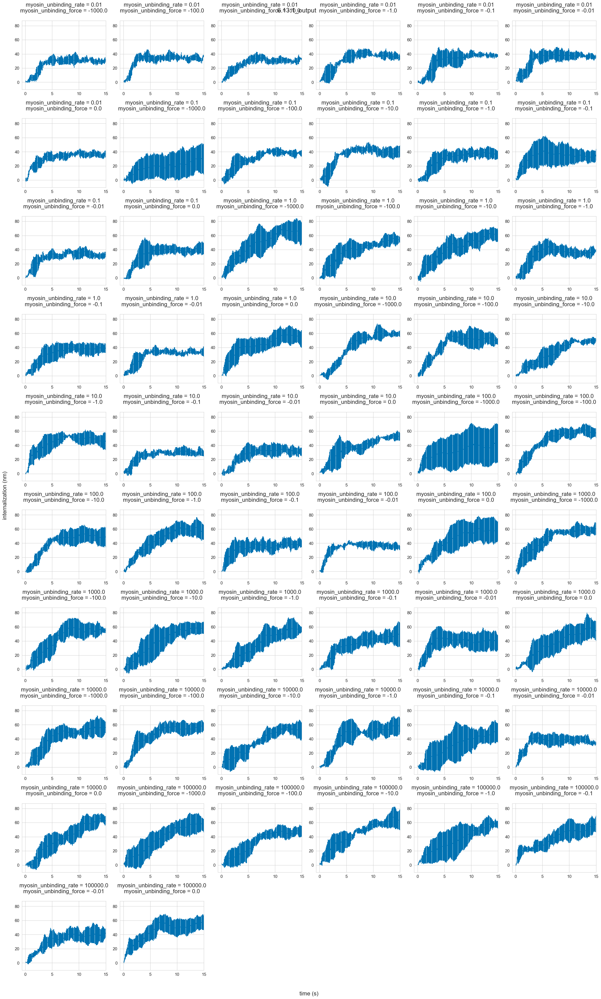
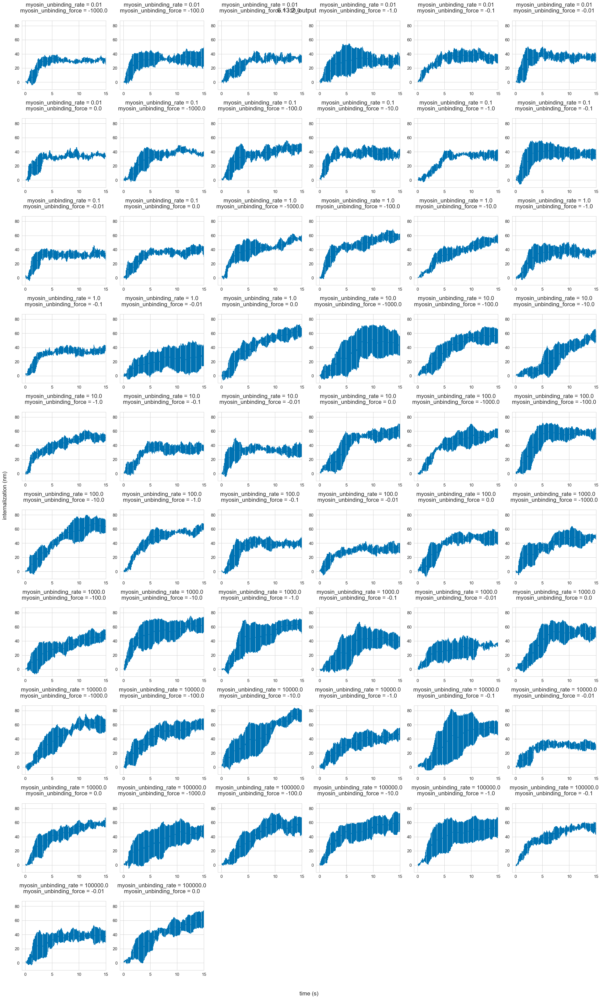
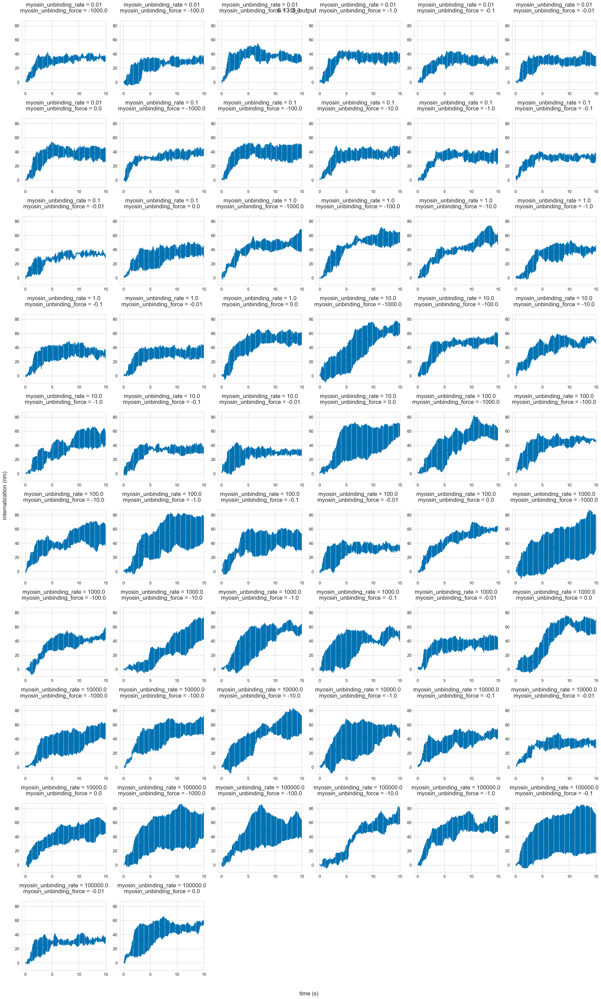

### specific overlaid means for figures

``` python
# ur, uf, speed, bc, mn
nomyo = ((100000.0, 0.0, 100.0, 200.0, 0.0),'no myosin','black')
assistive = ((10.0, -10.0, 100.0, 200.0, 100.0), 'weakly force-sensitive myosin','#009E73')
resistive = ((10.0, -0.01, 100.0, 200.0, 100.0), 'strongly force-sensitive myosin','#D55E00')


for name,label,color in [nomyo,assistive,resistive]:
    x = means.loc[name].reset_index()['time']
    y = means.loc[name]*1000
    ci95 = ci95s.loc[name]*1000
    plt.plot(x,y,label=label,color=color)
    plt.fill_between(x, y-ci95, y+ci95, color=color, alpha = 0.2)

plt.legend()
plt.xlabel('time (s)')
plt.ylabel('internalization (nm)')
plt.tight_layout()

if save_figures == 'yes':
    plt.savefig(working_dir+'figures/'+pref+'_mean_solid_zpos-vs-time_fig1.png')
    plt.savefig(working_dir+'figures/'+pref+'_mean_solid_zpos-vs-time_fig1.svg')
```

### specific mean and 95 percentile for figures

``` python
# ur, uf, speed, bc, mn
nomyo = ((100000.0, 0.0, 100.0, 200.0, 0.0),'no myosin')


for name,label in [nomyo]:
    x = means.loc[name].reset_index()['time']
    y = means.loc[name]*1000
    ci95 = ci95s.loc[name]*1000
    plt.plot(x,y,label='internalization',color='black')
    plt.fill_between(x, y-ci95, y+ci95, color='black', alpha = 0.2)
    #percentile = np.percentile(means.loc[name],95)*1000
    percentile_mean = grouped_summaries.loc[
(grouped_summaries['bud_confine']==name[3])&
(grouped_summaries['membrane_myosin_number']==name[4])&
(grouped_summaries['myosin_unbinding_rate']==name[0])&
(grouped_summaries['myosin_unbinding_force']==name[1])
]['internalization_95_percentile_mean']*1000
    percentile_ci95 = grouped_summaries.loc[
(grouped_summaries['bud_confine']==name[3])&
(grouped_summaries['membrane_myosin_number']==name[4])&
(grouped_summaries['myosin_unbinding_rate']==name[0])&
(grouped_summaries['myosin_unbinding_force']==name[1])
]['internalization_95_percentile_ci95']*1000
    plt.hlines(percentile_mean,x.min(),x.max(),linestyles='-.', label='95 percentile',color='#56B4E9')
    plt.fill_between(x,
                     np.full_like(x,percentile_mean-percentile_ci95),
                     np.full_like(x,percentile_mean+percentile_ci95),
                     alpha = 0.2, color='#56B4E9')

plt.legend(loc='lower right')
plt.xlabel('time (s)')
plt.ylabel('internalization (nm)')
#plt.ylim(top=120)
plt.tight_layout()

if save_figures == 'yes':
    plt.savefig(working_dir+'figures/'+pref+'_mean_solid_zpos-vs-time_percentile.png')
    plt.savefig(working_dir+'figures/'+pref+'_mean_solid_zpos-vs-time_percentile.svg')
```

### specific individual internalization and 95 percentile for figures

``` python
single_index = ('6.12.0_output','run0002_0000')
x = solid_allparams.loc[single_index].reset_index()['time']
y = solid_allparams.loc[single_index]['internalization']*1000
plt.plot(x,y,color='k',label='internalization')
p95 = np.percentile(y,95)
plt.hlines(p95,x.min(),x.max(),linestyles='-.',color='#56B4E9',label='95 percentile')
plt.legend(loc='lower right')

plt.xlabel('time (s)')
plt.ylabel('internalization (nm)')
#plt.ylim(top=120)
plt.tight_layout()

if save_figures == 'yes':
    plt.savefig(working_dir+'figures/'+pref+'_single_solid_zpos-vs-time_percentile.png')
    plt.savefig(working_dir+'figures/'+pref+'_single_solid_zpos-vs-time_percentile.svg')
```

## cumulative histogram

plot an example internalization and cumulative histogram

``` python
internalization = solid_allparams.loc[output_dir].loc[run]['internalization']*1000
y = internalization
x = internalization.reset_index()['time']
plt.plot(x,y)
plt.xlabel('time (s)')
plt.ylabel('internalization (nm)')

plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'_solid_internalization_example.png')
```

``` python
plt.hist(internalization, 50, cumulative=True, density=True, histtype='step')
percentile = np.percentile(internalization, 95)
plt.plot([percentile, percentile], [0,1], label='95th percentile')
plt.ylabel('cumulative density')
plt.xlabel('internalization (nm)')
plt.legend()

plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'_solid_cumhist_percentile_example.png')
```

plot all cumulative histograms with 95 percentile internalization marked

``` python
num_plots = total_runs

width = 6
height = num_plots//width + 1

fig, ax = plt.subplots(nrows=height, ncols=width, sharex=True, sharey=True, figsize=(4*width,5*height))
fig.add_subplot(111, frameon=False)
plt.tick_params(labelcolor='none', top='off', bottom='off', left='off', right='off')
plt.grid(False)
fig.text(0.5, 0, 'internalization (nm)', ha='center', size=24)
fig.text(0, 0.5, 'cumulative density', va='center', rotation='vertical', size=24)

plot_no = 0

for output_dir in output_dirs:
    rundirs = rundirs_allparams_df.loc[output_dir]
    for run in rundirs:
        if run == 'empty':
            continue
        internalization = solid_allparams.loc[output_dir].loc[run]['internalization']*1000
        props = properties_allparams.loc[output_dir].loc[run]
        viscosity = props['internalize.cym_viscosity']
        hip1r_off = props['strongbinder_unbinding'].split(',')[0]

        plot_no += 1

        plt.subplot(height,width,plot_no) #height, width
        plt.hist(internalization, 50, cumulative=True, density=True, histtype='step')
        percentile = np.percentile(internalization, 95)
        plt.plot([percentile, percentile], [0,1])
        plt.xlim(right = 100)
        #plt.ylim(top = 100)

        title = output_dir+'\n'+run+'\n'
        for prop in property_groups:
            title += prop + ' = ' + str(props[prop]) + '\n'

        plt.title(title)

plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'_solid_cumhist_percentile_all.png')
```

## plot 95th percentile internalization vs. parameter sweeps

``` python
percentiles_props = pd.concat([properties_unique, percentiles],axis=1)
percentiles_props.head()
```

``` python
plt.scatter(percentiles_props['bud_confine'], percentiles_props['95_percentile_internalization'])
```

``` python
percentiles_config = pd.concat([config_unique, percentiles],axis=1)
percentiles_config.head()
```

``` python
percentiles_config.loc[percentiles_config['membrane_myosin_number']==0].mean()
```

### scatterplot overlaid points

``` python
percentiles_props['myosin_unbinding'].fillna(value='empty', inplace=True)
x = []
y = []
z = []
for output_dir in output_dirs:
    rundirs = rundirs_allparams_df.loc[output_dir]
    for run in rundirs:
        if run == 'empty':
            continue
        myosin_unbinding = percentiles_props.loc[output_dir].loc[run]['myosin_unbinding']
        if myosin_unbinding == 'empty':
            continue
        myosin_off = float(myosin_unbinding.split(',')[0])
        myosin_catch = float(myosin_unbinding.split(',')[1])
        percentile = percentiles_props.loc[output_dir].loc[run]['95_percentile_internalization']
        x.append(myosin_off)
        y.append(myosin_catch)
        z.append(percentile)

plt.scatter(x,y,c=z,alpha=0.5,linewidths=10)
plt.xscale('symlog')
plt.yscale('symlog')
plt.xlabel('off-rate')
plt.ylabel('catch bond')
plt.gray()
plt.colorbar()
plt.tight_layout()

if save_figures == 'yes':
  plt.savefig(working_dir+'figures/'+pref+'_95per_sweep_overlay.png')
```

### average scatterplot

``` python
# unbinding_groups = percentiles_props.groupby(['myosin_unbinding'])
unbinding_groups = percentiles_props.groupby(['myosin_unbinding','bud_confine'])
summary_percentiles = pd.concat([unbinding_groups['95_percentile_internalization'].mean(),
                                 unbinding_groups['95_percentile_internalization'].std()],
                                axis=1, keys = ['mean', 'std']).reset_index()
summary_percentiles = pd.concat([summary_percentiles['myosin_unbinding'].str.split(', ', expand = True),
                                 summary_percentiles], axis = 1)
summary_percentiles.columns = ['myo_off', 'myo_catch', 'myosin_unbinding', 'bud_confine',
                               'mean_95_percentile_internalization', 'std_95_percentile_internalization']
summary_percentiles = summary_percentiles[~summary_percentiles['myosin_unbinding'].str.contains('empty')]
```

``` python
# unbinding_groups = percentiles_config.groupby(['myosin_unbinding'])
unbinding_groups = percentiles_config.groupby(config_groups)
summary_percentiles = pd.concat([unbinding_groups['95_percentile_internalization'].mean(),
                                 unbinding_groups['95_percentile_internalization'].std()],
                                axis=1, keys = ['mean_95_percentile_internalization', 'std_95_percentile_internalization']).reset_index()
#summary_percentiles = summary_percentiles[~summary_percentiles['myosin_unbinding'].str.contains('empty')]
plusmyo_percentiles = summary_percentiles.loc[summary_percentiles['membrane_myosin_number']>0]
nomyo_percentiles = summary_percentiles.loc[summary_percentiles['membrane_myosin_number']==0]
summary_percentiles.head()
```

1.  all

    ``` python
    x = pd.to_numeric(plusmyo_percentiles['myosin_unbinding_rate'])
    y = 1/pd.to_numeric(plusmyo_percentiles['myosin_unbinding_force'])
    y.replace([np.inf, -np.inf], 0, inplace=True)
    z = pd.to_numeric(plusmyo_percentiles['mean_95_percentile_internalization'])

    plt.scatter(x,y,c=z,alpha=1,linewidths=10)
    plt.xscale('symlog', linthresh=0.1)
    plt.yscale('symlog', linthresh=0.001)
    plt.xlabel('myosin unbinding rate ($s^{-1}$)')
    plt.ylabel('inverse myosin unbinding force ($pN^{-1}$)')
    plt.plasma()
    plt.colorbar(label='mean 95 percentile internalization')
    plt.tight_layout()

    if save_figures == 'yes':
      plt.savefig(working_dir+'figures/'+pref+'_95per_sweep_means_scatter_inverse.png')
    ```

2.  split by resistance

    1.  fully scaled coloring

        ``` python
        for bud_confine in config_unique.bud_confine.unique():
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          for membrane_myosin_number in config_unique.membrane_myosin_number.unique():
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            x = pd.to_numeric(subset_percentiles['myosin_unbinding_rate'])
            y = 1/pd.to_numeric(subset_percentiles['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            z = pd.to_numeric(subset_percentiles['mean_95_percentile_internalization'])

            plt.figure()
            plt.scatter(x,y,c=z,alpha=1,linewidths=10)
            plt.xscale('symlog', linthresh=0.1)
            plt.yscale('symlog', linthresh=0.001)
            plt.xlabel('myosin unbinding rate ($s^{-1}$)')
            plt.ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            plt.plasma()
            plt.colorbar(label='mean 95 percentile internalization')
            plt.title('resistance = '+str(bud_confine) + '\n' +
                      str(int(membrane_myosin_number)) + ' myosins')
            plt.tight_layout()

            if save_figures == 'yes':
              plt.savefig(working_dir+'figures/'+pref+'_95per_sweep_means_scatter_inverse_'+str(bud_confine)+'_'+str(membrane_myosin_number)+'.png')
        ```

    2.  colormap relative to no myosin, individually normalized

        ``` python
        for bud_confine in config_unique.bud_confine.unique():
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          for membrane_myosin_number in config_unique.membrane_myosin_number.unique():
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            x = pd.to_numeric(subset_percentiles['myosin_unbinding_rate'])
            y = 1/pd.to_numeric(subset_percentiles['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            z = pd.to_numeric(subset_percentiles['mean_95_percentile_internalization'])
            nomyo_z = nomyo_percentiles.loc[nomyo_percentiles['bud_confine']==bud_confine]['mean_95_percentile_internalization'].mean()

            plt.figure()
            #colorscale = colors.CenteredNorm(vcenter=nomyo_z)
            colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z,vmax=z.max()*1.2)
            #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
            plt.scatter(x,y,c=z,cmap=matplotlib.colormaps['seismic'], alpha=1,linewidths=10,norm=colorscale)
            plt.xscale('symlog', linthresh=0.1)
            plt.yscale('symlog', linthresh=0.001)
            plt.xlabel('myosin unbinding rate ($s^{-1}$)')
            plt.ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            #plt.plasma()
            plt.colorbar(label='mean 95 percentile internalization')
            plt.title('resistance = '+str(bud_confine) + '\n' +
                      str(int(membrane_myosin_number)) + ' myosins')
            plt.tight_layout()

            if save_figures == 'yes':

              plt.savefig(working_dir+'figures/'+pref+'_95per_difference_sweep_means_scatter_inverse_'+str(bud_confine)+'_'+str(membrane_myosin_number)+'.png')
        ```

    3.  colormap relative to no myosin, globally normalized

        ``` jupyter-python
        vrange = 0
        urange = 0
        lrange = 0

        for bud_confine in np.sort(config_unique.bud_confine.unique()):
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          nomyo_z = nomyo_percentiles.loc[nomyo_percentiles['bud_confine']==bud_confine]['mean_95_percentile_internalization'].mean()
          for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            mindelta = (subset_percentiles['mean_95_percentile_internalization'].min()-nomyo_z)/nomyo_z
            maxdelta = (subset_percentiles['mean_95_percentile_internalization'].max()-nomyo_z)/nomyo_z
            if np.abs(mindelta) > vrange:
              vrange = np.abs(mindelta)
            if np.abs(maxdelta) > vrange:
              vrange = np.abs(maxdelta)
            if mindelta < lrange:
              lrange = mindelta
            if maxdelta > urange:
              urange = maxdelta

        width = 3
        height = 4

        fig = plt.figure()
        fig.set_size_inches(7*width,5*height)

        plot_no = 1

        for bud_confine in np.sort(config_unique.bud_confine.unique()):
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          nomyo_z = nomyo_percentiles.loc[nomyo_percentiles['bud_confine']==bud_confine]['mean_95_percentile_internalization'].mean()
          for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            x = pd.to_numeric(subset_percentiles['myosin_unbinding_rate'])
            y = 1/pd.to_numeric(subset_percentiles['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            z = (pd.to_numeric(subset_percentiles['mean_95_percentile_internalization'])-nomyo_z)/nomyo_z

            ax = fig.add_subplot(height, width, plot_no)

            colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
            #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
            #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
            plt.scatter(x,y,c=100*z,cmap=matplotlib.colormaps['seismic'], alpha=1,s=1000,norm=colorscale)
            ax.set_xscale('symlog', linthresh=0.1)
            ax.set_yscale('symlog', linthresh=0.001)
            ax.set_xlabel('myosin unbinding rate ($s^{-1}$)')
            ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            #plt.plasma()
            plt.colorbar(label='% Δ mean 95 per. internalization')
            ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                      str(int(membrane_myosin_number)) + ' myosins')
            print(plot_no)

            plot_no += 1

        plt.tight_layout()

        if save_figures == 'yes':

          plt.savefig(working_dir+'figures/'+pref+'_95per_difference_gnorm_sweep_means_scatter_inverse.png')
        ```

### average contour plot

1.  all

    ``` python
    x = pd.to_numeric(plusmyo_percentiles['myosin_unbinding_rate'])
    y = 1/pd.to_numeric(plusmyo_percentiles['myosin_unbinding_force'])
    y.replace([np.inf, -np.inf], 0, inplace=True)
    z = pd.to_numeric(plusmyo_percentiles['mean_95_percentile_internalization'])

    cols = np.unique(x).shape[0]
    X = np.array(x).reshape(-1, cols)
    Y = np.array(y).reshape(-1, cols)
    Z = np.array(z).reshape(-1, cols)

    plt.contour([X,Y],Z)
    plt.xscale('symlog', linthresh=0.1)
    plt.yscale('symlog', linthresh=0.001)
    plt.xlabel('myosin unbinding rate ($s^{-1}$)')
    plt.ylabel('inverse myosin unbinding force ($pN^{-1}$)')
    plt.plasma()
    plt.colorbar(label='mean 95 percentile internalization')
    plt.tight_layout()

    if save_figures == 'yes':
      plt.savefig(working_dir+'figures/'+pref+'_95per_sweep_means_contour_inverse.png')
    ```

2.  split by resistance

    1.  fully scaled coloring

        ``` python
        for bud_confine in config_unique.bud_confine.unique():
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          for membrane_myosin_number in config_unique.membrane_myosin_number.unique():
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            x = np.array(pd.to_numeric(subset_percentiles['myosin_unbinding_rate']))
            y = 1/pd.to_numeric(subset_percentiles['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            y = np.array(y)
            z = np.array(pd.to_numeric(subset_percentiles['mean_95_percentile_internalization']))

            idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

            plt.figure()
            plt.contourf(x[idx],y[idx],z[idx])
            plt.xscale('symlog', linthresh=0.1)
            plt.yscale('symlog', linthresh=0.001)
            plt.xlabel('myosin unbinding rate ($s^{-1}$)')
            plt.ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            plt.plasma()
            plt.colorbar(label='mean 95 percentile internalization')
            plt.title('resistance = '+str(bud_confine) + '\n' +
                      str(int(membrane_myosin_number)) + ' myosins')
            plt.tight_layout()

            if save_figures == 'yes':
              plt.savefig(working_dir+'figures/'+pref+'_95per_sweep_means_contour_inverse_'+str(bud_confine)+'_'+str(membrane_myosin_number)+'.png')
        ```

    2.  colormap relative to no myosin

        ``` python
        for bud_confine in config_unique.bud_confine.unique():
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          for membrane_myosin_number in config_unique.membrane_myosin_number.unique():
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            x = np.array(pd.to_numeric(subset_percentiles['myosin_unbinding_rate']))
            y = 1/pd.to_numeric(subset_percentiles['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            y = np.array(y)
            z = np.array(pd.to_numeric(subset_percentiles['mean_95_percentile_internalization']))

            idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

            nomyo_z = nomyo_percentiles.loc[nomyo_percentiles['bud_confine']==bud_confine]['mean_95_percentile_internalization'].mean()

            plt.figure()
            #colorscale = colors.CenteredNorm(vcenter=nomyo_z)
            colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z,vmax=z.max()*1.2)
            #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
            plt.contourf(x[idx],y[idx],z[idx],cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
            plt.xscale('symlog', linthresh=0.1)
            plt.yscale('symlog', linthresh=0.001)
            plt.xlabel('myosin unbinding rate ($s^{-1}$)')
            plt.ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            #plt.plasma()
            plt.colorbar(label='mean 95 percentile internalization')
            plt.title('resistance = '+str(bud_confine) + '\n' +
                      str(int(membrane_myosin_number)) + ' myosins')
            plt.tight_layout()

            if save_figures == 'yes':

              plt.savefig(working_dir+'figures/'+pref+'_95per_difference_sweep_means_contour_inverse_'+str(bud_confine)+'_'+str(membrane_myosin_number)+'.png')
        ```

    3.  colormap relative to no myosin, globally normalized

        ``` jupyter-python
        vrange = 0
        urange = 0
        lrange = 0

        for bud_confine in np.sort(config_unique.bud_confine.unique()):
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          nomyo_z = nomyo_percentiles.loc[nomyo_percentiles['bud_confine']==bud_confine]['mean_95_percentile_internalization'].mean()
          for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            mindelta = (subset_percentiles['mean_95_percentile_internalization'].min()-nomyo_z)/nomyo_z
            maxdelta = (subset_percentiles['mean_95_percentile_internalization'].max()-nomyo_z)/nomyo_z
            if np.abs(mindelta) > vrange:
              vrange = np.abs(mindelta)
            if np.abs(maxdelta) > vrange:
              vrange = np.abs(maxdelta)
            if mindelta < lrange:
              lrange = mindelta
            if maxdelta > urange:
              urange = maxdelta

        width = 3
        height = 4

        fig = plt.figure()
        fig.set_size_inches(7*width,5*height)

        plot_no = 1

        for bud_confine in np.sort(config_unique.bud_confine.unique()):
          confine_percentiles = plusmyo_percentiles[plusmyo_percentiles['bud_confine']==bud_confine]
          nomyo_z = nomyo_percentiles.loc[nomyo_percentiles['bud_confine']==bud_confine]['mean_95_percentile_internalization'].mean()
          for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
              continue
            subset_percentiles = confine_percentiles[confine_percentiles['membrane_myosin_number']==membrane_myosin_number]
            x = np.array(pd.to_numeric(subset_percentiles['myosin_unbinding_rate']))
            y = 1/pd.to_numeric(subset_percentiles['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            y = np.array(y)
            z = np.array((pd.to_numeric(subset_percentiles['mean_95_percentile_internalization'])-nomyo_z)/nomyo_z)

            idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

            ax = fig.add_subplot(height, width, plot_no)

            colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
            #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
            #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
            plt.contourf(x[idx],y[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
            ax.set_xscale('symlog', linthresh=0.1)
            ax.set_yscale('symlog', linthresh=0.001)
            ax.set_xlabel('myosin unbinding rate ($s^{-1}$)')
            ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            #plt.plasma()
            plt.colorbar(label='% Δ mean 95 per. internalization')
            ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                      str(int(membrane_myosin_number)) + ' myosins')
            #print(plot_no)

            plot_no += 1

        plt.tight_layout()

        if save_figures == 'yes':
          plt.savefig(working_dir+'figures/'+pref+'_95per_difference_sweep_means_contour_inverse_6.png')
        ```

## actin analysis

### prototyping

1.  actin growth

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['growth_total_mean','growth_capped_mean','growth_uncapped_mean','growth_growing_mean'],ylabel='μm')
    ```

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['growth_associated_mean','growth_associated_capped_mean','growth_associated_uncapped_mean','growth_associated_growing_mean'],ylabel='μm')
    ```

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['growth_total_sum','growth_capped_sum','growth_uncapped_sum','growth_growing_sum'],ylabel='μm')
    ```

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['growth_associated_sum','growth_associated_capped_sum','growth_associated_uncapped_sum','growth_associated_growing_sum'],ylabel='μm')
    ```

2.  actin count

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['count_total','count_capped','count_uncapped','count_growing'],ylabel='number of filaments')
    ```

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['count_associated','count_associated_capped','count_associated_uncapped','count_associated_growing'],ylabel='number of filaments')
    ```

3.  actin mass/density

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['mass_total','mass_capped','mass_uncapped','mass_growing'],ylabel='"mass" (sum lengths, μm)')
    ```

    ``` python
    fiber_ends_summary_allparams.loc['6.12a.8_output'].loc['run0108_0000'].plot(y=['mass_associated','mass_associated_capped','mass_associated_uncapped','mass_associated_growing'],ylabel='"mass" (sum lengths, μm)')
    ```

### all actin

1.  actin density

    1.  all actin output means of runs with same properties

        ``` python
        # num_plots = len(solid_property_groups)
        num_plots = len(solid_config_groups)

        width = 6
        if width > num_plots:
            width = 1
        height = int(math.ceil(float(num_plots)/float(width)))

        for column in actin_points_means.columns:

            fig = plt.figure()
            fig.set_size_inches(6*width,6*height)

            commonaxis = plt.axes(frameon=False)
            commonaxis.set_xticks([])
            commonaxis.set_yticks([])
            commonaxis.yaxis.labelpad = 40 # move the labels a bit away from panels
            commonaxis.xaxis.labelpad = 40 # move the labels a bit away from panels
            commonaxis.set( xlabel = 'time (s)' )
            commonaxis.set( ylabel = column )

            plot_no = 1
            plot_max = np.max(actin_points_means[column] + actin_points_stds[column])
            plot_min = np.min(actin_points_means[column] - actin_points_stds[column])

            for name, group in solid_config_groups:
                x = actin_points_means.loc[name].reset_index()['time']
                y = actin_points_means.loc[name][column]
                std = actin_points_stds.loc[name][column]

                ax = fig.add_subplot(height, width, plot_no)
                ax.errorbar(x,y,std)
                ax.set_xlim(right = 15)
                ax.set_ylim(bottom = plot_min, top = plot_max)

                title = ''
                for prop, value in zip(config_groups, name):
                    title += prop + ' = ' + str(value) + '\n'

                ax.set_title(title)
                # ax2[plot_row, plot_col].set_title(title)

                #print(plot_no)

                plot_no += 1

            plt.tight_layout()

            if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_mean_'+column+'-vs-time_all.png')
        ```

    2.  total actin

        ``` python
        actin_endpoints_props = pd.concat([properties_unique, actin_endpoints],axis=1)
        actin_endpoints_props.head()
        ```

        ``` python
        actin_endpoints_configs = pd.concat([config_unique, actin_endpoints],axis=1)
        actin_endpoints_configs.head()
        ```

        ``` python
        actin_endpoints_configs.loc[(actin_endpoints_configs['membrane_myosin_number']=='0') &
                                (actin_endpoints_configs['bud_confine']==2)].mean()
        ```

        ``` python
        actin_endpoints_configs.loc[(actin_endpoints_configs['membrane_myosin_number']=='0') &
                                (actin_endpoints_configs['bud_confine']==20)].mean()
        ```

        ``` python
        actin_endpoints_configs.loc[(actin_endpoints_configs['membrane_myosin_number']=='0') &
                                (actin_endpoints_configs['bud_confine']==200)].mean()
        ```

        ``` python
        # props_groups = actin_endpoints_props.groupby(['myosin_unbinding'])
        props_groups = actin_endpoints_props.groupby(['myosin_unbinding','bud_confine'])
        summary_actin_endpoints = pd.concat([props_groups['actin_points'].mean(),
                                         props_groups['actin_points'].std()],
                                        axis=1, keys = ['mean', 'std']).reset_index()
        summary_actin_endpoints = pd.concat([summary_actin_endpoints['myosin_unbinding'].str.split(', ', expand = True),
                                         summary_actin_endpoints], axis = 1)
        summary_actin_endpoints.columns = ['myo_off', 'myo_catch', 'myosin_unbinding', 'bud_confine',
                                       'mean_actin_points', 'std_actin_points']
        summary_actin_endpoints = summary_actin_endpoints[~summary_actin_endpoints['myosin_unbinding'].str.contains('empty')]
        ```

        ``` python
        for bud_confine in properties_unique.bud_confine.unique():
          subset_actin_endpoints = summary_actin_endpoints[summary_actin_endpoints['bud_confine']==bud_confine]
          x = pd.to_numeric(subset_actin_endpoints['myo_off'])
          y = 1/pd.to_numeric(subset_actin_endpoints['myo_catch'])
          y.replace([np.inf, -np.inf], 0, inplace=True)
          z = pd.to_numeric(subset_actin_endpoints['mean_actin_points'])

          plt.figure()
          plt.scatter(x,y,c=z,alpha=1,linewidths=10)
          plt.xscale('symlog', linthresh=0.1)
          plt.yscale('symlog', linthresh=0.001)
          plt.xlabel('myosin unbinding rate ($s^{-1}$)')
          plt.ylabel('inverse myosin unbinding force ($pN^{-1}$)')
          plt.plasma()
          plt.colorbar(label='mean total actin at final timepoint')
          plt.title('resistance = '+str(bud_confine))
          plt.tight_layout()

          if save_figures == 'yes':
            plt.savefig(working_dir+'figures/'+pref+'_finalactin_sweep_means_scatter_inverse_'+str(bud_confine)+'.png')
        ```

2.  elongation rate

    1.  write a version of [Analyze 95 percentile
        internalization](id:e5abbebc-5839-4809-a148-c9d28a75bafc) for
        mean growth for each simulation from
        growing<sub>endssummaryallparams</sub>
    2.  combine it with config unique like in [total
        actin](id:fde3574f-ca88-4c64-89a4-89e8f41ed063)
    3.  plot contour map of mean actin elongation rates

3.  branch nucleation rate/number of filaments

### hip1r-bound actin

## summary scatterplots/contour maps

### number of simulations

1.  motile myosins

    ``` python
    width = 3
    height = 4

    fig = plt.figure()
    fig.set_size_inches(6*width,5*height)

    plot_no = 1

    for bud_confine in np.sort(config_unique.bud_confine.unique()):
      confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
      for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
        if membrane_myosin_number == 0:
          continue
        subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
        x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
        #y = -1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
        y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
        y.replace([np.inf, -np.inf], 0, inplace=True)
        y = np.array(y)
        z = np.array(pd.to_numeric(subset_grouped_summaries['sim_count']))

        idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

        ax = fig.add_subplot(height, width, plot_no)
        #plt.figure()
        #plt.contourf(x[idx],y[idx],z[idx])
        plt.scatter(y,x,c=z,alpha=1,linewidths=10)
        ax.set_yscale('symlog', linthresh=0.1)
        #ax.set_yscale('symlog', linthresh=0.001)
        ax.set_xscale('symlog', linthresh=0.002)
        ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
        #ax.set_ylabel('catch bond strength ($pN^{-1}$)')
        ax.set_xlabel('myosin distance parameter ($nm$)')
        plt.plasma()
        plt.colorbar(label='number of simulations analyzed')
        ax.set_title('resistance = '+str(bud_confine) + '\n' +
                  str(int(membrane_myosin_number)) + ' myosins')

        plot_no += 1
    plt.tight_layout()

    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_motile_sim_count_scatter_inverse.png')
        plt.savefig(working_dir+'figures/'+pref+'_motile_sim_count_scatter_inverse.svg')
    ```

2.  immotile myosins

    ``` python
    width = 3
    height = 4

    fig = plt.figure()
    fig.set_size_inches(6*width,5*height)

    plot_no = 1

    for bud_confine in np.sort(config_unique.bud_confine.unique()):
      confine_grouped_summaries = immotile_grouped_summaries[immotile_grouped_summaries['bud_confine']==bud_confine]
      for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
        if membrane_myosin_number == 0:
          continue
        subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
        x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
        #y = -1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
        y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
        y.replace([np.inf, -np.inf], 0, inplace=True)
        y = np.array(y)
        z = np.array(pd.to_numeric(subset_grouped_summaries['sim_count']))

        idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

        ax = fig.add_subplot(height, width, plot_no)
        #plt.figure()
        #plt.contourf(x[idx],y[idx],z[idx])
        plt.scatter(y,x,c=z,alpha=1,linewidths=10)
        ax.set_yscale('symlog', linthresh=0.1)
        #ax.set_yscale('symlog', linthresh=0.001)
        ax.set_xscale('symlog', linthresh=0.002)
        ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
        #ax.set_ylabel('catch bond strength ($pN^{-1}$)')
        ax.set_xlabel('myosin distance parameter ($nm$)')
        plt.plasma()
        plt.colorbar(label='number of simulations analyzed')
        ax.set_title('resistance = '+str(bud_confine) + '\n' +
                  str(int(membrane_myosin_number)) + ' myosins')

        plot_no += 1
    plt.tight_layout()

    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_immotile_sim_count_scatter_inverse.png')
        plt.savefig(working_dir+'figures/'+pref+'_immotile_sim_count_scatter_inverse.svg')
    ```

### internalization

1.  split by resistance

    1.  colormap relative to no myosin, globally normalized

        1.  motile

            ``` python
            vrange = 0
            urange = 0
            lrange = 0

            for bud_confine in np.sort(config_unique.bud_confine.unique()):
              confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['internalization_95_percentile_mean'].mean()
              for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                mindelta = (subset_grouped_summaries['internalization_95_percentile_mean'].min()-nomyo_z)/nomyo_z
                maxdelta = (subset_grouped_summaries['internalization_95_percentile_mean'].max()-nomyo_z)/nomyo_z
                if np.abs(mindelta) > vrange:
                  vrange = np.abs(mindelta)
                if np.abs(maxdelta) > vrange:
                  vrange = np.abs(maxdelta)
                if mindelta < lrange:
                  lrange = mindelta
                if maxdelta > urange:
                  urange = maxdelta

            width = 3
            height = 4

            fig = plt.figure()
            fig.set_size_inches(6*width,5*height)

            plot_no = 1

            for bud_confine in np.sort(config_unique.bud_confine.unique()):
              confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['internalization_95_percentile_mean'].mean()
              for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                y.replace([np.inf, -np.inf], 0, inplace=True)
                y = np.array(y)
                z = np.array((pd.to_numeric(subset_grouped_summaries['internalization_95_percentile_mean'])-nomyo_z)/nomyo_z)

                idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                ax = fig.add_subplot(height, width, plot_no)

                colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                plt.contourf(y[idx],x[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                ax.set_yscale('symlog', linthresh=0.1)
                ax.set_xscale('symlog', linthresh=0.002)
                ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
                ax.set_xlabel('inverse myosin unbinding force ($pN^{-1}$)')
                #plt.plasma()
                plt.colorbar(label='% Δ mean 95 per. internalization')
                ax.set_title('+ power stroke\nresistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                          str(int(membrane_myosin_number)) + ' myosins')
                #print(plot_no)

                plot_no += 1

            plt.tight_layout()

            if save_figures == 'yes':
              plt.savefig(working_dir+'figures/'+pref+'_motile_95per_difference_sweep_means_contour_inverse_6.png')
              plt.savefig(working_dir+'figures/'+pref+'_motile_95per_difference_sweep_means_contour_inverse_6.svg')
            ```

        2.  immotile

            ``` python
            vrange = 0
            urange = 0
            lrange = 0

            immotile_config_unique = config_unique.loc[config_unique['myosin_max_speed']==0]

            for bud_confine in np.sort(config_unique.bud_confine.unique()):
              confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['internalization_95_percentile_mean'].mean()
              for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                mindelta = (subset_grouped_summaries['internalization_95_percentile_mean'].min()-nomyo_z)/nomyo_z
                maxdelta = (subset_grouped_summaries['internalization_95_percentile_mean'].max()-nomyo_z)/nomyo_z
                if np.abs(mindelta) > vrange:
                  vrange = np.abs(mindelta)
                if np.abs(maxdelta) > vrange:
                  vrange = np.abs(maxdelta)
                if mindelta < lrange:
                  lrange = mindelta
                if maxdelta > urange:
                  urange = maxdelta

            width = 3
            height = 4

            fig = plt.figure()
            fig.set_size_inches(7*width,5*height)

            plot_no = 1

            for bud_confine in np.sort(immotile_config_unique.bud_confine.unique()):
              confine_grouped_summaries = immotile_grouped_summaries[immotile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['internalization_95_percentile_mean'].mean()
              for membrane_myosin_number in np.sort(immotile_config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                y.replace([np.inf, -np.inf], 0, inplace=True)
                y = np.array(y)
                z = np.array((pd.to_numeric(subset_grouped_summaries['internalization_95_percentile_mean'])-nomyo_z)/nomyo_z)

                idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                ax = fig.add_subplot(height, width, plot_no)

                colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                plt.contourf(x[idx],y[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                ax.set_xscale('symlog', linthresh=0.1)
                ax.set_yscale('symlog', linthresh=0.001)
                ax.set_xlabel('myosin unbinding rate ($s^{-1}$)')
                ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                #plt.plasma()
                plt.colorbar(label='% Δ mean 95 per. internalization')
                ax.set_title('no power stroke\nresistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                          str(int(membrane_myosin_number)) + ' myosins')
                #print(plot_no)

                plot_no += 1

            plt.tight_layout()

            if save_figures == 'yes':
              plt.savefig(working_dir+'figures/'+pref+'_immotile_95per_difference_sweep_means_contour_inverse_6.png')
            ```

### cumulative attenuation

1.  split by resistance

    1.  raw mean

        ``` python
        width = 3
        height = 4

        fig = plt.figure()
        fig.set_size_inches(7*width,5*height)

        plot_no = 1

        for bud_confine in np.sort(config_unique.bud_confine.unique()):
          confine_grouped_summaries = plusmyo_grouped_summaries[plusmyo_grouped_summaries['bud_confine']==bud_confine]
          for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
              continue
            subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
            x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
            y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            y = np.array(y)
            z = np.array(pd.to_numeric(subset_grouped_summaries['growth_attenuation_cumsum_max_mean']))

            idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

            ax = fig.add_subplot(height, width, plot_no)
            #plt.figure()
            #plt.contourf(x[idx],y[idx],z[idx])
            plt.scatter(x,y,c=z,alpha=1,linewidths=10)
            ax.set_xscale('symlog', linthresh=0.1)
            ax.set_yscale('symlog', linthresh=0.001)
            ax.set_xlabel('myosin unbinding rate ($s^{-1}$)')
            ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            plt.plasma()
            plt.colorbar(label='mean cumulative sum \nelongation attenuation (μm)')
            ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                      str(int(membrane_myosin_number)) + ' myosins')

            plot_no += 1
        plt.tight_layout()

        if save_figures == 'yes':
            plt.savefig(working_dir+'figures/'+pref+'_mean_attenuation_cumsum_scatter_inverse.png')
        ```

    2.  raw std

        ``` python
        width = 3
        height = 4

        fig = plt.figure()
        fig.set_size_inches(7*width,5*height)

        plot_no = 1

        for bud_confine in np.sort(config_unique.bud_confine.unique()):
          confine_grouped_summaries = plusmyo_grouped_summaries[plusmyo_grouped_summaries['bud_confine']==bud_confine]
          for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
              continue
            subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
            x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
            y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
            y.replace([np.inf, -np.inf], 0, inplace=True)
            y = np.array(y)
            z = np.array(pd.to_numeric(subset_grouped_summaries['growth_attenuation_cumsum_max_std']))

            idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

            ax = fig.add_subplot(height, width, plot_no)
            #plt.figure()
            #plt.contourf(x[idx],y[idx],z[idx])
            plt.scatter(x,y,c=z,alpha=1,linewidths=10)
            ax.set_xscale('symlog', linthresh=0.1)
            ax.set_yscale('symlog', linthresh=0.001)
            ax.set_xlabel('myosin unbinding rate ($s^{-1}$)')
            ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
            plt.plasma()
            plt.colorbar(label='std cumulative sum \nelongation attenuation (μm)')
            ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                      str(int(membrane_myosin_number)) + ' myosins')

            plot_no += 1
        plt.tight_layout()

        if save_figures == 'yes':
            plt.savefig(working_dir+'figures/'+pref+'_std_attenuation_cumsum_scatter_inverse.png')
        ```

    3.  colormap relative to no myosin, globally normalized

        1.  motile

            ``` jupyter-python
            vrange = 0
            urange = 0
            lrange = 0

            for bud_confine in np.sort(config_unique.bud_confine.unique()):
              confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['growth_attenuation_cumsum_max_mean'].mean()
              for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                mindelta = (subset_grouped_summaries['growth_attenuation_cumsum_max_mean'].min()-nomyo_z)/nomyo_z
                maxdelta = (subset_grouped_summaries['growth_attenuation_cumsum_max_mean'].max()-nomyo_z)/nomyo_z
                if np.abs(mindelta) > vrange:
                  vrange = np.abs(mindelta)
                if np.abs(maxdelta) > vrange:
                  vrange = np.abs(maxdelta)
                if mindelta < lrange:
                  lrange = mindelta
                if maxdelta > urange:
                  urange = maxdelta

            width = 3
            height = 4

            fig = plt.figure()
            fig.set_size_inches(7*width,5*height)

            plot_no = 1

            for bud_confine in np.sort(config_unique.bud_confine.unique()):
              confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['growth_attenuation_cumsum_max_mean'].mean()
              for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                y.replace([np.inf, -np.inf], 0, inplace=True)
                y = np.array(y)
                z = np.array((pd.to_numeric(subset_grouped_summaries['growth_attenuation_cumsum_max_mean'])-nomyo_z)/nomyo_z)

                idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                ax = fig.add_subplot(height, width, plot_no)

                colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                plt.contourf(x[idx],y[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                ax.set_xscale('symlog', linthresh=0.1)
                ax.set_yscale('symlog', linthresh=0.001)
                ax.set_xlabel('myosin unbinding rate ($s^{-1}$)')
                ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                #plt.plasma()
                plt.colorbar(label='% Δ mean 95 per. internalization')
                ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                          str(int(membrane_myosin_number)) + ' myosins')
                #print(plot_no)

                plot_no += 1

            plt.tight_layout()

            if save_figures == 'yes':
              plt.savefig(working_dir+'figures/'+pref+'motile_growth_attenuation_cumsum_max_mean_difference_contour_inverse_6.png')
            ```

        2.  immotile

            ``` jupyter-python
            vrange = 0
            urange = 0
            lrange = 0

            immotile_config_unique = config_unique.loc[config_unique['myosin_max_speed']==0]

            for bud_confine in np.sort(config_unique.bud_confine.unique()):
              confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['growth_attenuation_cumsum_max_mean'].mean()
              for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                mindelta = (subset_grouped_summaries['growth_attenuation_cumsum_max_mean'].min()-nomyo_z)/nomyo_z
                maxdelta = (subset_grouped_summaries['growth_attenuation_cumsum_max_mean'].max()-nomyo_z)/nomyo_z
                if np.abs(mindelta) > vrange:
                  vrange = np.abs(mindelta)
                if np.abs(maxdelta) > vrange:
                  vrange = np.abs(maxdelta)
                if mindelta < lrange:
                  lrange = mindelta
                if maxdelta > urange:
                  urange = maxdelta

            width = 3
            height = 4

            fig = plt.figure()
            fig.set_size_inches(7*width,5*height)

            plot_no = 1

            for bud_confine in np.sort(immotile_config_unique.bud_confine.unique()):
              confine_grouped_summaries = immotile_grouped_summaries[immotile_grouped_summaries['bud_confine']==bud_confine]
              nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]['growth_attenuation_cumsum_max_mean'].mean()
              for membrane_myosin_number in np.sort(immotile_config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                  continue
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                y.replace([np.inf, -np.inf], 0, inplace=True)
                y = np.array(y)
                z = np.array((pd.to_numeric(subset_grouped_summaries['growth_attenuation_cumsum_max_mean'])-nomyo_z)/nomyo_z)

                idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                ax = fig.add_subplot(height, width, plot_no)

                colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                plt.contourf(x[idx],y[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                ax.set_xscale('symlog', linthresh=0.1)
                ax.set_yscale('symlog', linthresh=0.001)
                ax.set_xlabel('myosin unbinding rate ($s^{-1}$)')
                ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                #plt.plasma()
                plt.colorbar(label='% Δ mean 95 per. internalization')
                ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                          str(int(membrane_myosin_number)) + ' myosins')
                #print(plot_no)

                plot_no += 1

            plt.tight_layout()

            if save_figures == 'yes':
              plt.savefig(working_dir+'figures/'+pref+'immotile_growth_attenuation_cumsum_max_mean_difference_contour_inverse_6.png')
            ```

### all statistics

1.  raw

    1.  all copy numbers

        1.  motile

            ``` python
            for statistic in list(grouped_summaries):

              width = 3
              height = 4

              fig = plt.figure()
              fig.set_size_inches(6*width,5*height)

              plot_no = 1

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                  if membrane_myosin_number == 0:
                    continue
                  subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                  x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                  y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
                  y.replace([np.inf, -np.inf], 0, inplace=True)
                  y = np.array(y)
                  z = np.array(pd.to_numeric(subset_grouped_summaries[statistic]))

                  idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                  ax = fig.add_subplot(height, width, plot_no)

                  colorscale = colors.CenteredNorm(vcenter=0)
                  #colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                  plt.contourf(y[idx],x[idx],z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                  ax.set_yscale('symlog', linthresh=0.1)
                  #ax.set_yscale('symlog', linthresh=0.001)
                  ax.set_xscale('symlog', linthresh=0.002)
                  ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
                  #ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                  #ax.set_ylabel('myosin catch bond strength ($pN^{-1}$)')
                  ax.set_xlabel('myosin distance parameter ($nm$)')
                  #plt.plasma()
                  plt.colorbar(label=statistic)
                  ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins')
                  #print(plot_no)

                  plot_no += 1

              plt.tight_layout()

              if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_motile_contour_6.png')
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_motile_contour_6.svg')
            ```

        2.  immotile

            ``` python
            immotile_config_unique = config_unique.loc[config_unique['myosin_max_speed']==0]

            for statistic in list(grouped_summaries):

              width = 1
              height = 1

              fig = plt.figure()
              fig.set_size_inches(6*width,5*height)

              plot_no = 1

              for bud_confine in np.sort(immotile_config_unique.bud_confine.unique()):
                confine_grouped_summaries = immotile_grouped_summaries[immotile_grouped_summaries['bud_confine']==bud_confine]
                for membrane_myosin_number in np.sort(immotile_config_unique.membrane_myosin_number.unique()):
                  if membrane_myosin_number == 0:
                    continue
                  subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                  x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                  y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
                  y.replace([np.inf, -np.inf], 0, inplace=True)
                  y = np.array(y)
                  z = np.array(pd.to_numeric(subset_grouped_summaries[statistic]))

                  idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                  ax = fig.add_subplot(height, width, plot_no)

                  colorscale = colors.CenteredNorm(vcenter=0)
                  #colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                  plt.contourf(y[idx],x[idx],z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                  ax.set_yscale('symlog', linthresh=0.1)
                  #ax.set_yscale('symlog', linthresh=0.001)
                  ax.set_xscale('symlog', linthresh=0.002)
                  ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
                  #ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                  #ax.set_ylabel('myosin catch bond strength ($pN^{-1}$)')
                  ax.set_xlabel('myosin distance parameter ($nm$)')
                  #plt.plasma()
                  plt.colorbar(label=statistic)
                  ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins')
                  #print(plot_no)

                  plot_no += 1

              plt.tight_layout()

              if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_immotile_contour_6.png')
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_immotile_contour_6.svg')
            ```

2.  relative to no myosin

    1.  all copy numbers

        1.  motile

            ``` python
            for statistic in list(grouped_summaries):

              vrange = 0
              urange = 0
              lrange = 0

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                  if membrane_myosin_number == 0:
                    continue
                  subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                  mindelta = (subset_grouped_summaries[statistic].min()-nomyo_z)/nomyo_z
                  maxdelta = (subset_grouped_summaries[statistic].max()-nomyo_z)/nomyo_z
                  if np.abs(mindelta) > vrange:
                    vrange = np.abs(mindelta)
                  if np.abs(maxdelta) > vrange:
                    vrange = np.abs(maxdelta)
                  if mindelta < lrange:
                    lrange = mindelta
                  if maxdelta > urange:
                    urange = maxdelta

              width = 3
              height = 4

              fig = plt.figure()
              fig.set_size_inches(6*width,5*height)

              plot_no = 1

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                  if membrane_myosin_number == 0:
                    continue
                  subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                  x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                  #y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                  #y = -1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                  y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
                  y.replace([np.inf, -np.inf], 0, inplace=True)
                  y = np.array(y)
                  z = np.array((pd.to_numeric(subset_grouped_summaries[statistic])-nomyo_z)/nomyo_z)

                  idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                  ax = fig.add_subplot(height, width, plot_no)

                  colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                  plt.contourf(y[idx],x[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                  ax.set_yscale('symlog', linthresh=0.1)
                  #ax.set_yscale('symlog', linthresh=0.001)
                  ax.set_xscale('symlog', linthresh=0.002)
                  ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
                  #ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                  #ax.set_ylabel('myosin catch bond strength ($pN^{-1}$)')
                  ax.set_xlabel('myosin distance parameter ($nm$)')
                  #plt.plasma()
                  plt.colorbar(label='% Δ '+statistic)
                  ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins')
                  #print(plot_no)

                  plot_no += 1

              plt.tight_layout()

              if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_motile_difference_contour_6.png')
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_motile_difference_contour_6.svg')
            ```

        2.  immotile

            ``` python
            immotile_config_unique = config_unique.loc[config_unique['myosin_max_speed']==0]

            for statistic in list(grouped_summaries):

              vrange = 0
              urange = 0
              lrange = 0

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                  if membrane_myosin_number == 0:
                    continue
                  subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                  mindelta = (subset_grouped_summaries[statistic].min()-nomyo_z)/nomyo_z
                  maxdelta = (subset_grouped_summaries[statistic].max()-nomyo_z)/nomyo_z
                  if np.abs(mindelta) > vrange:
                    vrange = np.abs(mindelta)
                  if np.abs(maxdelta) > vrange:
                    vrange = np.abs(maxdelta)
                  if mindelta < lrange:
                    lrange = mindelta
                  if maxdelta > urange:
                    urange = maxdelta

              width = 1
              height = 1

              fig = plt.figure()
              fig.set_size_inches(6*width,5*height)

              plot_no = 1

              for bud_confine in np.sort(immotile_config_unique.bud_confine.unique()):
                confine_grouped_summaries = immotile_grouped_summaries[immotile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                for membrane_myosin_number in np.sort(immotile_config_unique.membrane_myosin_number.unique()):
                  if membrane_myosin_number == 0:
                    continue
                  subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                  x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                  #y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                  #y = -1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                  y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
                  y.replace([np.inf, -np.inf], 0, inplace=True)
                  y = np.array(y)
                  z = np.array((pd.to_numeric(subset_grouped_summaries[statistic])-nomyo_z)/nomyo_z)

                  idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                  ax = fig.add_subplot(height, width, plot_no)

                  colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                  #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                  plt.contourf(y[idx],x[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                  ax.set_yscale('symlog', linthresh=0.1)
                  #ax.set_yscale('symlog', linthresh=0.001)
                  ax.set_xscale('symlog', linthresh=0.002)
                  ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
                  #ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                  #ax.set_ylabel('myosin catch bond strength ($pN^{-1}$)')
                  ax.set_xlabel('myosin distance parameter ($nm$)')
                  #plt.plasma()
                  plt.colorbar(label='% Δ '+statistic)
                  ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins')
                  #print(plot_no)

                  plot_no += 1

              plt.tight_layout()

              if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_immotile_difference_contour_6.png')
                plt.savefig(working_dir+'figures/'+pref+'_'+statistic+'_immotile_difference_contour_6.svg')
            ```

    2.  just 100 myosins

        1.  no known myosins

            ``` python
            membrane_myosin_number = 100
            for statistic in list(grouped_summaries):

              vrange = 0
              urange = 0
              lrange = 0

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                mindelta = (subset_grouped_summaries[statistic].min()-nomyo_z)/nomyo_z
                maxdelta = (subset_grouped_summaries[statistic].max()-nomyo_z)/nomyo_z
                if np.abs(mindelta) > vrange:
                  vrange = np.abs(mindelta)
                if np.abs(maxdelta) > vrange:
                  vrange = np.abs(maxdelta)
                if mindelta < lrange:
                  lrange = mindelta
                if maxdelta > urange:
                  urange = maxdelta

              width = 1
              height = 4

              fig = plt.figure()
              fig.set_size_inches(6*width,5*height)

              plot_no = 1

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                #y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                #y = -1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
                y.replace([np.inf, -np.inf], 0, inplace=True)
                y = np.array(y)
                z = np.array((pd.to_numeric(subset_grouped_summaries[statistic])-nomyo_z)/nomyo_z)

                idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                ax = fig.add_subplot(height, width, plot_no)

                colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                plt.contourf(y[idx],x[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                ax.set_yscale('symlog', linthresh=0.1)
                #ax.set_yscale('symlog', linthresh=0.001)
                ax.set_xscale('symlog', linthresh=0.002)
                ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
                #ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                #ax.set_ylabel('myosin catch bond strength ($pN^{-1}$)')
                ax.set_xlabel('myosin distance parameter ($nm$)')
                #plt.plasma()
                plt.colorbar(label='% Δ '+statistic)
                ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                          str(int(membrane_myosin_number)) + ' myosins')
                #print(plot_no)

                plot_no += 1

              plt.tight_layout()

              if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_100myo_'+statistic+'_motile_difference_contour_6.png')
                plt.savefig(working_dir+'figures/'+pref+'_100myo_'+statistic+'_motile_difference_contour_6.svg')
            ```

        2.  with known myosins

            myo5 from \[@pedersen_endocytic_2023-1\] myo1b from
            \[@laakso_myosin_2008\] myo1ba-d from
            \[@laakso_control_2010\] myo1c from
            \[@greenberg_myosin_2012\]

            ``` python
            myo5_ur = 67.6
            myo5_dp = 1.14
            myo1b_ur = 1.6
            myo1b_dp = 12
            myo1ba_dp = 18
            myo1bb_dp = 15
            myo1bc_dp = 10
            myo1bIQ_dp = 3.5
            myo1bIQ_ur = 0.51
            myo1c_ur = 5.6
            myo1c_dp = 5.2
            membrane_myosin_number = 100
            #for statistic in [list(grouped_summaries)[10]]:
            for statistic in list(grouped_summaries):

              vrange = 0
              urange = 0
              lrange = 0

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                mindelta = (subset_grouped_summaries[statistic].min()-nomyo_z)/nomyo_z
                maxdelta = (subset_grouped_summaries[statistic].max()-nomyo_z)/nomyo_z
                if np.abs(mindelta) > vrange:
                  vrange = np.abs(mindelta)
                if np.abs(maxdelta) > vrange:
                  vrange = np.abs(maxdelta)
                if mindelta < lrange:
                  lrange = mindelta
                if maxdelta > urange:
                  urange = maxdelta

              width = 1
              height = 4

              fig = plt.figure()
              fig.set_size_inches(6*width,5*height)

              plot_no = 1

              for bud_confine in np.sort(config_unique.bud_confine.unique()):
                confine_grouped_summaries = motile_grouped_summaries[motile_grouped_summaries['bud_confine']==bud_confine]
                nomyo_z = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine][statistic].mean()
                subset_grouped_summaries = confine_grouped_summaries[confine_grouped_summaries['membrane_myosin_number']==membrane_myosin_number]
                x = np.array(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_rate']))
                #y = 1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                #y = -1/pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force'])
                y = caf.ufpN_to_dnm(pd.to_numeric(subset_grouped_summaries['myosin_unbinding_force']))
                y.replace([np.inf, -np.inf], 0, inplace=True)
                y = np.array(y)
                z = np.array((pd.to_numeric(subset_grouped_summaries[statistic])-nomyo_z)/nomyo_z)

                idx=np.lexsort((y,x)).reshape(np.unique(x).shape[0],np.unique(y).shape[0])

                ax = fig.add_subplot(height, width, plot_no)

                colorscale = colors.CenteredNorm(vcenter=0, halfrange=100*vrange)
                #colorscale = colors.TwoSlopeNorm(vcenter=0, vmin=lrange, vmax=urange)
                #colorscale = colors.TwoSlopeNorm(vcenter=nomyo_z)
                plt.contourf(y[idx],x[idx],100*z[idx],6,cmap=matplotlib.colormaps['seismic'], alpha=1, norm=colorscale)
                plt.colorbar(label='% Δ '+statistic)
                plt.scatter(myo5_dp,myo5_ur,label='myo5',marker='x')
                plt.scatter(myo1b_dp,myo1b_ur,label='myo1b',marker='x')
                plt.scatter(myo1ba_dp,myo1bIQ_ur,label='myo1ba',marker='x')
                plt.scatter(myo1bb_dp,myo1bIQ_ur,label='myo1bb',marker='x')
                plt.scatter(myo1bc_dp,myo1bIQ_ur,label='myo1bc',marker='x')
                plt.scatter(myo1bIQ_dp,myo1bIQ_ur,label='myo1bIQ',marker='x')
                plt.scatter(myo1c_dp,myo1c_ur,label='myo1c',marker='x')
                plt.legend(loc='upper left')
                ax.set_yscale('symlog', linthresh=0.1)
                #ax.set_yscale('symlog', linthresh=0.001)
                ax.set_xscale('symlog', linthresh=0.002)
                ax.set_ylabel('myosin unbinding rate ($s^{-1}$)')
                #ax.set_ylabel('inverse myosin unbinding force ($pN^{-1}$)')
                #ax.set_ylabel('myosin catch bond strength ($pN^{-1}$)')
                ax.set_xlabel('myosin distance parameter ($nm$)')
                #plt.plasma()
                ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                          str(int(membrane_myosin_number)) + ' myosins')
                #print(plot_no)

                plot_no += 1

              plt.tight_layout()

              if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_100myo_known_'+statistic+'_motile_difference_contour_6.png')
                plt.savefig(working_dir+'figures/'+pref+'_100myo_known_'+statistic+'_motile_difference_contour_6.svg')
            ```

## summary slices

### testing with internalization

``` python
bud_confine = 20
myo_number = 100
off_rate = 10
subdf = motile_grouped_summaries.loc[
(motile_grouped_summaries['bud_confine']==bud_confine)&
(motile_grouped_summaries['membrane_myosin_number']==myo_number)&
(motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
]
subdf['distance_parameter']=caf.ufpN_to_dnm(subdf['myosin_unbinding_force'])
subdf['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
subdf.sort_values('distance_parameter', inplace=True)
x = subdf['distance_parameter']
y = subdf['internalization_95_percentile_mean']*1000
std = subdf['internalization_95_percentile_std']*1000
err = subdf['internalization_95_percentile_95ci']*1000
plt.plot(x,y,label=10)
plt.fill_between(x, y-std, y+std, alpha = 0.2, label='std')
plt.fill_between(x, y-err, y+err, alpha = 0.2, label='95% CI')
plt.xscale('symlog', linthresh=0.002)
plt.ylabel('95 percentile internalization (nm)')
plt.xlabel('myosin distance parameter (nm)')
plt.legend(title='myosin unbinding rate ($s^{-1}$)')
plt.tight_layout()
```

### testing relative change from no myosin with internalization

1.  standard deviation <span class="tag" tag-name="ATTACH"><span
    class="smallcaps">ATTACH</span></span>

    made formula for standard deviation based on [this wikipedia
    page](https://en.wikipedia.org/wiki/Propagation_of_uncertainty#Example_formulae)

    ![](attachment:_20240417_222223Type%20I%20myosin%20Modeling%20-%20Page%203.png)

    ``` python
    bud_confine = 200
    myo_number = 100
    off_rate = 10
    nomyo = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]
    nomyo_B = nomyo['internalization_95_percentile_mean'].mean()
    std_B = nomyo['internalization_95_percentile_std'].mean()
    plusmyo = motile_grouped_summaries.loc[
    (motile_grouped_summaries['bud_confine']==bud_confine)&
    (motile_grouped_summaries['membrane_myosin_number']==myo_number)&
    (motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
    ]
    plusmyo['distance_parameter']=caf.ufpN_to_dnm(plusmyo['myosin_unbinding_force'])
    plusmyo['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
    plusmyo.sort_values('distance_parameter', inplace=True)
    plusmyo_A = plusmyo['internalization_95_percentile_mean']
    std_A = plusmyo['internalization_95_percentile_std']
    x = plusmyo['distance_parameter']
    y = np.array((pd.to_numeric(plusmyo_A)-nomyo_B)/nomyo_B)*100
    std = np.sqrt((np.sqrt(std_A**2 + std_B**2)/(plusmyo_A-nomyo_B))**2 + (std_B/nomyo_B)**2)*np.abs((plusmyo_A-nomyo_B)/nomyo_B)*100
    plt.plot(x,y,label=10)
    plt.fill_between(x, y-std, y+std, alpha = 0.2)
    plt.xscale('symlog', linthresh=0.002)
    plt.ylabel('% Δ 95 percentile internalization')
    plt.xlabel('myosin distance parameter (nm)')
    #plt.legend(title='myosin unbinding rate ($s^{-1}$)')
    plt.title('unbinding rate = '+str(off_rate))
    plt.tight_layout()
    ```

2.  95% CI

    error propagation from [chatGPT
    answer](https://chat.openai.com/share/69d0236d-b2c5-435e-8991-3759ba3a7028)

    ``` python
    bud_confine = 200
    myo_number = 100
    off_rate = 10
    nomyo = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]
    nomyo_B = nomyo['internalization_95_percentile_mean'].mean()
    std_B = nomyo['internalization_95_percentile_std'].mean()
    n_B = nomyo['sim_count']
    plusmyo = motile_grouped_summaries.loc[
    (motile_grouped_summaries['bud_confine']==bud_confine)&
    (motile_grouped_summaries['membrane_myosin_number']==myo_number)&
    (motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
    ]
    plusmyo['distance_parameter']=caf.ufpN_to_dnm(plusmyo['myosin_unbinding_force'])
    plusmyo['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
    plusmyo.sort_values('distance_parameter', inplace=True)
    plusmyo_A = plusmyo['internalization_95_percentile_mean']
    std_A = plusmyo['internalization_95_percentile_std']
    n_A = plusmyo['sim_count']
    x = plusmyo['distance_parameter']
    y = np.array((pd.to_numeric(plusmyo_A)-nomyo_B)/nomyo_B)*100
    std = np.sqrt((np.sqrt(std_A**2 + std_B**2)/(plusmyo_A-nomyo_B))**2 + (std_B/nomyo_B)**2)*np.abs((plusmyo_A-nomyo_B)/nomyo_B)*100
    n = np.concatenate((n_A,n_B)).min()
    t_statistic = stats.t.ppf(0.975, df=n-1)  # For a 95% confidence interval (two-tailed), use alpha = 0.025
    ci95 = t_statistic * (std / np.sqrt(n))
    plt.plot(x,y,label=10)
    plt.fill_between(x, y-std, y+std, alpha = 0.2)
    plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)
    plt.xscale('symlog', linthresh=0.002)
    plt.ylabel('% Δ 95 percentile internalization')
    plt.xlabel('myosin distance parameter (nm)')
    #plt.legend(title='myosin unbinding rate ($s^{-1}$)')
    plt.title('unbinding rate = '+str(off_rate))
    plt.tight_layout()
    ```

### comprehensive systematic plotting

1.  absolute

    1.  all slices

        1.  motile

            ``` python
            width = 3
            height = 4

            for measurement in [i[:-5] for i in list(grouped_summaries) if i.endswith('_mean')]:

                fig = plt.figure()
                fig.set_size_inches(7*width,5*height)

                plot_no = 1

                for bud_confine in np.sort(config_unique.bud_confine.unique()):
                    for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                        if membrane_myosin_number == 0:
                            continue
                        ax = fig.add_subplot(height, width, plot_no)
                        for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                            subdf = motile_grouped_summaries.loc[
                            (motile_grouped_summaries['bud_confine']==bud_confine)&
                            (motile_grouped_summaries['membrane_myosin_number']==membrane_myosin_number)&
                            (motile_grouped_summaries['myosin_unbinding_rate']==myosin_unbinding_rate)
                            ]
                            subdf['distance_parameter']=caf.ufpN_to_dnm(subdf['myosin_unbinding_force'])
                            subdf['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                            subdf.sort_values('distance_parameter', inplace=True)
                            x = subdf['distance_parameter']
                            y = subdf[measurement+'_mean']
                            ci95 = subdf[measurement+'_ci95']
                            plt.plot(x,y,label=myosin_unbinding_rate)
                            plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                        ax.set_xscale('symlog', linthresh=0.002)
                        ax.set_ylabel(measurement)
                        ax.set_xlabel('myosin distance parameter (nm)')
                        ax.legend(title='myosin unbinding rate ($s^{-1}$)')

                        ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                                    str(int(membrane_myosin_number)) + ' myosins')
                        #print(plot_no)

                        plot_no += 1

                plt.tight_layout()

                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+measurement+'_motile_means_ci95fill.png')
            ```

        2.  immotile

            ``` python
            width = 3
            height = 4

            for measurement in [i[:-5] for i in list(grouped_summaries) if i.endswith('_mean')]:

                fig = plt.figure()
                fig.set_size_inches(7*width,5*height)

                plot_no = 1

                for bud_confine in np.sort(config_unique.bud_confine.unique()):
                    for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                        if membrane_myosin_number == 0:
                            continue
                        ax = fig.add_subplot(height, width, plot_no)
                        for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                            subdf = immotile_grouped_summaries.loc[
                            (immotile_grouped_summaries['bud_confine']==bud_confine)&
                            (immotile_grouped_summaries['membrane_myosin_number']==membrane_myosin_number)&
                            (immotile_grouped_summaries['myosin_unbinding_rate']==myosin_unbinding_rate)
                            ]
                            subdf['distance_parameter']=caf.ufpN_to_dnm(subdf['myosin_unbinding_force'])
                            subdf['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                            subdf.sort_values('distance_parameter', inplace=True)
                            x = subdf['distance_parameter']
                            y = subdf[measurement+'_mean']
                            ci95 = subdf[measurement+'_ci95']
                            plt.plot(x,y,label=myosin_unbinding_rate)
                            plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                        ax.set_xscale('symlog', linthresh=0.002)
                        ax.set_ylabel(measurement)
                        ax.set_xlabel('myosin distance parameter (nm)')
                        ax.legend(title='myosin unbinding rate ($s^{-1}$)')

                        ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                                    str(int(membrane_myosin_number)) + ' myosins')
                        #print(plot_no)

                        plot_no += 1

                plt.tight_layout()

                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+measurement+'_immotile_means_ci95fill.png')
            ```

    2.  select slices

        ``` python
        bud_confine = 200
        myo_number = 100
        off_rates = [10,100]

        for measurement in [i[:-5] for i in list(grouped_summaries) if i.endswith('_mean')]:
            for off_rate in off_rates:
                plt.figure()
                subdf = grouped_summaries.loc[
                (grouped_summaries['bud_confine']==bud_confine)&
                (grouped_summaries['membrane_myosin_number']==0)
                ]
                subdf['distance_parameter']=0
                subdf.sort_values('distance_parameter', inplace=True)
                x = subdf['distance_parameter']
                x= [0,caf.ufpN_to_dnm(-0.01)]
                #y = subdf['internalization_95_percentile_mean']*1000
                y = subdf[measurement+'_mean']
                y = np.concatenate((y,y))
                #ci95 = subdf['internalization_95_percentile_ci95']*1000
                ci95 = subdf[measurement+'_ci95']
                ci95 = np.concatenate((ci95,ci95))
                plt.plot(x,y,label='no myosin')
                #plt.hlines(y,0,1000,label='no myosin')
                plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                subdf = immotile_grouped_summaries.loc[
                (immotile_grouped_summaries['bud_confine']==bud_confine)&
                (immotile_grouped_summaries['membrane_myosin_number']==myo_number)&
                (immotile_grouped_summaries['myosin_unbinding_rate']==off_rate)
                ]
                subdf['distance_parameter']=caf.ufpN_to_dnm(subdf['myosin_unbinding_force'])
                subdf['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                subdf.sort_values('distance_parameter', inplace=True)
                x = subdf['distance_parameter']
                #y = subdf['internalization_95_percentile_mean']*1000
                y = subdf[measurement+'_mean']
                ci95 = subdf[measurement+'_ci95']
                #ci95 = subdf['internalization_95_percentile_ci95']*1000
                plt.plot(x,y,label='- power stroke')
                plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                subdf = motile_grouped_summaries.loc[
                (motile_grouped_summaries['bud_confine']==bud_confine)&
                (motile_grouped_summaries['membrane_myosin_number']==myo_number)&
                (motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
                ]
                subdf['distance_parameter']=caf.ufpN_to_dnm(subdf['myosin_unbinding_force'])
                subdf['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                subdf.sort_values('distance_parameter', inplace=True)
                x = subdf['distance_parameter']
                #y = subdf['internalization_95_percentile_mean']*1000
                y = subdf[measurement+'_mean']
                ci95 = subdf[measurement+'_ci95']
                #ci95 = subdf['internalization_95_percentile_ci95']*1000
                plt.plot(x,y,label='+ power stroke')
                plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                plt.xscale('symlog', linthresh=0.002)
                plt.ylabel(measurement)
                plt.xlabel('myosin distance parameter (nm)')
                plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                            str(int(myo_number)) + ' myosins\n'+
                        'unbinding rate = '+str(off_rate) + ' ($s^{-1}$)'
                            )
                plt.legend()
                plt.tight_layout()

                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+
                                measurement+'_'+
                                str(bud_confine)+'bc_'+
                                str(myo_number)+'mn_'+
                                str(off_rate)+'ur_'+
                                '_slice.png')
        ```

2.  relative to no myosin

    1.  all slices

        1.  motile, all separate plots

            ``` python
            for measurement in [i[:-5] for i in list(grouped_summaries) if i.endswith('_mean')]:
                for bud_confine in np.sort(config_unique.bud_confine.unique()):
                    for myo_number in np.sort(config_unique.membrane_myosin_number.unique()):
                        if myo_number == 0:
                            continue
                        for off_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                            plt.figure()

                            nomyo = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]
                            nomyo_B = nomyo[measurement+'_mean'].mean()
                            std_B = nomyo[measurement+'_std'].mean()
                            n_B = nomyo['sim_count']

                            plusmot = motile_grouped_summaries.loc[
                            (motile_grouped_summaries['bud_confine']==bud_confine)&
                            (motile_grouped_summaries['membrane_myosin_number']==myo_number)&
                            (motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
                            ]
                            plusmot['distance_parameter']=caf.ufpN_to_dnm(plusmot['myosin_unbinding_force'])
                            plusmot['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                            plusmot.sort_values('distance_parameter', inplace=True)
                            plusmot_A = plusmot[measurement+'_mean']
                            motstd_A = plusmot[measurement+'_std']
                            n_A = plusmot['sim_count']
                            x = plusmot['distance_parameter']
                            y = np.array((pd.to_numeric(plusmot_A)-nomyo_B)/nomyo_B)*100
                            std = np.sqrt((np.sqrt(motstd_A**2 + std_B**2)/(plusmot_A-nomyo_B))**2 + (std_B/nomyo_B)**2)*np.abs((plusmot_A-nomyo_B)/nomyo_B)*100
                            n = np.concatenate((n_A,n_B)).min()
                            t_statistic = stats.t.ppf(0.975, df=n-1)  # For a 95% confidence interval (two-tailed), use alpha = 0.025
                            ci95 = t_statistic * (std / np.sqrt(n))
                            plt.plot(x,y,label='+ power stroke')
                            plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                            plt.xscale('symlog', linthresh=0.002)
                            plt.ylabel('% Δ '+measurement)
                            plt.xlabel('myosin distance parameter (nm)')
                            plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                                        str(int(myo_number)) + ' myosins\n'+
                                    'unbinding rate = '+str(off_rate) + ' ($s^{-1}$)'
                                        )
                            plt.legend()
                            plt.tight_layout()

                            if save_figures == 'yes':
                                plt.savefig(working_dir+'figures/'+pref+'_'+
                                            measurement+'_relative_'+
                                            str(bud_confine)+'bc_'+
                                            str(myo_number)+'mn_'+
                                            str(off_rate)+'ur_'+
                                            '_singleslice_95cifill.png')
            ```

        2.  motile, overlaid same plots

            ``` python
            width = 3
            height = 4
            for measurement in [i[:-5] for i in list(grouped_summaries) if i.endswith('_mean')]:
                fig = plt.figure()
                fig.set_size_inches(7*width,5*height)

                plot_no = 1
                for bud_confine in np.sort(config_unique.bud_confine.unique()):
                    for myo_number in np.sort(config_unique.membrane_myosin_number.unique()):
                        if myo_number == 0:
                            continue
                        ax = fig.add_subplot(height, width, plot_no)
                        for off_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                            nomyo = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]
                            nomyo_B = nomyo[measurement+'_mean'].mean()
                            std_B = nomyo[measurement+'_std'].mean()
                            n_B = nomyo['sim_count']

                            plusmot = motile_grouped_summaries.loc[
                            (motile_grouped_summaries['bud_confine']==bud_confine)&
                            (motile_grouped_summaries['membrane_myosin_number']==myo_number)&
                            (motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
                            ]
                            plusmot['distance_parameter']=caf.ufpN_to_dnm(plusmot['myosin_unbinding_force'])
                            plusmot['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                            plusmot.sort_values('distance_parameter', inplace=True)
                            plusmot_A = plusmot[measurement+'_mean']
                            motstd_A = plusmot[measurement+'_std']
                            n_A = plusmot['sim_count']
                            x = plusmot['distance_parameter']
                            y = np.array((pd.to_numeric(plusmot_A)-nomyo_B)/nomyo_B)*100
                            std = np.sqrt((np.sqrt(motstd_A**2 + std_B**2)/(plusmot_A-nomyo_B))**2 + (std_B/nomyo_B)**2)*np.abs((plusmot_A-nomyo_B)/nomyo_B)*100
                            n = np.concatenate((n_A,n_B)).min()
                            t_statistic = stats.t.ppf(0.975, df=n-1)  # For a 95% confidence interval (two-tailed), use alpha = 0.025
                            ci95 = t_statistic * (std / np.sqrt(n))
                            plt.plot(x,y,label=off_rate)
                            plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                        ax.set_xscale('symlog', linthresh=0.002)
                        ax.set_ylabel('% Δ '+measurement)
                        ax.set_xlabel('myosin distance parameter (nm)')
                        ax.legend(title='myosin unbinding rate ($s^{-1}$)')

                        ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                                    str(int(myo_number)) + ' myosins')
                        #print(plot_no)

                        plot_no += 1

                plt.tight_layout()

                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+measurement+'_motile_relative_ci95fill.png')
            ```

    2.  select slices

        1.  motile, overlaid same plots

            ``` python
            width = 3
            height = 4
            for measurement in [i[:-5] for i in list(grouped_summaries) if i.endswith('_mean')]:
                fig = plt.figure()
                fig.set_size_inches(6*width,5*height)

                plot_no = 1
                for bud_confine in np.sort(config_unique.bud_confine.unique()):
                    for myo_number in np.sort(config_unique.membrane_myosin_number.unique()):
                        if myo_number == 0:
                            continue
                        ax = fig.add_subplot(height, width, plot_no)
                        for off_rate in [100,10,1,0.1]:
                            nomyo = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]
                            nomyo_B = nomyo[measurement+'_mean'].mean()
                            std_B = nomyo[measurement+'_std'].mean()
                            n_B = nomyo['sim_count']

                            plusmot = motile_grouped_summaries.loc[
                            (motile_grouped_summaries['bud_confine']==bud_confine)&
                            (motile_grouped_summaries['membrane_myosin_number']==myo_number)&
                            (motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
                            ]
                            plusmot['distance_parameter']=caf.ufpN_to_dnm(plusmot['myosin_unbinding_force'])
                            plusmot['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                            plusmot.sort_values('distance_parameter', inplace=True)
                            plusmot_A = plusmot[measurement+'_mean']
                            motstd_A = plusmot[measurement+'_std']
                            n_A = plusmot['sim_count']
                            x = plusmot['distance_parameter']
                            y = np.array((pd.to_numeric(plusmot_A)-nomyo_B)/nomyo_B)*100
                            std = np.sqrt((np.sqrt(motstd_A**2 + std_B**2)/(plusmot_A-nomyo_B))**2 + (std_B/nomyo_B)**2)*np.abs((plusmot_A-nomyo_B)/nomyo_B)*100
                            n = np.concatenate((n_A,n_B)).min()
                            t_statistic = stats.t.ppf(0.975, df=n-1)  # For a 95% confidence interval (two-tailed), use alpha = 0.025
                            ci95 = t_statistic * (std / np.sqrt(n))
                            plt.plot(x,y,label=off_rate)
                            plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                        ax.set_xscale('symlog', linthresh=0.002)
                        ax.set_ylabel('% Δ '+measurement)
                        ax.set_xlabel('myosin distance parameter (nm)')
                        ax.legend(title='myosin unbinding rate ($s^{-1}$)')

                        ax.set_title('resistance = '+str(bud_confine) + '($\\frac{pN}{nm}$)\n' +
                                    str(int(myo_number)) + ' myosins')
                        #print(plot_no)

                        plot_no += 1

                plt.tight_layout()

                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_100-0.1ur_'+measurement+'_motile_relative_ci95fill.png')
                    plt.savefig(working_dir+'figures/'+pref+'_100-0.1ur_'+measurement+'_motile_relative_ci95fill.svg')
            ```

        2.  both motile and immotile

            ``` python
            bud_confine = 200
            myo_number = 100
            off_rates = [10,100]

            for measurement in [i[:-5] for i in list(grouped_summaries) if i.endswith('_mean')]:
                for off_rate in off_rates:
                    plt.figure()

                    nomyo = nomyo_grouped_summaries.loc[nomyo_grouped_summaries['bud_confine']==bud_confine]
                    nomyo_B = nomyo[measurement+'_mean'].mean()
                    std_B = nomyo[measurement+'_std'].mean()
                    n_B = nomyo['sim_count']

                    plusmot = motile_grouped_summaries.loc[
                    (motile_grouped_summaries['bud_confine']==bud_confine)&
                    (motile_grouped_summaries['membrane_myosin_number']==myo_number)&
                    (motile_grouped_summaries['myosin_unbinding_rate']==off_rate)
                    ]
                    plusmot['distance_parameter']=caf.ufpN_to_dnm(plusmot['myosin_unbinding_force'])
                    plusmot['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                    plusmot.sort_values('distance_parameter', inplace=True)
                    plusmot_A = plusmot[measurement+'_mean']
                    motstd_A = plusmot[measurement+'_std']
                    n_A = plusmot['sim_count']
                    x = plusmot['distance_parameter']
                    y = np.array((pd.to_numeric(plusmot_A)-nomyo_B)/nomyo_B)*100
                    std = np.sqrt((np.sqrt(motstd_A**2 + std_B**2)/(plusmot_A-nomyo_B))**2 + (std_B/nomyo_B)**2)*np.abs((plusmot_A-nomyo_B)/nomyo_B)*100
                    n = np.concatenate((n_A,n_B)).min()
                    t_statistic = stats.t.ppf(0.975, df=n-1)  # For a 95% confidence interval (two-tailed), use alpha = 0.025
                    ci95 = t_statistic * (std / np.sqrt(n))
                    plt.plot(x,y,label='+ power stroke')
                    plt.fill_between(x, y-ci95, y+ci95, alpha = 0.2)

                    plusimmot = immotile_grouped_summaries.loc[
                    (immotile_grouped_summaries['bud_confine']==bud_confine)&
                    (immotile_grouped_summaries['membrane_myosin_number']==myo_number)&
                    (immotile_grouped_summaries['myosin_unbinding_rate']==off_rate)
                    ]
                    plusimmot['distance_parameter']=caf.ufpN_to_dnm(plusimmot['myosin_unbinding_force'])
                    plusimmot['distance_parameter'].replace([np.inf, -np.inf], 0, inplace=True)
                    plusimmot.sort_values('distance_parameter', inplace=True)
                    plusimmot_A = plusimmot[measurement+'_mean']
                    immotstd_A = plusimmot[measurement+'_std']
                    x = plusimmot['distance_parameter']
                    y = np.array((pd.to_numeric(plusimmot_A)-nomyo_B)/nomyo_B)*100
                    std = np.sqrt((np.sqrt(immotstd_A**2 + std_B**2)/(plusimmot_A-nomyo_B))**2 + (std_B/nomyo_B)**2)*np.abs((plusimmot_A-nomyo_B)/nomyo_B)*100
                    plt.plot(x,y,label='- power stroke')
                    plt.fill_between(x, y-std, y+std, alpha = 0.2)

                    plt.xscale('symlog', linthresh=0.002)
                    plt.ylabel('% Δ '+measurement)
                    plt.xlabel('myosin distance parameter (nm)')
                    plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                                str(int(myo_number)) + ' myosins\n'+
                            'unbinding rate = '+str(off_rate) + ' ($s^{-1}$)'
                                )
                    plt.legend()
                    plt.tight_layout()

                    if save_figures == 'yes':
                        plt.savefig(working_dir+'figures/'+pref+'_'+
                                    measurement+'_relative_'+
                                    str(bud_confine)+'bc_'+
                                    str(myo_number)+'mn_'+
                                    str(off_rate)+'ur_'+
                                    '_slice_ci95fill.png')
                        plt.savefig(working_dir+'figures/'+pref+'_'+
                                    measurement+'_relative_'+
                                    str(bud_confine)+'bc_'+
                                    str(myo_number)+'mn_'+
                                    str(off_rate)+'ur_'+
                                    '_slice_ci95fill.svg')
            ```

## barbed end direction spatial analysis

see previous examples of this in [localization of fiber
growth](id:a284de7f-30f2-45a8-b811-a542451359d8)

### testing a single simulation

1.  no myosin

    ``` python
    solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].tail()
    ```

    1.  as vector component

        ``` python
        single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
        single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
        xcoord_adj = single_sim['plus_xpos']-single_solid['xpos']
        ycoord_adj = single_sim['plus_ypos']-single_solid['ypos']
        x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
        y = (single_sim['plus_zpos']+0.4)*-1000
        color = single_sim['plus_zdir']*-1
        bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
                bins=30, statistic='mean', range = [[0,200],[-200,0]])
        bin_means = np.flipud(np.rot90(bin_means))
        plt.pcolormesh(xedges, yedges, bin_means,
                       cmap=matplotlib.colormaps['seismic'],
                       norm=colors.CenteredNorm(vcenter=0))
        plt.colorbar(label = 'actin barbed end z-direction\n(mean, last 5s)')
        plt.xlabel('r-distance from bud center (nm)')
        plt.ylabel('z-distance from membrane (nm)')
        plt.title('no myosin')
        if save_figures == 'yes':
            plt.savefig(working_dir+'figures/'+pref+'_zdir_singlesim_nomyo.png')
        ```

    2.  as angle

        ``` python
        single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
        single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
        xcoord_adj = single_sim['plus_xpos']-single_solid['xpos']
        ycoord_adj = single_sim['plus_ypos']-single_solid['ypos']
        x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
        y = (single_sim['plus_zpos']+0.4)*-1000
        color = single_sim['plus_zdir']*-1
        bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
                bins=30, statistic='mean', range = [[0,200],[-200,0]])
        bin_means = np.arcsin(np.flipud(np.rot90(bin_means)))*(180/np.pi)
        plt.pcolormesh(xedges, yedges, bin_means,
                       cmap=matplotlib.colormaps['seismic'],
                       norm=colors.CenteredNorm(vcenter=0, halfrange=90))
        plt.colorbar(label = 'actin barbed end z-r angle (°) \n(mean, last 5s)')
        plt.xlabel('r-distance from bud center (nm)')
        plt.ylabel('z-distance from membrane (nm)')
        plt.title('no myosin')
        if save_figures == 'yes':
            plt.savefig(working_dir+'figures/'+pref+'_barbedangle_singlesim_nomyo.png')
        ```

2.  assistive myosin

    finding an assistive myosin:

    ``` python
    config_unique.loc[(config_unique['myosin_unbinding_force']==-10**3)&
                      (config_unique['myosin_unbinding_rate']==10)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)].head()
    ```

    ``` python
    solid_allparams.loc['6.12b.11_output'].loc['run0105_0000'].tail()
    ```

    ``` python
    single_sim = ends_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_sim['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_sim['plus_ypos']-single_solid['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (single_sim['plus_zpos']+0.4)*-1000
    color = single_sim['plus_zdir']*-1
    bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means = np.flipud(np.rot90(bin_means))
    plt.pcolormesh(xedges, yedges, bin_means,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'actin barbed end z-direction\n(mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('assistive myosin')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_singlesim_assistivemyo.png')
    ```

3.  ressistive myosin

    finding an assistive myosin:

    ``` python
    config_unique.loc[(config_unique['myosin_unbinding_force']==-10**-2)&
                      (config_unique['myosin_unbinding_rate']==0.01)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)].head()
    ```

    ``` python
    solid_allparams.loc['6.12b.11_output'].loc['run0001_0000'].tail()
    ```

    ``` python
    single_sim = ends_allparams.loc['6.12b.11_output'].loc['run0001_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12b.11_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_sim['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_sim['plus_ypos']-single_solid['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (single_sim['plus_zpos']+0.4)*-1000
    color = single_sim['plus_zdir']*-1
    bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means = np.flipud(np.rot90(bin_means))
    plt.pcolormesh(xedges, yedges, bin_means,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'actin barbed end z-direction\n(mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('resistive myosin')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_singlesim_resistivemyo.png')
    ```

4.  difference between +/- assistive myosin

    ``` python
    single_assistive = ends_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_assistive['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_assistive['plus_ypos']-single_solid['ypos']
    x_assistive = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_assistive = (single_assistive['plus_zpos']+0.4)*-1000
    color_assistive = single_assistive['plus_zdir']*-1
    bin_means_assistive, xedges_assistive, yedges_assistive, binnumbers_assistive = binned_statistic_2d(
        x_assistive, y_assistive, color_assistive,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_assistive = np.flipud(np.rot90(bin_means_assistive))

    single_nomyo = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    xcoord_adj = single_nomyo['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_nomyo['plus_ypos']-single_solid['ypos']
    x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_nomyo = (single_nomyo['plus_zpos']+0.4)*-1000
    color_nomyo = single_nomyo['plus_zdir']*-1
    bin_means_nomyo, xedges, yedges, binnumbers_nomyo = binned_statistic_2d(
        x_nomyo, y_nomyo, color_nomyo,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))

    bin_means_difference = bin_means_assistive - bin_means_nomyo

    plt.pcolormesh(xedges, yedges, bin_means_difference,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'difference in actin barbed end\nz-direction (mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('assistive myosin - no myosin')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_singlesim_difference.png')
    ```

### averaging many simulations

1.  no myosin

    ``` python
    ends_nomyo_20 = ends_allparams.loc[
                      (config_unique['membrane_myosin_number']==0)&
                      (config_unique['bud_confine']==20)]
    ends_data = ends_nomyo_20[ends_nomyo_20.index.get_level_values('time') >= 10]

    solid_20 = solid_allparams.loc[
                      (config_unique['membrane_myosin_number']==0)&
                      (config_unique['bud_confine']==20)]
    solid_data = solid_20[solid_20.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
    xcoord_adj = ends_data['plus_xpos']-solid_data['xpos']
    ycoord_adj = ends_data['plus_ypos']-solid_data['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (ends_data['plus_zpos']+0.4)*-1000
    color = ends_data['plus_zdir']*-1
    bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means = np.flipud(np.rot90(bin_means))
    plt.pcolormesh(xedges, yedges, bin_means,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'actin barbed end z-direction\n(mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('no myosin, 20 confine')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_nomyo.png')
    ```

2.  assistive myosin

    ``` python
    ends_goodmyo_20 = ends_allparams.loc[(config_unique['myosin_unbinding_force']==-10**3)&
                      (config_unique['myosin_unbinding_rate']==10)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    ends_data = ends_goodmyo_20[ends_goodmyo_20.index.get_level_values('time') >= 10]

    solid_goodmyo_20 = solid_allparams.loc[(config_unique['myosin_unbinding_force']==-10**3)&
                      (config_unique['myosin_unbinding_rate']==10)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    solid_data = solid_goodmyo_20[solid_goodmyo_20.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
    xcoord_adj = ends_data['plus_xpos']-solid_data['xpos']
    ycoord_adj = ends_data['plus_ypos']-solid_data['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (ends_data['plus_zpos']+0.4)*-1000
    color = ends_data['plus_zdir']*-1
    bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means = np.flipud(np.rot90(bin_means))
    plt.pcolormesh(xedges, yedges, bin_means,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'actin barbed end z-direction\n(mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('assistive myosin, 20 confine')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_assistivemyo.png')
    ```

3.  resistive myosin

    ``` python
    ends_badmyo_20 = ends_allparams.loc[(config_unique['myosin_unbinding_force']==-10**-2)&
                      (config_unique['myosin_unbinding_rate']==0.01)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    ends_data = ends_badmyo_20[ends_badmyo_20.index.get_level_values('time') >= 10]
    solid_badmyo_20 = solid_allparams.loc[(config_unique['myosin_unbinding_force']==-10**-2)&
                      (config_unique['myosin_unbinding_rate']==0.01)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    solid_data = solid_badmyo_20[solid_badmyo_20.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
    xcoord_adj = ends_data['plus_xpos']-solid_data['xpos']
    ycoord_adj = ends_data['plus_ypos']-solid_data['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (ends_data['plus_zpos']+0.4)*-1000
    color = ends_data['plus_zdir']*-1
    bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means = np.flipud(np.rot90(bin_means))
    plt.pcolormesh(xedges, yedges, bin_means,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'actin barbed end z-direction\n(mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('resistive myosin, 20 confine')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_resistivemyo.png')
    ```

4.  assistive - no myosin

    ``` python
    ends_goodmyo_20 = ends_allparams.loc[(config_unique['myosin_unbinding_force']==-10**3)&
                      (config_unique['myosin_unbinding_rate']==10)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    ends_goodmyo_20 = ends_goodmyo_20[ends_goodmyo_20.index.get_level_values('time') >= 10]
    solid_goodmyo_20 = solid_allparams.loc[(config_unique['myosin_unbinding_force']==-10**3)&
                      (config_unique['myosin_unbinding_rate']==10)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    solid_goodmyo_20 = solid_goodmyo_20[solid_goodmyo_20.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
    xcoord_adj = ends_goodmyo_20['plus_xpos']-solid_goodmyo_20['xpos']
    ycoord_adj = ends_goodmyo_20['plus_ypos']-solid_goodmyo_20['ypos']
    x_assistive = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_assistive = (ends_goodmyo_20['plus_zpos']+0.4)*-1000
    color_assistive = ends_goodmyo_20['plus_zdir']*-1
    bin_means_assistive, xedges_assistive, yedges_assistive, binnumbers_assistive = binned_statistic_2d(
        x_assistive, y_assistive, color_assistive,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_assistive = np.flipud(np.rot90(bin_means_assistive))

    ends_nomyo_20 = ends_allparams.loc[
                      (config_unique['membrane_myosin_number']==0)&
                      (config_unique['bud_confine']==20)]
    ends_nomyo_20 = ends_nomyo_20[ends_nomyo_20.index.get_level_values('time') >= 10]
    solid_nomyo_20 = solid_allparams.loc[
                      (config_unique['membrane_myosin_number']==0)&
                      (config_unique['bud_confine']==20)]
    solid_nomyo_20 = solid_nomyo_20[solid_nomyo_20.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
    xcoord_adj = ends_nomyo_20['plus_xpos']-solid_nomyo_20['xpos']
    ycoord_adj = ends_nomyo_20['plus_ypos']-solid_nomyo_20['ypos']
    x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_nomyo = (ends_nomyo_20['plus_zpos']+0.4)*-1000
    color_nomyo = ends_nomyo_20['plus_zdir']*-1
    bin_means_nomyo, xedges, yedges, binnumbers_nomyo = binned_statistic_2d(
        x_nomyo, y_nomyo, color_nomyo,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))

    bin_means_difference = bin_means_assistive - bin_means_nomyo

    plt.pcolormesh(xedges, yedges, bin_means_difference,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'difference in actin barbed end\nz-direction (mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('assistive myosin - no myosin, 20 confine')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_assistive_difference.png')
    ```

5.  resistive - no myosin

    ``` python
    ends_badmyo_20 = ends_allparams.loc[(config_unique['myosin_unbinding_force']==-10**-2)&
                      (config_unique['myosin_unbinding_rate']==0.01)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    ends_badmyo_20 = ends_badmyo_20[ends_badmyo_20.index.get_level_values('time') >= 10]

    solid_badmyo_20 = solid_allparams.loc[(config_unique['myosin_unbinding_force']==-10**-2)&
                      (config_unique['myosin_unbinding_rate']==0.01)&
                      (config_unique['membrane_myosin_number']==100)&
                      (config_unique['bud_confine']==20)]
    solid_badmyo_20 = solid_badmyo_20[solid_badmyo_20.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)

    xcoord_adj = ends_badmyo_20['plus_xpos']-solid_badmyo_20['xpos']
    ycoord_adj = ends_badmyo_20['plus_ypos']-solid_badmyo_20['ypos']
    x_resistive = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_resistive = (ends_badmyo_20['plus_zpos']+0.4)*-1000
    color_resistive = ends_badmyo_20['plus_zdir']*-1
    bin_means_resistive, xedges_resistive, yedges_resistive, binnumbers_resistive = binned_statistic_2d(
        x_resistive, y_resistive, color_resistive,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_resistive = np.flipud(np.rot90(bin_means_resistive))

    ends_nomyo_20 = ends_allparams.loc[
                      (config_unique['membrane_myosin_number']==0)&
                      (config_unique['bud_confine']==20)]
    ends_nomyo_20 = ends_nomyo_20[ends_nomyo_20.index.get_level_values('time') >= 10]

    solid_nomyo_20 = solid_allparams.loc[
                      (config_unique['membrane_myosin_number']==0)&
                      (config_unique['bud_confine']==20)]
    solid_nomyo_20 = solid_nomyo_20[solid_nomyo_20.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)

    xcoord_adj = ends_nomyo_20['plus_xpos']-solid_nomyo_20['xpos']
    ycoord_adj = ends_nomyo_20['plus_ypos']-solid_nomyo_20['ypos']
    x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_nomyo = (ends_nomyo_20['plus_zpos']+0.4)*-1000
    color_nomyo = ends_nomyo_20['plus_zdir']*-1
    bin_means_nomyo, xedges, yedges, binnumbers_nomyo = binned_statistic_2d(
        x_nomyo, y_nomyo, color_nomyo,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))

    bin_means_difference = bin_means_resistive - bin_means_nomyo

    plt.pcolormesh(xedges, yedges, bin_means_difference,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'difference in actin barbed end\nz-direction (mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('resistive myosin - no myosin, 20 confine')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_zdir_resistive_difference.png')
    ```

### comprehensive plots of averages

1.  as vector component

    1.  with myosin - no myosin

        ``` python
        for bud_confine in np.sort(config_unique.bud_confine.unique()):
            ends_nomyo = ends_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            ends_nomyo = ends_nomyo[ends_nomyo.index.get_level_values('time') >= 10]
            solid_nomyo = solid_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            solid_nomyo = solid_nomyo[solid_nomyo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_nomyo['plus_xpos']-solid_nomyo['xpos']
            ycoord_adj = ends_nomyo['plus_ypos']-solid_nomyo['ypos']
            x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_nomyo = (ends_nomyo['plus_zpos']+0.4)*-1000
            color_nomyo = ends_nomyo['plus_zdir']*-1
            bin_means_nomyo, xedges_nomyo, yedges_nomyo, binnumbers_nomyo = binned_statistic_2d(
                x_nomyo, y_nomyo, color_nomyo,
                    bins=30, statistic='mean', range = [[0,200],[-200,0]])
            bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))
            for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                    continue
                for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                    for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):
                        ends_myo = ends_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                        solid_myo = solid_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                        xcoord_adj = ends_myo['plus_xpos']-solid_myo['xpos']
                        ycoord_adj = ends_myo['plus_ypos']-solid_myo['ypos']
                        x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                        y_myo = (ends_myo['plus_zpos']+0.4)*-1000
                        color_myo = ends_myo['plus_zdir']*-1
                        bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                            x_myo, y_myo, color_myo,
                                bins=30, statistic='mean', range = [[0,200],[-200,0]])
                        bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                        bin_means_difference = bin_means_myo - bin_means_nomyo

                        fig = plt.figure()
                        ax = fig.add_subplot(aspect='equal')
                        plt.pcolormesh(xedges, yedges, bin_means_difference,
                                    cmap=matplotlib.colormaps['seismic'],
                                    norm=colors.CenteredNorm(vcenter=0))
                        plt.colorbar(label = 'difference in actin barbed end\nz-direction +/- myosin\n(mean, last 5s)')
                        plt.xlabel('r-distance from bud center (nm)')
                        plt.ylabel('z-distance from membrane (nm)')
                        plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                                  str(int(membrane_myosin_number)) + ' myosins\n'+
                                'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                                'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                                  )
                        plt.tight_layout()
                        if save_figures == 'yes':
                            plt.savefig(working_dir+'figures/'+pref+'_'+
                                        str(bud_confine)+'bc_'+
                                        str(membrane_myosin_number)+'mn_'+
                                        str(myosin_unbinding_rate)+'ur_'+
                                        str(myosin_unbinding_force)+'uf'+
                                        '_zdir_motilemyo_nomyo_difference.png')
        ```

    2.  with - without powerstroke

        ``` python
        bud_confine = 200.
        membrane_myosin_number = 100.
        for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
            for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):

                ends_immotile = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_immotile = ends_immotile[ends_immotile.index.get_level_values('time') >= 10]
                solid_immotile = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_immotile = solid_immotile[solid_immotile.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_immotile['plus_xpos']-solid_immotile['xpos']
                ycoord_adj = ends_immotile['plus_ypos']-solid_immotile['ypos']
                x_immotile = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_immotile = (ends_immotile['plus_zpos']+0.4)*-1000
                color_immotile = ends_immotile['plus_zdir']*-1
                bin_means_immotile, xedges_immotile, yedges_immotile, binnumbers_immotile = binned_statistic_2d(
                    x_immotile, y_immotile, color_immotile,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_immotile = np.flipud(np.rot90(bin_means_immotile))

                ends_myo = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                solid_myo = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_myo['plus_xpos']-solid_myo['xpos']
                ycoord_adj = ends_myo['plus_ypos']-solid_myo['ypos']
                x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_myo = (ends_myo['plus_zpos']+0.4)*-1000
                color_myo = ends_myo['plus_zdir']*-1
                bin_means_myo, xedges_myo, yedges_myo, binnumbers_myo = binned_statistic_2d(
                    x_myo, y_myo, color_myo,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                bin_means_difference = bin_means_myo - bin_means_immotile

                fig = plt.figure()
                ax = fig.add_subplot(aspect='equal')
                plt.pcolormesh(xedges, yedges, bin_means_difference,
                            cmap=matplotlib.colormaps['seismic'],
                            norm=colors.CenteredNorm(vcenter=0))
                plt.colorbar(label = 'difference in actin barbed end\nz-direction +/- power stroke\n(mean, last 5s)')
                plt.xlabel('r-distance from bud center (nm)')
                plt.ylabel('z-distance from membrane (nm)')
                plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins\n'+
                        'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                        'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                            )

                plt.tight_layout()
                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+
                                str(bud_confine)+'bc_'+
                                str(membrane_myosin_number)+'mn_'+
                                str(myosin_unbinding_rate)+'ur_'+
                                str(myosin_unbinding_force)+'uf'+
                                '_zdir_motile_immotile_difference.png')
        ```

2.  as angle

    1.  with myosin - no myosin

        ``` python
        for bud_confine in np.sort(config_unique.bud_confine.unique()):
            ends_nomyo = ends_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            ends_nomyo = ends_nomyo[ends_nomyo.index.get_level_values('time') >= 10]
            solid_nomyo = solid_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            solid_nomyo = solid_nomyo[solid_nomyo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_nomyo['plus_xpos']-solid_nomyo['xpos']
            ycoord_adj = ends_nomyo['plus_ypos']-solid_nomyo['ypos']
            x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_nomyo = (ends_nomyo['plus_zpos']+0.4)*-1000
            color_nomyo = ends_nomyo['plus_zdir']*-1
            bin_means_nomyo, xedges_nomyo, yedges_nomyo, binnumbers_nomyo = binned_statistic_2d(
                x_nomyo, y_nomyo, color_nomyo,
                    bins=30, statistic='mean', range = [[0,200],[-200,0]])
            bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))
            for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                    continue
                for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                    for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):
                        ends_myo = ends_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                        solid_myo = solid_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                        xcoord_adj = ends_myo['plus_xpos']-solid_myo['xpos']
                        ycoord_adj = ends_myo['plus_ypos']-solid_myo['ypos']
                        x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                        y_myo = (ends_myo['plus_zpos']+0.4)*-1000
                        color_myo = ends_myo['plus_zdir']*-1
                        bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                            x_myo, y_myo, color_myo,
                                bins=30, statistic='mean', range = [[0,200],[-200,0]])
                        bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                        bin_means_difference = np.arcsin(bin_means_myo - bin_means_nomyo)*(180/np.pi)

                        fig = plt.figure()
                        ax = fig.add_subplot(aspect='equal')
                        plt.pcolormesh(xedges, yedges, bin_means_difference,
                                    cmap=matplotlib.colormaps['seismic'],
                                    norm=colors.CenteredNorm(vcenter=0, halfrange=90))
                        plt.colorbar(label = 'difference in actin barbed end\nz-r angle +/- myosin (°)\n(mean, last 5s)')
                        plt.xlabel('r-distance from bud center (nm)')
                        plt.ylabel('z-distance from membrane (nm)')
                        plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                                  str(int(membrane_myosin_number)) + ' myosins\n'+
                                'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                                'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                                  )
                        plt.tight_layout()
                        if save_figures == 'yes':
                            plt.savefig(working_dir+'figures/'+pref+'_'+
                                        str(bud_confine)+'bc_'+
                                        str(membrane_myosin_number)+'mn_'+
                                        str(myosin_unbinding_rate)+'ur_'+
                                        str(myosin_unbinding_force)+'uf'+
                                        '_barbedangle_motilemyo_nomyo_difference.png')
        ```

    2.  with - without powerstroke

        ``` python
        bud_confine = 200.
        membrane_myosin_number = 100.
        for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
            for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):

                ends_immotile = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_immotile = ends_immotile[ends_immotile.index.get_level_values('time') >= 10]
                solid_immotile = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_immotile = solid_immotile[solid_immotile.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_immotile['plus_xpos']-solid_immotile['xpos']
                ycoord_adj = ends_immotile['plus_ypos']-solid_immotile['ypos']
                x_immotile = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_immotile = (ends_immotile['plus_zpos']+0.4)*-1000
                color_immotile = ends_immotile['plus_zdir']*-1
                bin_means_immotile, xedges_immotile, yedges_immotile, binnumbers_immotile = binned_statistic_2d(
                    x_immotile, y_immotile, color_immotile,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_immotile = np.flipud(np.rot90(bin_means_immotile))

                ends_myo = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                solid_myo = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_myo['plus_xpos']-solid_myo['xpos']
                ycoord_adj = ends_myo['plus_ypos']-solid_myo['ypos']
                x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_myo = (ends_myo['plus_zpos']+0.4)*-1000
                color_myo = ends_myo['plus_zdir']*-1
                bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                    x_myo, y_myo, color_myo,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                bin_means_difference = np.arcsin(bin_means_myo - bin_means_immotile)*(180/np.pi)

                fig = plt.figure()
                ax = fig.add_subplot(aspect='equal')
                plt.pcolormesh(xedges, yedges, bin_means_difference,
                            cmap=matplotlib.colormaps['seismic'],
                            norm=colors.CenteredNorm(vcenter=0, halfrange=90))
                plt.colorbar(label = 'difference in actin barbed end\nz-r angle +/- power stroke (°)\n(mean, last 5s)')
                plt.xlabel('r-distance from bud center (nm)')
                plt.ylabel('z-distance from membrane (nm)')
                plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins\n'+
                        'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                        'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                            )

                plt.tight_layout()
                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+
                                str(bud_confine)+'bc_'+
                                str(membrane_myosin_number)+'mn_'+
                                str(myosin_unbinding_rate)+'ur_'+
                                str(myosin_unbinding_force)+'uf'+
                                '_barbedangle_motile_immotile_difference.png')
        ```

## pointed end direction spatial analysis

### testing a single simulation

1.  no myosin

    ``` python
    solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].tail()
    ```

    1.  as vector component

        ``` python
        single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
        single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
        xcoord_adj = single_sim['minus_xpos']-single_solid['xpos']
        ycoord_adj = single_sim['minus_ypos']-single_solid['ypos']
        x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
        y = (single_sim['minus_zpos']+0.4)*-1000
        color = single_sim['minus_zdir']*-1
        bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
                bins=30, statistic='mean', range = [[0,200],[-200,0]])
        bin_means = np.flipud(np.rot90(bin_means))
        plt.pcolormesh(xedges, yedges, bin_means,
                       cmap=matplotlib.colormaps['seismic'],
                       norm=colors.CenteredNorm(vcenter=0))
        plt.colorbar(label = 'actin pointed end z-direction\n(mean, last 5s)')
        plt.xlabel('r-distance from bud center (nm)')
        plt.ylabel('z-distance from membrane (nm)')
        plt.title('no myosin')
        if save_figures == 'yes':
            plt.savefig(working_dir+'figures/'+pref+'minus_zdir_singlesim_nomyo.png')
        ```

    2.  as angle

        ``` python
        single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
        single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
        xcoord_adj = single_sim['minus_xpos']-single_solid['xpos']
        ycoord_adj = single_sim['minus_ypos']-single_solid['ypos']
        x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
        y = (single_sim['minus_zpos']+0.4)*-1000
        color = single_sim['minus_zdir']*-1
        bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
                bins=30, statistic='mean', range = [[0,200],[-200,0]])
        bin_means = np.arcsin(np.flipud(np.rot90(bin_means)))*(180/np.pi)
        plt.pcolormesh(xedges, yedges, bin_means,
                       cmap=matplotlib.colormaps['seismic'],
                       norm=colors.CenteredNorm(vcenter=0, halfrange=90))
        plt.colorbar(label = 'actin pointed end z-r angle (°) \n(mean, last 5s)')
        plt.xlabel('r-distance from bud center (nm)')
        plt.ylabel('z-distance from membrane (nm)')
        plt.title('no myosin')
        if save_figures == 'yes':
            plt.savefig(working_dir+'figures/'+pref+'_pointed_barbedangle_singlesim_nomyo.png')
        ```

2.  difference between +/- assistive myosin

    ``` python
    single_assistive = ends_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_assistive['minus_xpos']-single_solid['xpos']
    ycoord_adj = single_assistive['minus_ypos']-single_solid['ypos']
    x_assistive = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_assistive = (single_assistive['minus_zpos']+0.4)*-1000
    color_assistive = single_assistive['minus_zdir']*-1
    bin_means_assistive, xedges_assistive, yedges_assistive, binnumbers_assistive = binned_statistic_2d(
        x_assistive, y_assistive, color_assistive,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_assistive = np.flipud(np.rot90(bin_means_assistive))

    single_nomyo = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    xcoord_adj = single_nomyo['minus_xpos']-single_solid['xpos']
    ycoord_adj = single_nomyo['minus_ypos']-single_solid['ypos']
    x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_nomyo = (single_nomyo['minus_zpos']+0.4)*-1000
    color_nomyo = single_nomyo['minus_zdir']*-1
    bin_means_nomyo, xedges, yedges, binnumbers_nomyo = binned_statistic_2d(
        x_nomyo, y_nomyo, color_nomyo,
            bins=30, statistic='mean', range = [[0,200],[-200,0]])
    bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))

    bin_means_difference = bin_means_assistive - bin_means_nomyo

    plt.pcolormesh(xedges, yedges, bin_means_difference,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0))
    plt.colorbar(label = 'difference in actin pointed end\nz-direction (mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('assistive myosin - no myosin')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_pointed_zdir_singlesim_difference.png')
    ```

### comprehensive plots of averages

1.  as vector component

    1.  with myosin - no myosin

        ``` python
        for bud_confine in np.sort(config_unique.bud_confine.unique()):
            ends_nomyo = ends_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            ends_nomyo = ends_nomyo[ends_nomyo.index.get_level_values('time') >= 10]
            solid_nomyo = solid_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            solid_nomyo = solid_nomyo[solid_nomyo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_nomyo['minus_xpos']-solid_nomyo['xpos']
            ycoord_adj = ends_nomyo['minus_ypos']-solid_nomyo['ypos']
            x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_nomyo = (ends_nomyo['minus_zpos']+0.4)*-1000
            color_nomyo = ends_nomyo['minus_zir']*-1
            bin_means_nomyo, xedges_nomyo, yedges_nomyo, binnumbers_nomyo = binned_statistic_2d(
                x_nomyo, y_nomyo, color_nomyo,
                    bins=30, statistic='mean', range = [[0,200],[-200,0]])
            bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))
            for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                    continue
                for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                    for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):
                        ends_myo = ends_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                        solid_myo = solid_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                        xcoord_adj = ends_myo['minus_xpos']-solid_myo['xpos']
                        ycoord_adj = ends_myo['minus_ypos']-solid_myo['ypos']
                        x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                        y_myo = (ends_myo['minus_zpos']+0.4)*-1000
                        color_myo = ends_myo['minus_zir']*-1
                        bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                            x_myo, y_myo, color_myo,
                                bins=30, statistic='mean', range = [[0,200],[-200,0]])
                        bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                        bin_means_difference = bin_means_myo - bin_means_nomyo

                        fig = plt.figure()
                        ax = fig.add_subplot(aspect='equal')
                        plt.pcolormesh(xedges, yedges, bin_means_difference,
                                    cmap=matplotlib.colormaps['seismic'],
                                    norm=colors.CenteredNorm(vcenter=0))
                        plt.colorbar(label = 'difference in actin pointed end\nz-direction +/- myosin\n(mean, last 5s)')
                        plt.xlabel('r-distance from bud center (nm)')
                        plt.ylabel('z-distance from membrane (nm)')
                        plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                                  str(int(membrane_myosin_number)) + ' myosins\n'+
                                'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                                'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                                  )
                        plt.tight_layout()
                        if save_figures == 'yes':
                            plt.savefig(working_dir+'figures/'+pref+'_'+
                                        str(bud_confine)+'bc_'+
                                        str(membrane_myosin_number)+'mn_'+
                                        str(myosin_unbinding_rate)+'ur_'+
                                        str(myosin_unbinding_force)+'uf'+
                                        '_pointed_zdir_motilemyo_nomyo_difference.png')
        ```

    2.  with - without powerstroke

        ``` python
        bud_confine = 200.
        membrane_myosin_number = 100.
        for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
            for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):

                ends_immotile = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_immotile = ends_immotile[ends_immotile.index.get_level_values('time') >= 10]
                solid_immotile = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_immotile = solid_immotile[solid_immotile.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_immotile['minus_xpos']-solid_immotile['xpos']
                ycoord_adj = ends_immotile['minus_ypos']-solid_immotile['ypos']
                x_immotile = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_immotile = (ends_immotile['minus_zpos']+0.4)*-1000
                color_immotile = ends_immotile['minus_zdir']*-1
                bin_means_immotile, xedges_immotile, yedges_immotile, binnumbers_immotile = binned_statistic_2d(
                    x_immotile, y_immotile, color_immotile,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_immotile = np.flipud(np.rot90(bin_means_immotile))

                ends_myo = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                solid_myo = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_myo['minus_xpos']-solid_myo['xpos']
                ycoord_adj = ends_myo['minus_ypos']-solid_myo['ypos']
                x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_myo = (ends_myo['minus_zpos']+0.4)*-1000
                color_myo = ends_myo['minus_zdir']*-1
                bin_means_myo, xedges_myo, yedges_myo, binnumbers_myo = binned_statistic_2d(
                    x_myo, y_myo, color_myo,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                bin_means_difference = bin_means_myo - bin_means_immotile

                fig = plt.figure()
                ax = fig.add_subplot(aspect='equal')
                plt.pcolormesh(xedges, yedges, bin_means_difference,
                            cmap=matplotlib.colormaps['seismic'],
                            norm=colors.CenteredNorm(vcenter=0))
                plt.colorbar(label = 'difference in actin pointed end\nz-direction +/- power stroke\n(mean, last 5s)')
                plt.xlabel('r-distance from bud center (nm)')
                plt.ylabel('z-distance from membrane (nm)')
                plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins\n'+
                        'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                        'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                            )

                plt.tight_layout()
                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+
                                str(bud_confine)+'bc_'+
                                str(membrane_myosin_number)+'mn_'+
                                str(myosin_unbinding_rate)+'ur_'+
                                str(myosin_unbinding_force)+'uf'+
                                '_pointed_zdir_motile_immotile_difference.png')
        ```

2.  as angle

    1.  with myosin - no myosin

        ``` python
        for bud_confine in np.sort(config_unique.bud_confine.unique()):
            ends_nomyo = ends_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            ends_nomyo = ends_nomyo[ends_nomyo.index.get_level_values('time') >= 10]
            solid_nomyo = solid_allparams.loc[
                            (config_unique['membrane_myosin_number']==0)&
                            (config_unique['bud_confine']==bud_confine)]
            solid_nomyo = solid_nomyo[solid_nomyo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_nomyo['minus_xpos']-solid_nomyo['xpos']
            ycoord_adj = ends_nomyo['minus_ypos']-solid_nomyo['ypos']
            x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_nomyo = (ends_nomyo['minus_zpos']+0.4)*-1000
            color_nomyo = ends_nomyo['minus_zdir']*-1
            bin_means_nomyo, xedges_nomyo, yedges_nomyo, binnumbers_nomyo = binned_statistic_2d(
                x_nomyo, y_nomyo, color_nomyo,
                    bins=30, statistic='mean', range = [[0,200],[-200,0]])
            bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))
            for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
                if membrane_myosin_number == 0:
                    continue
                for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                    for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):
                        ends_myo = ends_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                        solid_myo = solid_allparams.loc[
                            (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                            (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                            (config_unique['myosin_max_speed']==100)&
                            (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                            (config_unique['bud_confine']==bud_confine)]
                        solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                        xcoord_adj = ends_myo['minus_xpos']-solid_myo['xpos']
                        ycoord_adj = ends_myo['minus_ypos']-solid_myo['ypos']
                        x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                        y_myo = (ends_myo['minus_zpos']+0.4)*-1000
                        color_myo = ends_myo['minus_zdir']*-1
                        bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                            x_myo, y_myo, color_myo,
                                bins=30, statistic='mean', range = [[0,200],[-200,0]])
                        bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                        bin_means_difference = np.arcsin(bin_means_myo - bin_means_nomyo)*(180/np.pi)

                        fig = plt.figure()
                        ax = fig.add_subplot(aspect='equal')
                        plt.pcolormesh(xedges, yedges, bin_means_difference,
                                    cmap=matplotlib.colormaps['seismic'],
                                    norm=colors.CenteredNorm(vcenter=0, halfrange=90))
                        plt.colorbar(label = 'difference in actin pointed end\nz-r angle +/- myosin (°)\n(mean, last 5s)')
                        plt.xlabel('r-distance from bud center (nm)')
                        plt.ylabel('z-distance from membrane (nm)')
                        plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                                  str(int(membrane_myosin_number)) + ' myosins\n'+
                                'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                                'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                                  )
                        plt.tight_layout()
                        if save_figures == 'yes':
                            plt.savefig(working_dir+'figures/'+pref+'_'+
                                        str(bud_confine)+'bc_'+
                                        str(membrane_myosin_number)+'mn_'+
                                        str(myosin_unbinding_rate)+'ur_'+
                                        str(myosin_unbinding_force)+'uf'+
                                        '_pointedangle_motilemyo_nomyo_difference.png')
        ```

    2.  with - without powerstroke

        ``` python
        bud_confine = 200.
        membrane_myosin_number = 100.
        for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
            for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):

                ends_immotile = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_immotile = ends_immotile[ends_immotile.index.get_level_values('time') >= 10]
                solid_immotile = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==0)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_immotile = solid_immotile[solid_immotile.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_immotile['minus_xpos']-solid_immotile['xpos']
                ycoord_adj = ends_immotile['minus_ypos']-solid_immotile['ypos']
                x_immotile = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_immotile = (ends_immotile['minus_zpos']+0.4)*-1000
                color_immotile = ends_immotile['minus_zdir']*-1
                bin_means_immotile, xedges_immotile, yedges_immotile, binnumbers_immotile = binned_statistic_2d(
                    x_immotile, y_immotile, color_immotile,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_immotile = np.flipud(np.rot90(bin_means_immotile))

                ends_myo = ends_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                solid_myo = solid_allparams.loc[
                    (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                    (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                    (config_unique['myosin_max_speed']==100)&
                    (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                    (config_unique['bud_confine']==bud_confine)]
                solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                xcoord_adj = ends_myo['minus_xpos']-solid_myo['xpos']
                ycoord_adj = ends_myo['minus_ypos']-solid_myo['ypos']
                x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                y_myo = (ends_myo['minus_zpos']+0.4)*-1000
                color_myo = ends_myo['minus_zdir']*-1
                bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                    x_myo, y_myo, color_myo,
                        bins=30, statistic='mean', range = [[0,200],[-200,0]])
                bin_means_myo = np.flipud(np.rot90(bin_means_myo))


                bin_means_difference = np.arcsin(bin_means_myo - bin_means_immotile)*(180/np.pi)

                fig = plt.figure()
                ax = fig.add_subplot(aspect='equal')
                plt.pcolormesh(xedges, yedges, bin_means_difference,
                            cmap=matplotlib.colormaps['seismic'],
                            norm=colors.CenteredNorm(vcenter=0, halfrange=90))
                plt.colorbar(label = 'difference in actin pointed end\nz-r angle +/- power stroke (°)\n(mean, last 5s)')
                plt.xlabel('r-distance from bud center (nm)')
                plt.ylabel('z-distance from membrane (nm)')
                plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                            str(int(membrane_myosin_number)) + ' myosins\n'+
                        'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                        'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                            )

                plt.tight_layout()
                if save_figures == 'yes':
                    plt.savefig(working_dir+'figures/'+pref+'_'+
                                str(bud_confine)+'bc_'+
                                str(membrane_myosin_number)+'mn_'+
                                str(myosin_unbinding_rate)+'ur_'+
                                str(myosin_unbinding_force)+'uf'+
                                '_pointedangle_motile_immotile_difference.png')
        ```

## barbed end density spatial analysis

### testing a single simulation

1.  no myosin

    ``` python
    single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_sim['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_sim['plus_ypos']-single_solid['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (single_sim['plus_zpos']+0.4)*-1000
    #plt.hist2d(x, y, bins = 30, norm=LogNorm(), range=[[0,200],[-200,0]])
    plt.hist2d(x, y, bins = 30, density=True, range=[[0,200],[-200,0]])
    plt.colorbar(label = 'number of actin barbed ends (density, last5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('no myosin')
    plt.tight_layout()
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_barbeddensity_singlesim_nomyo.png')
    ```

    ``` python
    single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_sim['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_sim['plus_ypos']-single_solid['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (single_sim['plus_zpos']+0.4)*-1000
    #plt.hist2d(x, y, bins = 30, norm=LogNorm(), range=[[0,200],[-200,0]])
    color = single_sim['plus_zdir']*-1
    bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
            bins=30, statistic='count', range = [[0,200],[-200,0]])
    bin_means = np.flipud(np.rot90(bin_means))/51
    plt.pcolormesh(xedges, yedges, bin_means)
    plt.colorbar(label = 'number of actin barbed ends (mean, last5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('no myosin')
    plt.tight_layout()
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_barbedmean_singlesim_nomyo.png')
    ```

2.  difference between +/- assistive myosin

    ``` python
    single_assistive = ends_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_assistive['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_assistive['plus_ypos']-single_solid['ypos']
    x_assistive = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_assistive = (single_assistive['plus_zpos']+0.4)*-1000
    color_assistive = single_assistive['plus_zdir']*-1
    bin_means_assistive, xedges_assistive, yedges_assistive, binnumbers_assistive = binned_statistic_2d(
        x_assistive, y_assistive, color_assistive,
            bins=30, statistic='count', range = [[0,200],[-200,0]])
    bin_means_assistive = np.flipud(np.rot90(bin_means_assistive))

    single_nomyo = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_nomyo['plus_xpos']-single_solid['xpos']
    ycoord_adj = single_nomyo['plus_ypos']-single_solid['ypos']
    x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_nomyo = (single_nomyo['plus_zpos']+0.4)*-1000
    color_nomyo = single_nomyo['plus_zdir']*-1
    bin_means_nomyo, xedges, yedges, binnumbers_nomyo = binned_statistic_2d(
        x_nomyo, y_nomyo, color_nomyo,
            bins=30, statistic='count', range = [[0,200],[-200,0]])
    bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))

    bin_means_difference = 100*(bin_means_assistive - bin_means_nomyo)/bin_means_nomyo
    #bin_means_difference = bin_means_assistive - bin_means_nomyo

    plt.pcolormesh(xedges, yedges, bin_means_difference,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0,
                   halfrange=1000))
    plt.colorbar(label = '% difference in actin barbed end\nlocalization (mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('assistive myosin - no myosin')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_barbedlocalization_singlesim_difference.png')
    ```

### comprehensive plots of averages

1.  with myosin - no myosin

    ``` python
    for bud_confine in np.sort(config_unique.bud_confine.unique()):
        ends_nomyo = ends_allparams.loc[
                        (config_unique['membrane_myosin_number']==0)&
                        (config_unique['bud_confine']==bud_confine)]
        ends_nomyo = ends_nomyo[ends_nomyo.index.get_level_values('time') >= 10]
        solid_nomyo = solid_allparams.loc[
                        (config_unique['membrane_myosin_number']==0)&
                        (config_unique['bud_confine']==bud_confine)]
        solid_nomyo = solid_nomyo[solid_nomyo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
        xcoord_adj = ends_nomyo['plus_xpos']-solid_nomyo['xpos']
        ycoord_adj = ends_nomyo['plus_ypos']-solid_nomyo['ypos']
        x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
        y_nomyo = (ends_nomyo['plus_zpos']+0.4)*-1000
        color_nomyo = ends_nomyo['plus_zdir']*-1
        bin_means_nomyo, xedges_nomyo, yedges_nomyo, binnumbers_nomyo = binned_statistic_2d(
            x_nomyo, y_nomyo, color_nomyo,
                bins=30, statistic='count', range = [[0,200],[-200,0]])
        bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))
        for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
                continue
            for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):
                    ends_myo = ends_allparams.loc[
                        (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                        (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                        (config_unique['myosin_max_speed']==100)&
                        (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                        (config_unique['bud_confine']==bud_confine)]
                    ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                    solid_myo = solid_allparams.loc[
                        (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                        (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                        (config_unique['myosin_max_speed']==100)&
                        (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                        (config_unique['bud_confine']==bud_confine)]
                    solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                    xcoord_adj = ends_myo['plus_xpos']-solid_myo['xpos']
                    ycoord_adj = ends_myo['plus_ypos']-solid_myo['ypos']
                    x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                    y_myo = (ends_myo['plus_zpos']+0.4)*-1000
                    color_myo = ends_myo['plus_zdir']*-1
                    bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                        x_myo, y_myo, color_myo,
                            bins=30, statistic='count', range = [[0,200],[-200,0]])
                    bin_means_myo = np.flipud(np.rot90(bin_means_myo))

                    bin_means_difference = 100*(bin_means_myo - bin_means_nomyo)/bin_means_nomyo

                    fig = plt.figure()
                    ax = fig.add_subplot(aspect='equal')
                    plt.pcolormesh(xedges, yedges, bin_means_difference,
                                cmap=matplotlib.colormaps['seismic'],
                                norm=colors.CenteredNorm(vcenter=0,
                                                         halfrange=300))
                    plt.colorbar(label = '% difference in actin barbed end\nlocalization +/- myosin\n(mean, last 5s)')
                    plt.xlabel('r-distance from bud center (nm)')
                    plt.ylabel('z-distance from membrane (nm)')
                    plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                              str(int(membrane_myosin_number)) + ' myosins\n'+
                            'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                            'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                              )
                    plt.tight_layout()
                    if save_figures == 'yes':
                        plt.savefig(working_dir+'figures/'+pref+'_'+
                                    str(bud_confine)+'bc_'+
                                    str(membrane_myosin_number)+'mn_'+
                                    str(myosin_unbinding_rate)+'ur_'+
                                    str(myosin_unbinding_force)+'uf'+
                                    '_barbedlocalization_motilemyo_nomyo_difference.png')
    ```

2.  with - without powerstroke

    ``` python
    bud_confine = 200.
    membrane_myosin_number = 100.
    for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
        for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):

            ends_immotile = ends_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==0)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            ends_immotile = ends_immotile[ends_immotile.index.get_level_values('time') >= 10]
            solid_immotile = solid_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==0)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            solid_immotile = solid_immotile[solid_immotile.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_immotile['plus_xpos']-solid_immotile['xpos']
            ycoord_adj = ends_immotile['plus_ypos']-solid_immotile['ypos']
            x_immotile = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_immotile = (ends_immotile['plus_zpos']+0.4)*-1000
            color_immotile = ends_immotile['plus_zdir']*-1
            bin_means_immotile, xedges_immotile, yedges_immotile, binnumbers_immotile = binned_statistic_2d(
                x_immotile, y_immotile, color_immotile,
                    bins=30, statistic='count', range = [[0,200],[-200,0]])
            bin_means_immotile = np.flipud(np.rot90(bin_means_immotile))

            ends_myo = ends_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==100)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
            solid_myo = solid_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==100)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_myo['plus_xpos']-solid_myo['xpos']
            ycoord_adj = ends_myo['plus_ypos']-solid_myo['ypos']
            x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_myo = (ends_myo['plus_zpos']+0.4)*-1000
            color_myo = ends_myo['plus_zdir']*-1
            bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                x_myo, y_myo, color_myo,
                    bins=30, statistic='count', range = [[0,200],[-200,0]])
            bin_means_myo = np.flipud(np.rot90(bin_means_myo))


            bin_means_difference = 100*(bin_means_myo - bin_means_immotile)/bin_means_immotile

            fig = plt.figure()
            ax = fig.add_subplot(aspect='equal')
            plt.pcolormesh(xedges, yedges, bin_means_difference,
                        cmap=matplotlib.colormaps['seismic'],
                        norm=colors.CenteredNorm(vcenter=0,
                                                 halfrange=300))
            plt.colorbar(label = '% difference in actin barbed end\ncount +/- power stroke\n(mean, last 5s)')
            plt.xlabel('r-distance from bud center (nm)')
            plt.ylabel('z-distance from membrane (nm)')
            plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                        str(int(membrane_myosin_number)) + ' myosins\n'+
                    'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                    'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                        )

            plt.tight_layout()
            if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_'+
                            str(bud_confine)+'bc_'+
                            str(membrane_myosin_number)+'mn_'+
                            str(myosin_unbinding_rate)+'ur_'+
                            str(myosin_unbinding_force)+'uf'+
                            '_barbedlocalization_motile_immotile_difference.png')
    ```

## pointed end density spatial analysis

### testing a single simulation

1.  no myosin

    ``` python
    single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_sim['minus_xpos']-single_solid['xpos']
    ycoord_adj = single_sim['minus_ypos']-single_solid['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (single_sim['minus_zpos']+0.4)*-1000
    #plt.hist2d(x, y, bins = 30, norm=LogNorm(), range=[[0,200],[-200,0]])
    plt.hist2d(x, y, bins = 30, density=True, range=[[0,200],[-200,0]])
    plt.colorbar(label = 'number of actin pointed ends (density, last5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('no myosin')
    plt.tight_layout()
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_pointeddensity_singlesim_nomyo.png')
    ```

    ``` python
    single_sim = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_sim['minus_xpos']-single_solid['xpos']
    ycoord_adj = single_sim['minus_ypos']-single_solid['ypos']
    x = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y = (single_sim['minus_zpos']+0.4)*-1000
    #plt.hist2d(x, y, bins = 30, norm=LogNorm(), range=[[0,200],[-200,0]])
    color = single_sim['minus_zdir']*-1
    bin_means, xedges, yedges, binnumbers = binned_statistic_2d(x, y, color,
            bins=30, statistic='count', range = [[0,200],[-200,0]])
    bin_means = np.flipud(np.rot90(bin_means))/51
    plt.pcolormesh(xedges, yedges, bin_means)
    plt.colorbar(label = 'number of actin pointed ends (mean, last5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('no myosin')
    plt.tight_layout()
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_pointedmean_singlesim_nomyo.png')
    ```

2.  difference between +/- assistive myosin

    ``` python
    single_assistive = ends_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12b.11_output'].loc['run0105_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_assistive['minus_xpos']-single_solid['xpos']
    ycoord_adj = single_assistive['minus_ypos']-single_solid['ypos']
    x_assistive = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_assistive = (single_assistive['minus_zpos']+0.4)*-1000
    color_assistive = single_assistive['minus_zdir']*-1
    bin_means_assistive, xedges_assistive, yedges_assistive, binnumbers_assistive = binned_statistic_2d(
        x_assistive, y_assistive, color_assistive,
            bins=30, statistic='count', range = [[0,200],[-200,0]])
    bin_means_assistive = np.flipud(np.rot90(bin_means_assistive))

    single_nomyo = ends_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15]
    single_solid = solid_allparams.loc['6.12.0_output'].loc['run0001_0000'].loc[10:15].reset_index(level='id', drop=True)
    xcoord_adj = single_nomyo['minus_xpos']-single_solid['xpos']
    ycoord_adj = single_nomyo['minus_ypos']-single_solid['ypos']
    x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
    y_nomyo = (single_nomyo['minus_zpos']+0.4)*-1000
    color_nomyo = single_nomyo['minus_zdir']*-1
    bin_means_nomyo, xedges, yedges, binnumbers_nomyo = binned_statistic_2d(
        x_nomyo, y_nomyo, color_nomyo,
            bins=30, statistic='count', range = [[0,200],[-200,0]])
    bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))

    bin_means_difference = 100*(bin_means_assistive - bin_means_nomyo)/bin_means_nomyo
    #bin_means_difference = bin_means_assistive - bin_means_nomyo

    plt.pcolormesh(xedges, yedges, bin_means_difference,
                   cmap=matplotlib.colormaps['seismic'],
                   norm=colors.CenteredNorm(vcenter=0,
                   halfrange=1000))
    plt.colorbar(label = '% difference in actin pointed end\nlocalization (mean, last 5s)')
    plt.xlabel('r-distance from bud center (nm)')
    plt.ylabel('z-distance from membrane (nm)')
    plt.title('assistive myosin - no myosin')
    if save_figures == 'yes':
        plt.savefig(working_dir+'figures/'+pref+'_pointedlocalization_singlesim_difference.png')
    ```

### comprehensive plots of averages

1.  with myosin - no myosin

    ``` python
    for bud_confine in np.sort(config_unique.bud_confine.unique()):
        ends_nomyo = ends_allparams.loc[
                        (config_unique['membrane_myosin_number']==0)&
                        (config_unique['bud_confine']==bud_confine)]
        ends_nomyo = ends_nomyo[ends_nomyo.index.get_level_values('time') >= 10]
        solid_nomyo = solid_allparams.loc[
                        (config_unique['membrane_myosin_number']==0)&
                        (config_unique['bud_confine']==bud_confine)]
        solid_nomyo = solid_nomyo[solid_nomyo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
        xcoord_adj = ends_nomyo['minus_xpos']-solid_nomyo['xpos']
        ycoord_adj = ends_nomyo['minus_ypos']-solid_nomyo['ypos']
        x_nomyo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
        y_nomyo = (ends_nomyo['minus_zpos']+0.4)*-1000
        color_nomyo = ends_nomyo['minus_zdir']*-1
        bin_means_nomyo, xedges_nomyo, yedges_nomyo, binnumbers_nomyo = binned_statistic_2d(
            x_nomyo, y_nomyo, color_nomyo,
                bins=30, statistic='count', range = [[0,200],[-200,0]])
        bin_means_nomyo = np.flipud(np.rot90(bin_means_nomyo))
        for membrane_myosin_number in np.sort(config_unique.membrane_myosin_number.unique()):
            if membrane_myosin_number == 0:
                continue
            for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
                for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):
                    ends_myo = ends_allparams.loc[
                        (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                        (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                        (config_unique['myosin_max_speed']==100)&
                        (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                        (config_unique['bud_confine']==bud_confine)]
                    ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
                    solid_myo = solid_allparams.loc[
                        (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                        (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                        (config_unique['myosin_max_speed']==100)&
                        (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                        (config_unique['bud_confine']==bud_confine)]
                    solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
                    xcoord_adj = ends_myo['minus_xpos']-solid_myo['xpos']
                    ycoord_adj = ends_myo['minus_ypos']-solid_myo['ypos']
                    x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
                    y_myo = (ends_myo['minus_zpos']+0.4)*-1000
                    color_myo = ends_myo['minus_zdir']*-1
                    bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                        x_myo, y_myo, color_myo,
                            bins=30, statistic='count', range = [[0,200],[-200,0]])
                    bin_means_myo = np.flipud(np.rot90(bin_means_myo))

                    bin_means_difference = 100*(bin_means_myo - bin_means_nomyo)/bin_means_nomyo

                    fig = plt.figure()
                    ax = fig.add_subplot(aspect='equal')
                    plt.pcolormesh(xedges, yedges, bin_means_difference,
                                cmap=matplotlib.colormaps['seismic'],
                                norm=colors.CenteredNorm(vcenter=0,
                                                         halfrange=300))
                    plt.colorbar(label = '% difference in actin pointed end\nlocalization +/- myosin\n(mean, last 5s)')
                    plt.xlabel('r-distance from bud center (nm)')
                    plt.ylabel('z-distance from membrane (nm)')
                    plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                              str(int(membrane_myosin_number)) + ' myosins\n'+
                            'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                            'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                              )
                    plt.tight_layout()
                    if save_figures == 'yes':
                        plt.savefig(working_dir+'figures/'+pref+'_'+
                                    str(bud_confine)+'bc_'+
                                    str(membrane_myosin_number)+'mn_'+
                                    str(myosin_unbinding_rate)+'ur_'+
                                    str(myosin_unbinding_force)+'uf'+
                                    '_pointedlocalization_motilemyo_nomyo_difference.png')
    ```

2.  with - without powerstroke

    ``` python
    bud_confine = 200.
    membrane_myosin_number = 100.
    for myosin_unbinding_rate in np.sort(config_unique.myosin_unbinding_rate.unique()):
        for myosin_unbinding_force in np.sort(config_unique.myosin_unbinding_force.unique()):

            ends_immotile = ends_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==0)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            ends_immotile = ends_immotile[ends_immotile.index.get_level_values('time') >= 10]
            solid_immotile = solid_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==0)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            solid_immotile = solid_immotile[solid_immotile.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_immotile['minus_xpos']-solid_immotile['xpos']
            ycoord_adj = ends_immotile['minus_ypos']-solid_immotile['ypos']
            x_immotile = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_immotile = (ends_immotile['minus_zpos']+0.4)*-1000
            color_immotile = ends_immotile['minus_zdir']*-1
            bin_means_immotile, xedges_immotile, yedges_immotile, binnumbers_immotile = binned_statistic_2d(
                x_immotile, y_immotile, color_immotile,
                    bins=30, statistic='count', range = [[0,200],[-200,0]])
            bin_means_immotile = np.flipud(np.rot90(bin_means_immotile))

            ends_myo = ends_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==100)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            ends_myo = ends_myo[ends_myo.index.get_level_values('time') >= 10]
            solid_myo = solid_allparams.loc[
                (config_unique['myosin_unbinding_force']==myosin_unbinding_force)&
                (config_unique['myosin_unbinding_rate']==myosin_unbinding_rate)&
                (config_unique['myosin_max_speed']==100)&
                (config_unique['membrane_myosin_number']==membrane_myosin_number)&
                (config_unique['bud_confine']==bud_confine)]
            solid_myo = solid_myo[solid_myo.index.get_level_values('time') >= 10].reset_index(level='id', drop=True)
            xcoord_adj = ends_myo['minus_xpos']-solid_myo['xpos']
            ycoord_adj = ends_myo['minus_ypos']-solid_myo['ypos']
            x_myo = np.sqrt(xcoord_adj**2+ycoord_adj**2)*1000
            y_myo = (ends_myo['minus_zpos']+0.4)*-1000
            color_myo = ends_myo['minus_zdir']*-1
            bin_means_myo, xedges, yedges, binnumbers_myo = binned_statistic_2d(
                x_myo, y_myo, color_myo,
                    bins=30, statistic='count', range = [[0,200],[-200,0]])
            bin_means_myo = np.flipud(np.rot90(bin_means_myo))


            bin_means_difference = 100*(bin_means_myo - bin_means_immotile)/bin_means_immotile

            fig = plt.figure()
            ax = fig.add_subplot(aspect='equal')
            plt.pcolormesh(xedges, yedges, bin_means_difference,
                        cmap=matplotlib.colormaps['seismic'],
                        norm=colors.CenteredNorm(vcenter=0,
                                                 halfrange=300))
            plt.colorbar(label = '% difference in actin pointed end\ncount +/- power stroke\n(mean, last 5s)')
            plt.xlabel('r-distance from bud center (nm)')
            plt.ylabel('z-distance from membrane (nm)')
            plt.title('resistance = '+str(int(bud_confine)) + ' ($\\frac{pN}{nm}$)\n' +
                        str(int(membrane_myosin_number)) + ' myosins\n'+
                    'unbinding rate = '+str(myosin_unbinding_rate) + ' ($s^{-1}$)\n' +
                    'distance parameter = '+str(round(caf.ufpN_to_dnm(myosin_unbinding_force),3)) + ' ($nm$)'
                        )

            plt.tight_layout()
            if save_figures == 'yes':
                plt.savefig(working_dir+'figures/'+pref+'_'+
                            str(bud_confine)+'bc_'+
                            str(membrane_myosin_number)+'mn_'+
                            str(myosin_unbinding_rate)+'ur_'+
                            str(myosin_unbinding_force)+'uf'+
                            '_pointedlocalization_motile_immotile_difference.png')
    ```

## changes due to myosin binding

``` python
measurements = list(myo_binding_events.drop(['bond_start','myo_id','fiber_id'],axis=1))
```

### assistive myosin

``` python
config_unique.loc[('6.12b.1_output','run0098_0000')]
```

``` python
myo_binding_events.loc['6.12b.10_output':'6.12b.9_output'].xs('run0098_0000',level='run').hist(measurements,bins=40,figsize=(20,15))
```

### resistive myosin

``` python
config_unique.loc[('6.12b.1_output','run0062_0000')]
```

``` python
myo_binding_events.loc['6.12b.10_output':'6.12b.9_output'].xs('run0062_0000',level='run').hist(measurements,bins=40,figsize=(20,15))
```

### no power stroke

``` python
config_unique.loc[('6.13.1_output','run0024_0000')]
```

``` python
first_slice = myo_binding_events.loc['6.13.1_output':'6.13.3_output']
second_slice = pd.concat([first_slice.xs('run0024_0000',level='run'),
                          first_slice.xs('run0024_0001',level='run'),
                          first_slice.xs('run0024_0002',level='run'),
                          first_slice.xs('run0024_0003',level='run')])
second_slice.hist(measurements,bins=40,figsize=(20,15))
```

# visualizations

## picking some individuals to send to Matt <span class="tag" tag-name="ATTACH"><span class="smallcaps">ATTACH</span></span>

![](attachment:_20240415_204724image%20(1).png)

### black circle (assistive)

``` python
config_unique.loc[(config_unique['myosin_unbinding_force']==-1)&
                  (config_unique['myosin_unbinding_rate']==10)&
                  (config_unique['membrane_myosin_number']==100)&
                  (config_unique['bud_confine']==200)].head()
```

``` python
solid_allparams.loc['6.12b.3_output'].loc['run0094_0000'].tail()
```

``` python
solid_allparams.loc['6.12b.12_output'].loc['run0094_0000'].tail()
```

### purple circle (resistive)

``` python
config_unique.loc[(config_unique['myosin_unbinding_force']==-1)&
                  (config_unique['myosin_unbinding_rate']==0.1)&
                  (config_unique['membrane_myosin_number']==100)&
                  (config_unique['bud_confine']==200)].head()
```

``` python
solid_allparams.loc['6.12b.1_output'].loc['run0038_0000'].tail()
```

``` python
solid_allparams.loc['6.12b.2_output'].loc['run0094_0000'].tail()
```

``` python
solid_allparams.loc['6.12b.3_output'].loc['run0094_0000'].tail()
```

### blue circle (assistive)

``` python
config_unique.loc[(config_unique['myosin_unbinding_force']==-1000)&
                  (config_unique['myosin_unbinding_rate']==10)&
                  (config_unique['membrane_myosin_number']==100)&
                  (config_unique['bud_confine']==200)].head()
```

``` python
solid_allparams.loc['6.12b.1_output'].loc['run0106_0000'].tail()
```

``` python
solid_allparams.loc['6.12b.2_output'].loc['run0106_0000'].tail()
```

``` python
solid_allparams.loc['6.12b.3_output'].loc['run0106_0000'].tail()
```

### green circle (assistive)

``` python
config_unique.loc[(config_unique['myosin_unbinding_force']==-1000)&
                  (config_unique['myosin_unbinding_rate']==1E4)&
                  (config_unique['membrane_myosin_number']==100)&
                  (config_unique['bud_confine']==200)].head()
```

``` python
solid_allparams.loc['6.12b.1_output'].loc['run0190_0000'].tail()
```

``` python
solid_allparams.loc['6.12b.2_output'].loc['run0190_0000'].tail()
```

``` python
solid_allparams.loc['6.12b.3_output'].loc['run0190_0000'].tail()
```

## snapshots for figures

### no myosin

``` python
config_unique.loc[(config_unique['membrane_myosin_number']==0)&
                  (config_unique['bud_confine']==200)].head()
```

``` python
solid_allparams.loc['6.12.0_output'].loc['run0002_0005'].tail()
```

### assistive myosin

``` python
config_unique.loc[(config_unique['myosin_unbinding_force']==-10)&
                  (config_unique['myosin_unbinding_rate']==10)&
                  (config_unique['membrane_myosin_number']==100)&
                  (config_unique['bud_confine']==200)].head()
```

``` python
solid_allparams.loc['6.12b.7_output'].loc['run0098_0000'].tail()
```

### resistive myosin

``` python
config_unique.loc[(config_unique['myosin_unbinding_force']==-0.01)&
                  (config_unique['myosin_unbinding_rate']==10)&
                  (config_unique['membrane_myosin_number']==100)&
                  (config_unique['bud_confine']==200)].head()
```

``` python
solid_allparams.loc['6.12b.1_output'].loc['run0086_0000'].tail()
```